<a href="https://colab.research.google.com/github/maryamdarei/CNN-with-ResNet50/blob/main/borderremoving.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### CNN Model With PyTorch For Image Classification

### Herbarium DataSet:

Data set is Herbarium Challenge 2019, small data set.

The Herbarium Challenge dataset is a dataset used for plant species recognition, which is a challenging task due to the large number of plant species and the subtle differences in their appearance. This dataset is a long-tail  dataset. A long-tail herbarium dataset refers to a dataset that contains a large number of plant species, but with a highly skewed distribution of instances among the species. This means that the majority of the plant species in the dataset have very few images, while a small number of species have a large number of images.
The long-tail distribution of instances in a dataset can make it challenging to train machine learning models. This is because the model may not have enough data to learn the characteristics of the minority classes, leading to poor performance on those classes. This can also lead to bias in the model's predictions, as it will be more likely to predict the majority classes. To overcome this challenge, several approaches have been proposed such as re-sampling the data, fine-tuning pre-trained models, and using advanced deep learning techniques such as transfer learning and ensembling.

Additionally, there are also recent studies on long-tail datasets that aim to improve the performance on the long-tail classes by generating synthetic data, knowledge distillation, and learning from noisy labels.

Some of the other problems that may arise when working with the Herbarium Challenge dataset include:

1- Limited data availability: The Herbarium Challenge dataset may not contain a sufficient number of images for certain plant species, leading to a lack of diversity in the training data and a higher risk of overfitting.

2- Variations in image quality: The images in the dataset may have different resolutions, lighting conditions, and angles, which can make it difficult for the model to generalize to new images.

3- Label noise: The dataset may contain errors in the labels, which can lead to inaccurate predictions and poor performance.

4- Class imbalance: Some plant species may be over-represented in the dataset, while others may be under-represented, which can lead to bias in the model's predictions.

5- Lack of data augmentation: The dataset may not have undergone data augmentation techniques such as rotation, flipping, and cropping, which can lead to a lack of robustness in the model.

To overcome these challenges, it is important to have a diverse and large dataset with good quality images, carefully curated labels, and data augmentation techniques to increase the robustness of the model. Additionally, using advanced deep learning techniques such as transfer learning and ensembling can also help to improve the performance of the model.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive



The classification of herbrium using ResNet50 is a specific task that involves using a deep learning model called ResNet50 to classify different types of herbs. ResNet50 is a pre-trained CNN model that was trained on the ImageNet dataset, which contains a large number of images of various objects and scenes. The model has been trained to extract features from images and classify them into different classes.

In the classification of herbrium using ResNet50, the model is fine-tuned using a dataset of images of herbs. The dataset is likely to contain different types of herbs with different characteristics, such as leaf shape, flower color, and overall appearance. The model is then used to classify new images of herbs based on the features it has learned from the training dataset.

For example, if the model is given an image of a rosemary herb, it would use the features it has learned from the training dataset to recognize the characteristic shape of the leaves and the color of the flowers, and classify the image as "rosemary". Similarly, if the model is given an image of a mint herb, it would recognize the characteristic shape of the leaves and classify the image as "mint".

The classification of herbrium using ResNet50 is likely to be a challenging task due to the subtle differences in appearance between different types of herbs. However, by fine-tuning ResNet50 with a large and diverse dataset of herb images, the model can achieve a high level of accuracy in classifying different types of herbs.


In [ ]:
!pip install adversarial-robustness-toolbox

In [4]:
!pip install grad_cam

In [5]:
import logging as log


import os


from datetime import datetime
import time 


import matplotlib.pyplot as plt
from matplotlib import ticker
from importlib.resources import path



import numpy as np


import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
import torchvision.models as models
from torchvision.utils import make_grid
import torchvision.transforms as transforms
from torchvision import transforms,datasets
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter



from PIL import Image


from art.estimators.classification import PyTorchClassifier
from skimage.metrics import structural_similarity as ssim 

import warnings
warnings.filterwarnings('ignore') 


import sklearn.metrics as skmc 

In [6]:
from pytorch_grad_cam import (
    GradCAM,
    HiResCAM,
    ScoreCAM,
    GradCAMPlusPlus,
    AblationCAM,
    XGradCAM,
    EigenCAM,
    FullGrad,
)
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget



In [7]:
from art.attacks.evasion import ProjectedGradientDescent
from art.attacks.evasion import FastGradientMethod

In [8]:
log.basicConfig(format="%(asctime)s %(message)s", level=log.INFO)
log.info("======= starting to log ========")
torch.cuda.empty_cache()

In [9]:
# Define relevant variables for the ML task
num_classes = 20
learning_rate = 0.001
num_epochs = 20  # actual 20 epochs
workers = 0
pin_memory = False
batch_size = 128

In [10]:
# Device will determine whether to run the training on GPU or CPU.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if device.type == "cuda":
    deviceid = torch.cuda.current_device()
    log.info(f"Gpu device {torch.cuda.get_device_name(deviceid)}")


# Select the model you want to train

ResNet:

ResNet (Residual Network) is a type of deep neural network that was introduced in 2015 by researchers at Microsoft. The key innovation in ResNet is the use of residual connections, which allow the network to train deeper architectures without suffering from the vanishing gradient problem. Training a ResNet typically involves using stochastic gradient descent (SGD) with backpropagation to optimize the model's parameters with respect to a loss function, such as cross-entropy. This is done by iteratively updating the weights of the network in order to reduce the difference between the predicted output and the true output. Data augmentation techniques such as random cropping and flipping can be used to increase the diversity of the training set and improve the generalization of the model.




In [11]:
modelname = "Res50"

In [24]:

# -------------------------------------------------------------------------------------------------------
# Load the data from image folder
# -------------------------------------------------------------------------------------------------------

data_dir = "/content/drive/MyDrive/Hebarium-Data-2019/Data/sample"
train_dir = os.path.join(data_dir, "train")
normalize_transform = transforms.Normalize(
    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
)

# I changed the code for resize the image:
train_transforms = transforms.Compose(
    [
        
        transforms.Resize((277,277)),
        transforms.CenterCrop((230,240)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomGrayscale(0.5),
        transforms.ToTensor(),
        normalize_transform,
    ]
)

val_dir = os.path.join(data_dir, "validation")

val_transforms = transforms.Compose(
    [transforms.Resize((277,277)), transforms.CenterCrop((230,240)), transforms.ToTensor(), normalize_transform]
)



train_dataset = torchvision.datasets.ImageFolder(train_dir, train_transforms)
val_dataset = torchvision.datasets.ImageFolder(val_dir, val_transforms)


In [ ]:
print(type(train_dataset[0][0][0][1]))

<class 'torch.Tensor'>


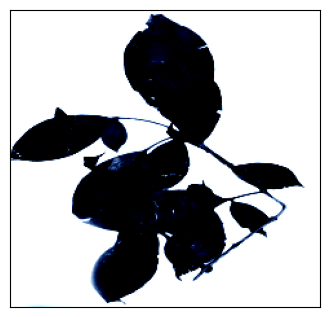

In [20]:
def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (4,5))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(train_dataset)


In [ ]:
foldername_to_class = {}
with open('/content/drive/MyDrive/Hebarium-Data-2019/Data/categories.txt', 'r') as file:
    for index, line in enumerate(file):
        if index == 0:
            continue
        else:
            data = line.split(',')
            foldername_to_class[str(int(data[0]))] = data[1].replace('\n', '')

print(foldername_to_class)



# creating a new dictionary
#my_dict ={"java":100, "python":112, "c":11}

 
# list out keys and values separately
key_list = list(foldername_to_class.keys())
val_list = list(foldername_to_class.values())
 
print(key_list)
print(val_list)
#print key with val 100
#position = val_list.index("Siphanthera cordata Pohl ex DC.")
print(key_list[val_list.index("Siphanthera cordata Pohl ex DC.")])
        

In [ ]:
# sort as value to fit the directory order to labels to be sure
print("Image to Folder Index", train_dataset.class_to_idx.items())
sorted_vals = dict(sorted(train_dataset.class_to_idx.items(), key=lambda item: item[1]))

categories = []
for key in sorted_vals:
    print(key)
    classname = foldername_to_class[key]
    categories.append(classname)

log.info(f"Categories {categories}")

In [25]:
# -------------------------------------------------------------------------------------------------------
# Initialise the data loaders
# -------------------------------------------------------------------------------------------------------

# ImageFile.LOAD_TRUNCATED_IMAGES = True # Use the data_checker.py and remove bad files instead of using this

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,  # IMPORTANT otherwise the data is not shuffled
    num_workers=workers,
    pin_memory=pin_memory,
    sampler=None,
)

test_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=workers,
    pin_memory=pin_memory,
)


In [ ]:
for images, labels in test_loader:
    pass

# Get one batch
images, labels = next(iter(test_loader))

In [24]:
print(len(val_dataset))

90


In [ ]:
# Run this to test your data loader
images, labels = next(iter(test_loader))
# helper.imshow(images[0], normalize=False)
plt.imshow(images[89].permute(1,2,0), cmap="gray")
plt.show()


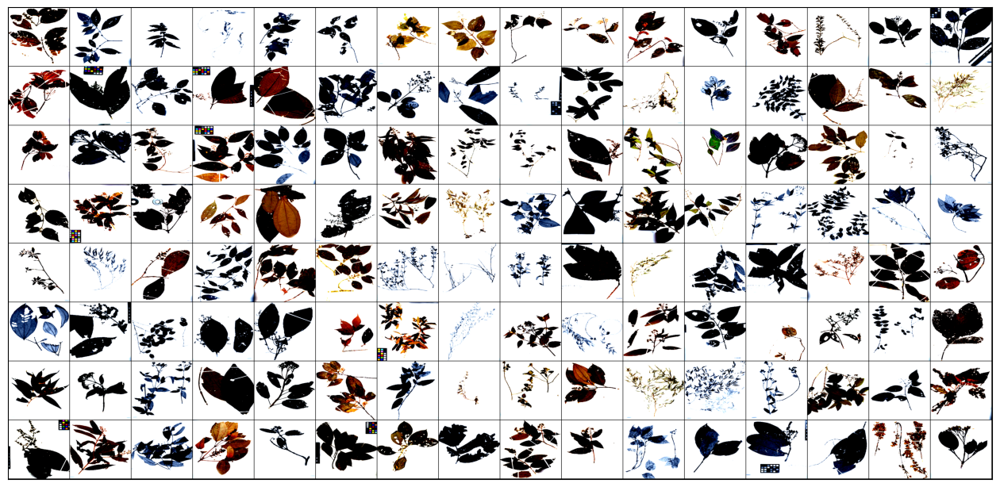

In [26]:
def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (16,20))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(train_loader)


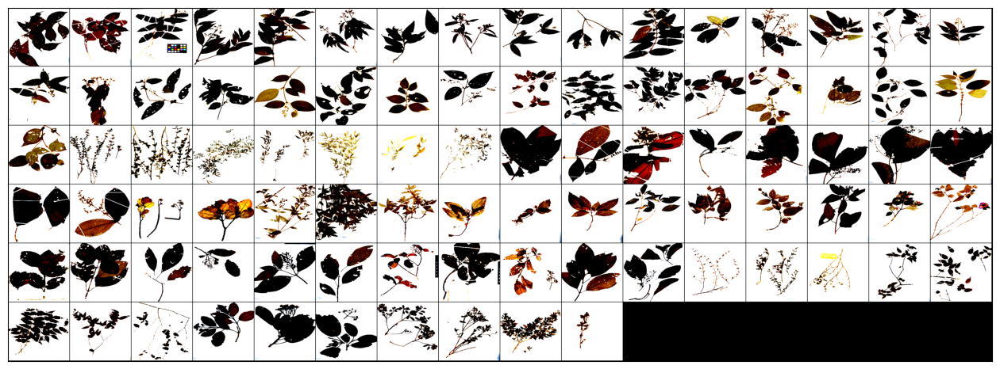

In [26]:
def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (16,20))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(test_loader)

In [ ]:
#I added this line for running the model:
model = torchvision.models.resnet50()
model.to(device)


In [17]:

# initialize our optimizer and loss function
opt = torch.optim.Adam(model.parameters(), lr=learning_rate)
lossFn = nn.CrossEntropyLoss()


## Train Model:

Training a CNN with ResNet involves several steps:

Prepare the dataset: This includes loading the images and labels, preprocessing the data (e.g. resizing, normalizing), and splitting the data into training and validation sets.

Load the ResNet model: This can be done using a library such as Keras or PyTorch, which provide pre-trained ResNet models that can be easily loaded and used for transfer learning.

Freeze the layers: Since ResNet is pre-trained on a large dataset, the initial layers of the model contain valuable features that can be used for the new task. So it's often a good idea to freeze the initial layers of the model and only train the last few layers, which are randomly initialized.

Compile the model: This step involves specifying the optimizer, loss function, and metrics that will be used to train the model.

Train the model: This involves passing the training data through the model, updating the model's parameters based on the loss function, and repeating this process for a number of epochs.

Validate the model: After training, the model is evaluated on a validation dataset to estimate its performance on unseen data.

Fine-tune the model: Based on the validation results, you can adjust the model's architecture, hyperparameters, or the data preprocessing steps to improve its performance.

Test the model: Finally, the model is evaluated on a test dataset to get a final estimate of its performance on unseen data.

It's important to note that training deep neural networks like ResNet can be computationally expensive and time-consuming. It's also important to have a good balance of dataset to avoid overfitting.

In [18]:

# -------------------------------------------------------------------------------------------------------
# Train the model
# -------------------------------------------------------------------------------------------------------

for images, labels in train_loader:
    log.info(f"Shape of X [N, C, H, W]: {images.shape}")
    log.info(f"Shape of y: {labels.shape} {labels.dtype}")
    # test one flow
    # pred = model(x)
    # loss = lossFn(pred, y)
    break
total_step = len(train_loader)
log.info(f"Total steps: {total_step}")

stepsize = total_step // 100
if stepsize < 10:
    stepsize = 10


In [21]:

# Write training matrics to Tensorboard
writer = SummaryWriter()

# loop over our epochs
for epoch in range(0, num_epochs):
    # set the model in training mode
    model.train()  # IMPORTANT otherwise the model is not in training mode
    # initialize the total training and validation loss
    totalTrainLoss = 0
    totalValLoss = 0
    # initialize the number of correct predictions in the training
    # and validation step
    trainAccuracy = 0
    totalTrainAccuracy = 0
    valCorrect = 0

    # loop over the training set
    for i, (images, labels) in enumerate(train_loader):

        try:
            # Train in auto-mode with 16 bit mode
            # with torch.autocast(device_type='cuda', dtype=torch.float16):
            # Train in normal mode
            with torch.autocast(device_type="cuda", dtype=torch.float32):
                # send the input to the device
                (images, labels) = (images.to(device), labels.to(device))
                # perform a forward pass and calculate the training loss
                outputs = model(images)
                # output is float16 because linear layers autocast to float16.
                # assert outputs.dtype is torch.float16 or 64

                loss = lossFn(outputs, labels)
                # zero out the gradients, perform the backpropagation step,
                # and update the weights
                writer.add_scalar("Loss/train", loss,  (epoch * total_step)+(i+1))
                opt.zero_grad()  # IMPORTANT otherwise the gradients of previous batches are not zeroed out
        except Exception as e:
            log.error(f"Exception in data processing- skip and continue = {e}")
        loss.backward()
        totalTrainLoss += loss
        opt.step()
        # Get the predicted values
        _, predicted = torch.max(outputs.data, 1)
        trainAccuracy = (predicted == labels).float().sum().item()
        trainAccuracy = 100 * trainAccuracy / labels.size(0)
        writer.add_scalar("Accuracy/train", trainAccuracy,(epoch * total_step)+(i+1))
        totalTrainAccuracy += trainAccuracy
        # if (i // stepsize) % 10 == 0:
        log.info(
            "Epoch [{}/{}], Step [{}/{}], Loss: {:.4f} Accuracy: {:.4f}".format(
                epoch + 1, num_epochs, i + 1, total_step, loss, trainAccuracy
            )
        )

    

    avgTrainLoss = totalTrainLoss / len(train_loader)
    avgAccuracy = totalTrainAccuracy / len(train_loader)
    log.info(
        "--->Epoch [{}/{}], Average Loss: {:.4f} Average Accuracy: {:.4f}".format(
            epoch + 1, num_epochs, avgTrainLoss, avgAccuracy
        )
    )

    print('Epoch [{}/{}], Loss: {:.4f}, TrainAccuracy: {:.4f} '.format(epoch+1, num_epochs, loss, trainAccuracy))

    # End Epoch loop
writer.flush()



Epoch [1/20], Loss: 2.4437, TrainAccuracy: 33.3333 
Epoch [2/20], Loss: 2.3005, TrainAccuracy: 33.3333 
Epoch [3/20], Loss: 3.7530, TrainAccuracy: 0.0000 
Epoch [4/20], Loss: 3.9024, TrainAccuracy: 0.0000 
Epoch [5/20], Loss: 2.4923, TrainAccuracy: 33.3333 
Epoch [6/20], Loss: 2.1139, TrainAccuracy: 33.3333 
Epoch [7/20], Loss: 2.4866, TrainAccuracy: 66.6667 
Epoch [8/20], Loss: 1.4403, TrainAccuracy: 33.3333 
Epoch [9/20], Loss: 2.6836, TrainAccuracy: 33.3333 
Epoch [10/20], Loss: 0.5946, TrainAccuracy: 100.0000 
Epoch [11/20], Loss: 2.1600, TrainAccuracy: 33.3333 
Epoch [12/20], Loss: 3.2960, TrainAccuracy: 33.3333 
Epoch [13/20], Loss: 2.9913, TrainAccuracy: 33.3333 
Epoch [14/20], Loss: 2.0554, TrainAccuracy: 66.6667 
Epoch [15/20], Loss: 1.3661, TrainAccuracy: 66.6667 
Epoch [16/20], Loss: 2.4784, TrainAccuracy: 0.0000 
Epoch [17/20], Loss: 3.1428, TrainAccuracy: 33.3333 
Epoch [18/20], Loss: 4.2243, TrainAccuracy: 0.0000 
Epoch [19/20], Loss: 0.8370, TrainAccuracy: 66.6667 
Epoch

In [ ]:
print(test_loader.__len__)
print(len(test_loader))
print(type(test_loader))



<bound method DataLoader.__len__ of <torch.utils.data.dataloader.DataLoader object at 0x7f4980219370>>
2
<class 'torch.utils.data.dataloader.DataLoader'>


In [ ]:

print(val_dataset)
print(len(val_dataset))
print(type(val_dataset))

Dataset ImageFolder
    Number of datapoints: 90
    Root location: /content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation
    StandardTransform
Transform: Compose(
               Resize(size=(277, 277), interpolation=bilinear, max_size=None, antialias=warn)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )
90
<class 'torchvision.datasets.folder.ImageFolder'>


In [ ]:
print(val_dataset.__len__)

<bound method DatasetFolder.__len__ of Dataset ImageFolder
    Number of datapoints: 90
    Root location: /content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation
    StandardTransform
Transform: Compose(
               Resize(size=(277, 277), interpolation=bilinear, max_size=None, antialias=warn)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )>


In [ ]:
examples = next(iter(train_loader))

for label, img  in enumerate(examples):
   plt.imshow(img.permute(1,2,0))
   plt.show()
   print(f"Label: {label}")
images, labels = next(iter(test_loader))


   plt.imshow(img.permute(1,2,0))
   plt.show()
   print(f"Label: {label}")


if categories[y] != foldername_to_class[filename]:

0


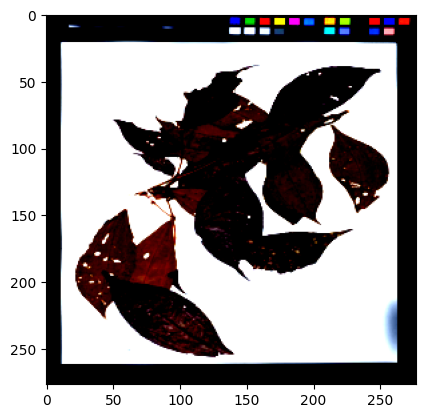

0


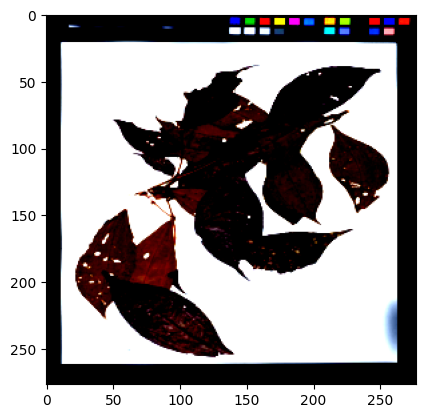

Label: 0
Accuracy of the network on the 19 validation images: 32.22222222222222 %
tensor([ 0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  2,  2,  2,  2,  2,  2,  3,  3,  4,  4,  4,  4,  5,  5,  6,  6,  7,
         7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9, 10, 10,
        10, 11, 11, 11, 11, 11, 12, 12, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 19, 19],
       device='cuda:0')
tensor([ 2,  3,  1,  1,  1,  1,  8, 18, 12,  1, 12,  1, 12,  5,  3,  1, 12,  1,
         1, 12,  5,  1,  1, 12,  2,  1,  1,  1,  5,  1,  2, 14,  5, 18, 15, 15,
        15, 15, 15, 15,  8,  8,  8, 14,  8,  8,  8,  8,  8,  8,  1, 14, 10,  1,
         1,  3,  3,  3,  1,  1,  1,  1,  1,  1,  8, 12,  5,  1,  8, 14, 14, 14,
        14,  8, 12, 15,  7, 15, 12,  1, 16, 16, 10, 12,  8, 12, 15, 10, 16, 15],
       device='cuda:0')


In [ ]:
with torch.no_grad():
    correct = 0
    total = 0
    for i, (images, labels) in enumerate(test_loader):
        print(i)
        plt.imshow(images[i].permute(1,2,0).cpu())
        plt.show()
        images, labels = next(iter(test_loader))
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    for i in enumerate(test_loader):    
    if labels[i] != predicted[i]:
          print("0")
          plt.imshow(images[i].permute(1,2,0).cpu())
          plt.show()
          print(f"Label: {label}")

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    # if labels[i]=!predicted[i]:
    #   print(*)
    print(labels)
    print(predicted)
  

In [22]:
#with Border
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        
        

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    # if labels[i]=!predicted[i]:
    #   print(*)
    print(labels)
    print(predicted)
  

Accuracy of the network on the 19 validation images: 22.22222222222222 %
tensor([ 0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  2,  2,  2,  2,  2,  2,  3,  3,  4,  4,  4,  4,  5,  5,  6,  6,  7,
         7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9, 10, 10,
        10, 11, 11, 11, 11, 11, 12, 12, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 19, 19],
       device='cuda:0')
tensor([ 1,  1,  2,  1,  1,  2,  2, 16,  2, 14,  1,  2, 14,  2,  2, 14, 14,  1,
        14,  1, 14,  1,  2, 14,  2,  1,  1,  2,  2, 14,  2, 14, 11, 15, 15, 14,
        14, 14, 14, 14,  8, 11, 14,  8,  8,  8,  8,  8,  8, 14, 14, 14, 10,  2,
        10, 17,  1,  8, 14, 14, 14,  2, 14, 14,  8, 14,  2, 14,  1,  2,  1,  1,
        11, 14, 14, 15, 14, 14, 15, 14, 14, 11, 14, 14,  8,  8, 14, 14, 14, 11],
       device='cuda:0')


In [27]:
#withou Border
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        
        

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    # if labels[i]=!predicted[i]:
    #   print(*)
    print(labels)
    print(predicted)
  

Accuracy of the network on the 19 validation images: 46.666666666666664 %
tensor([ 0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  2,  2,  2,  2,  2,  2,  3,  3,  4,  4,  4,  4,  5,  5,  6,  6,  7,
         7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9, 10, 10,
        10, 11, 11, 11, 11, 11, 12, 12, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 19, 19],
       device='cuda:0')
tensor([ 2, 11,  1,  1,  2, 17,  1, 16,  2,  2,  1,  4,  1,  2,  1,  1,  2,  1,
         2,  2, 14,  2,  2, 14, 11,  1,  1,  2,  4,  4,  2,  2,  4, 15, 15,  6,
         6,  4,  4,  4,  8,  1,  8, 17,  8,  8,  8,  8,  8,  8, 14, 14, 10,  1,
        11, 11, 11, 11,  1, 11,  4,  2,  2,  4,  8, 14, 14, 17, 14, 14, 14, 14,
        14, 14, 14,  6, 15,  4, 16, 16,  1, 16, 16, 14,  8, 17, 18, 10, 14, 10],
       device='cuda:0')


## Test and Analyse the Model

Testing a CNN model with ResNet50 would involve using a dataset of images that the model has not seen during training. The goal of testing is to evaluate the model's performance on unseen data and to estimate its generalization error.

To test a CNN model with ResNet50, you would first need to load the pre-trained weights of the model. This can be done using a library such as PyTorch, which provide pre-trained ResNet50 models that can be easily loaded and used for testing.

Once the model is loaded, you would need to prepare your test dataset by preprocessing the images (e.g. resizing, normalizing) and labels in the same way as the training dataset. Then, you can use the model to make predictions on the test dataset by passing the images through the model and comparing the model's predictions to the true labels.


In [28]:
# Save the model
#/content/drive/MyDrive/Herbarium Data-2019/SavedModel
modelname ="resnet50"
path = "/content/drive/MyDrive/Hebarium-Data-2019/SavedModel"
model_save_name = path + modelname + datetime.now().strftime("%H:%M_%B%d%Y")
torch.save(model.state_dict(), model_save_name + ".pth")
log.info(f"Model {modelname} saved as {model_save_name}")


# Analyse Model:

A confusion matrix is a table that is often used to evaluate the performance of a classifier, such as a CNN. The matrix is used to compare the predicted class labels with the true class labels of the test set. The rows of the matrix represent the true class labels, while the columns represent the predicted class labels.


The confusion matrix allows you to see which classes the model is confused between, and can give you a better understanding of the performance of your model. From the matrix, you can also calculate some performance metrics such as accuracy, precision, recall, and F1-score.

We use a confusion matrix to evaluate the model's performance. It shows the number of times each class was predicted as another class, and provides a visual representation of the model's accuracy and errors.

## Confusion Matrix for training Data:

In [ ]:
# Generate the Confusion Matrix

print('Training Analyse:')
print('\n')


confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)


        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

    # print("Confusion Matrix1=\n",confusion_matrix)
    # ------------------------------------------------------------------------------------------
    # Print Confusion matrix in Pretty print format
    # ------------------------------------------------------------------------------------------
    #print(categories)
    for i in range(len(categories)):
        for j in range(len(categories)):
            print(f"\t{confusion_matrix[i][j]}", end="")
        print(f"\t{categories[i]}\n", end="")
    # ------------------------------------------------------------------------------------------
    # Calculate Accuracy per class
    # ------------------------------------------------------------------------------------------
    print("---------------------------------------")
    print(
        f"Accuracy/precision from confusion matrix from training is {round(confusion_matrix.trace()/confusion_matrix.sum(),2)}"
    )
    print("---------------------------------------")
    for i in range(len(categories)):
        print(
            f"---Accuracy for class {categories[i]} = {round(confusion_matrix[i][i]/confusion_matrix[i].sum(),2)}"
        )
print('\n')
print('\n')

print('Testing Analyse:')
print('\n')





# Generate the Confusion Matrix

confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

    # print("Confusion Matrix1=\n",confusion_matrix)
    # ------------------------------------------------------------------------------------------
    # Print Confusion matrix in Pretty print format
    # ------------------------------------------------------------------------------------------
    #print(categories)
    for i in range(len(categories)):
        for j in range(len(categories)):
            print(f"\t{confusion_matrix[i][j]}", end="")
        print(f"\t{categories[i]}\n", end="")
    # ------------------------------------------------------------------------------------------
    # Calculate Accuracy per class
    # ------------------------------------------------------------------------------------------
    print("---------------------------------------")
    print(
        f"Accuracy/precision from confusion matrix for testing is {round(confusion_matrix.trace()/confusion_matrix.sum(),2)}"
    )
    print("---------------------------------------")
    for i in range(len(categories)):
        print(
            f"---Accuracy for class {categories[i]} = {round(confusion_matrix[i][i]/confusion_matrix[i].sum(),2)}"
        )


Training Analyse:


	3.0	6.0	7.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	1.0	Miconia approximata Gamba & Almeda
	0.0	221.0	7.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	0.0	1.0	1.0	2.0	2.0	0.0	3.0	0.0	0.0	1.0	Miconia ibaguensis (Bonpl.) Triana
	0.0	24.0	46.0	0.0	4.0	0.0	0.0	0.0	0.0	2.0	0.0	1.0	3.0	1.0	0.0	0.0	1.0	0.0	0.0	0.0	Clidemia bullosa DC.
	0.0	3.0	0.0	12.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	Mouriri sagotiana Triana
	0.0	1.0	14.0	0.0	25.0	0.0	0.0	0.0	0.0	3.0	0.0	1.0	1.0	0.0	2.0	0.0	0.0	0.0	0.0	0.0	Blakea henripittieri (Cogn.) Penneys & Almeda
	0.0	0.0	7.0	0.0	4.0	1.0	0.0	0.0	0.0	0.0	0.0	3.0	2.0	1.0	1.0	0.0	0.0	0.0	0.0	3.0	Clidemia debilis Crueg.
	0.0	0.0	0.0	0.0	0.0	0.0	10.0	1.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	10.0	0.0	0.0	0.0	0.0	Comolia veronicaefolia Benth.
	0.0	0.0	0.0	0.0	0.0	0.0	0.0	70.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	1.0	Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
	0.0	16.0	3.0	0.0	0.0	0.0	0.0	0.0	111.0	0.0	0.0	0.0	

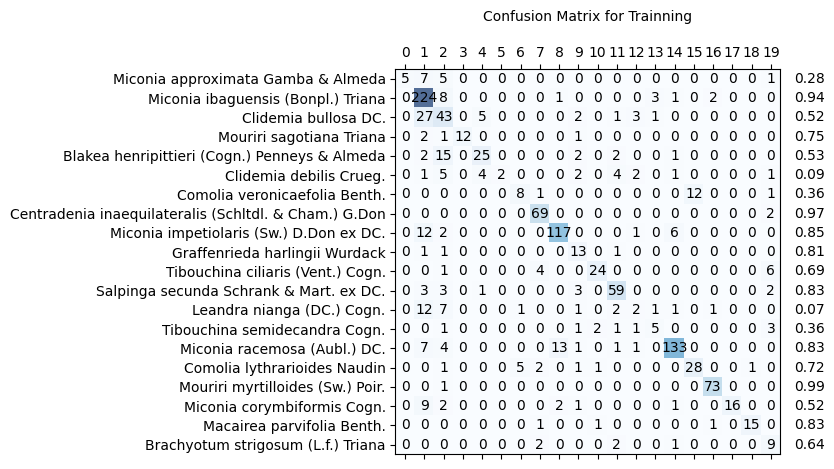

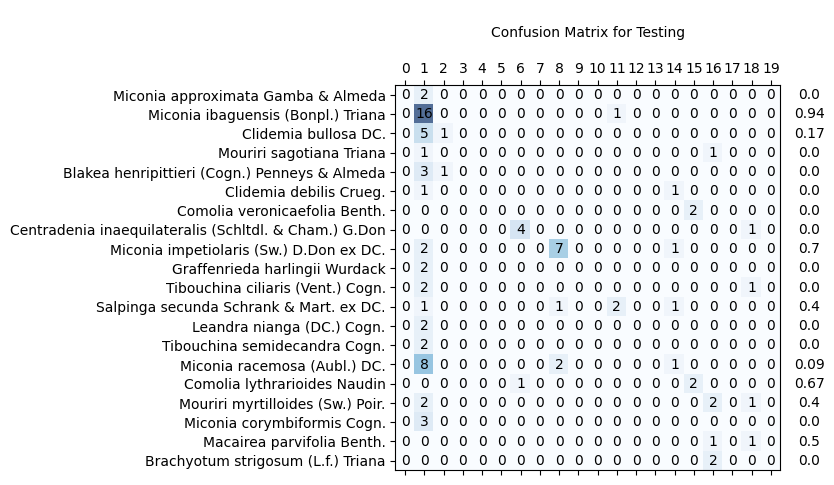

In [ ]:
# Generate the Confusion Matrix

confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1


    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(111)
    plt.title("Confusion Matrix for Trainning\n", fontsize=10)
    ax.matshow(confusion_matrix, cmap=plt.cm.Blues, alpha=0.7)
    #ax.set_xticklabels([""] + categories, rotation=90)
    ax.set_yticklabels([""] + categories)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))
    for i in range(confusion_matrix.shape[0]):
        for j in range(confusion_matrix.shape[1]):
            ax.text(
                x=j,
                y=i,
                s=int(confusion_matrix[i, j]),
                va="center",
                ha="center",
                size="medium",
            )
            if i == j:
                acc = round(confusion_matrix[i][i] / confusion_matrix[i].sum(), 2)
                ax.text(
                    x=len(categories) + 1,
                    y=i,
                    s=acc,
                    va="center",
                    ha="center",
                    size="medium",
                )
    plt.savefig(model_save_name + "_cm.jpg")


# Generate the Confusion Matrix





confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

  
    
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(111)
    plt.title("\nConfusion Matrix for Testing\n", fontsize=10)
    ax.matshow(confusion_matrix, cmap=plt.cm.Blues, alpha=0.7)
    #ax.set_xticklabels([""] + categories, rotation=90)
    ax.set_yticklabels([""] + categories)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))
    for i in range(confusion_matrix.shape[0]):
        for j in range(confusion_matrix.shape[1]):
            ax.text(
                x=j,
                y=i,
                s=int(confusion_matrix[i, j]),
                va="center",
                ha="center",
                size="medium",
            )
            if i == j:
                acc = round(confusion_matrix[i][i] / confusion_matrix[i].sum(), 2)
                ax.text(
                    x=len(categories) + 1,
                    y=i,
                    s=acc,
                    va="center",
                    ha="center",
                    size="medium",
                )          
    plt.savefig(model_save_name + "_cm.jpg")





## Predict a score for each class label

In this process, a set of images is used to evaluate the performance of a pre-trained CNN model. The model uses its learned features to analyze each image and predict the class label that it believes the image belongs to. For each image, the model generates a score for each class label, indicating the likelihood that the image belongs to that class. The class label with the highest score is considered the model's prediction for that image. Additionally, the class label with the lowest score can give an insight into the classes that the model is certain the image does not belong to.

For example, if the model is trained to recognize different types of animals, and it is given an image of a dog, the model will generate scores for different class labels such as "dog", "cat", "horse", "bird", etc. The class label "dog" might have the highest score (e.g. 0.95) indicating that the model is very confident that the image is of a dog. The class label "cat" might have a lower score (e.g. 0.05) indicating that the model is certain that the image is not of a cat.

This scoreboard of predictions along with the technique called GradCAM (Gradient-weighted Class Activation Mapping) can help us understand how the model arrived at its predictions. GradCAM is a technique that allows us to visualize which parts of an image the model is focusing on when making its predictions. For example, if the model is given an image of a dog, the GradCAM visualization might show that the model is focusing on the eyes, ears and nose of the dog, which are known to be key features for identifying dogs.


By analyzing the predictions, scores and GradCAM, we can evaluate the model's performance, identify potential areas for improvement, and gain a better understanding of how the model interprets images and makes predictions.






In [29]:
model = model.eval()

In [30]:
#without Border
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    print(labels)
    print(predicted)

Accuracy of the network on the 19 validation images: 26.666666666666668 %
tensor([ 0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  2,  2,  2,  2,  2,  2,  3,  3,  4,  4,  4,  4,  5,  5,  6,  6,  7,
         7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9, 10, 10,
        10, 11, 11, 11, 11, 11, 12, 12, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 19, 19],
       device='cuda:0')
tensor([ 2,  2,  1,  1,  1,  1,  2, 16,  1,  2,  1,  2,  1,  2,  1,  2,  2,  2,
         2,  1,  2,  2,  2,  2,  2,  1,  1,  2,  2,  2,  2,  2,  2, 15, 15,  6,
        15,  6,  6,  6,  1,  1,  2,  2,  2,  1,  1,  1,  1,  2, 14,  2, 10,  1,
        11, 11, 11, 11,  2,  2,  2,  2,  2,  2,  1,  2,  2,  2,  1,  2,  1,  1,
         2, 14, 14,  6, 15,  6,  1, 16,  1,  1, 16,  2,  1,  1, 18, 18, 14, 10],
       device='cuda:0')


In [ ]:

#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/lustre/SEAS/plessgrp/MaryamDarei/Herbarium2019/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/lustre/SEAS/plessgrp/MaryamDarei/Herbarium2019/validation/'+filename)
  for img_file in img_files:
    
    input_image = Image.open('/lustre/SEAS/plessgrp/MaryamDarei/Herbarium2019/validation/'+filename+"/"+img_file)
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
           
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      input_batch = input_batch.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(input_batch)
    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    # print(probabilities)
    x , y = torch.topk(probabilities, 1) 
    #print(categories[y])
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    #print(f"Detecting for class {img_file + foldername_to_class[str(filename)} +  model {modelname}")
    print("--")
    # Show top categories per image
    top5_prob, top5_catid = torch.topk(probabilities, 10)
    #top1_prob, top1_catid = torch.topk(probabilities, )
    #print(categories[top1_catid[i]])
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())
    print("--------------------------------")

real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
--
Clidemia bullosa DC. 0.8758049607276917
Miconia approximata Gamba & Almeda 0.05122645944356918
Miconia ibaguensis (Bonpl.) Triana 0.0402708575129509
Mouriri sagotiana Triana 0.021793680265545845
Miconia racemosa (Aubl.) DC. 0.00462527759373188
Miconia corymbiformis Cogn. 0.002420950448140502
Miconia impetiolaris (Sw.) D.Don ex DC. 0.0014755893498659134
Leandra nianga (DC.) Cogn. 0.0014503231504932046
Blakea henripittieri (Cogn.) Penneys & Almeda 0.0002948270121123642
Salpinga secunda Schrank & Mart. ex DC. 0.0002662139304447919
--------------------------------
real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
--
Clidemia bullosa DC. 0.5958683490753174
Miconia ibaguensis (Bonpl.) Triana 0.34086549282073975
Mouriri sagotiana Triana 0.03164594992995262
Miconia approximata Gamba & Alm

**Utility to check Precision and Recall of a  trained model Author - Alex Punnen**

## Analyse Model:
***Model Explain-ability GradCam***
Gradcam helps one visualize which parts of the images are important for the CNN when it classifies an object with high probability. After testing a model, you can use this to visualize and debug the test results.



Gradient-weighted Class Activation Mapping (***Grad-CAM***) is a technique for visualizing the regions in an image that are most important for a given classification decision made by a Convolutional Neural Network (CNN). Grad-CAM uses the gradients of the final convolutional layer of a CNN to generate a heatmap, which highlights the regions of the input image that have the strongest influence on the classification decision, however I use the gradients of all convolutional layer of a ResNet to generate a heatmap.

One of the key advantages of Grad-CAM is that it can be applied to any CNN architecture, regardless of the number of layers or the specific architecture used. Additionally, Grad-CAM can be used to generate visual explanations for any class in the dataset, rather than just the top-scoring class.

In summary, Grad-CAM is a technique that can be used to understand the internal workings of a CNN by visualizing the regions of an image that are most important for a given classification decision. It works by using the gradients of the final convolutional layer to generate a heatmap, which highlights the regions of the input image that have the strongest influence on the classification decision.


In [31]:

def flatten_model(modules):
    def flatten_list(_2d_list):
        flat_list = []
        # Iterate through the outer list
        for element in _2d_list:
            if type(element) is list:
                # If the element is of type list, iterate through the sublist
                for item in element:
                    flat_list.append(item)
            else:
                flat_list.append(element)
        return flat_list

    ret = []
    try:
        for _, n in modules:
            ret.append(loopthrough(n))
    except:
        try:
            if str(modules._modules.items()) == "odict_items([])":
                ret.append(modules)
            else:
                for _, n in modules._modules.items():
                    ret.append(loopthrough(n))
        except:
            ret.append(modules)
    return flatten_list(ret)

## Set the target for the CAM layer:

To generate a Class Activation Map (CAM), you typically use the output of the last fully connected layer of your model as the input to the CAM layer. This output represents the class scores for the input image, and the CAM layer generates a heatmap highlighting the regions of the image that are most important for the model's classification decision.

However, when we use a pre-trained model such as ResNet50, the architecture is more complex and has multiple layers. In this case, to create a Grad-CAM, which is a variant of CAM, we add all the ResNet50 layers to the model, including convolutional and pooling layers, in order to compute the gradients of the last convolutional layer with respect to the output of the fully connected layer. Then, the gradients are used to weight the feature maps from the last convolutional layer and generate the CAM heatmap.


In [ ]:
# Set the target for the CAM layer; Add all the layers in the model
target_layers =[]
module_list =[module for module in model.modules()]


flatted_list= flatten_model(module_list)


print("------------------------")
for count, value in enumerate(flatted_list):
    
    if isinstance(value, (nn.Conv2d,nn.AvgPool2d,nn.BatchNorm2d)):
    #if isinstance(value, (nn.Conv2d)):
        print(count, value)
        target_layers.append(value)

print("------------------------")


In [33]:
# Alternative is to add specific layers and check
# if modelname=='resnet50':
#     #target_layers = [module_list[142],module_list[143],module_list[144],module_list[145],module_list[146],module_list[147]]
#     target_layers = [module_list[35],module_list[36],module_list[37],module_list[38],module_list[39],module_list[40]]
# if modelname=='mycnn':
#     target_layers = [module_list[11],module_list[8],module_list[5],module_list[2],module_list[4],module_list[7],module_list[10],module_list[13]] # CNN and Avg pooling
#     #target_layers = [module_list[11],module_list[8],module_list[5],module_list[2]] # CNN only
    
# Construct the CAM object once, and then re-use it on many images:
cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)
gradvariantname = "GradCAM_"



In [ ]:
# Run this to test your data loader
images, labels = next(iter(test_loader))
# helper.imshow(images[0], normalize=False)
plt.imshow(images[0].permute(1,2,0), cmap="gray")
plt.show()
#print(images)

In [ ]:
img_normalized = transform_norm(img)
 
# convert this image to numpy array
img_normalized = np.array(img_normalized)
 
# transpose from shape of (3,,) to shape of (,,3)
img_normalized = img_normalized.transpose(1, 2, 0)
 
# display the normalized image
plt.imshow(img_normalized)
plt.xticks([])
plt.yticks([])

In [ ]:
input_tensor = preprocess(input_image)
    #input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).numpy().astype(np.float32)

    #input_batch = input_batch[0].transpose((1,2,0))


    input_batch2 = torch.from_numpy(input_batch)
    
    input_batch3 = input_batch2.numpy()
    
    fgsm_attack = FastGradientMethod(estimator = classifier, eps=0.9) 

    x_test_adv = fgsm_attack.generate(x=input_batch3)
    x_test_adv2 = torch.from_numpy(x_test_adv)
    x_test_adv3 = x_test_adv.squeeze(0)



real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7590644359588623
Clidemia bullosa DC. 0.17452454566955566
--------------------------------


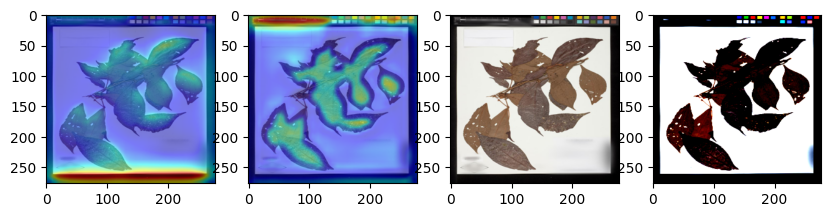

real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7062951326370239
Clidemia bullosa DC. 0.18342672288417816
--------------------------------


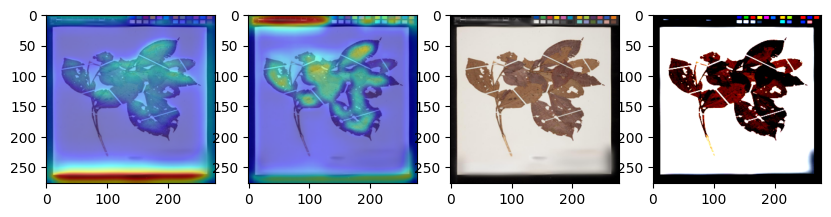

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7967761158943176
Clidemia bullosa DC. 0.1412343531847
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7838425040245056
Mouriri myrtilloides (Sw.) Poir. 0.07641401141881943
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.866009533405304
Clidemia bullosa DC. 0.05672091618180275
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.41100239

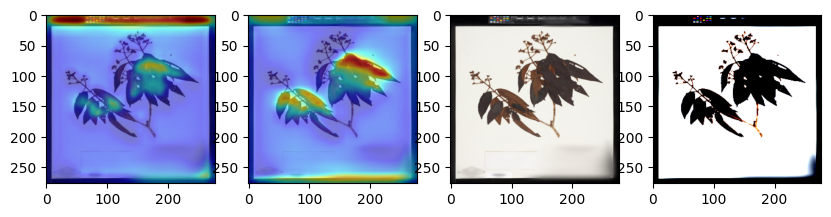

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.41671159863471985
Miconia racemosa (Aubl.) DC. 0.27900224924087524
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00005.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9543876051902771
Macairea parvifolia Benth. 0.023117301985621452
--------------------------------


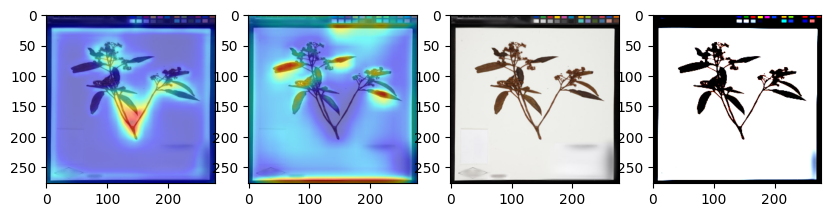

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8606638312339783
Clidemia bullosa DC. 0.08449605107307434
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6158994436264038
Miconia ibaguensis (Bonpl.) Triana 0.10197368264198303
--------------------------------


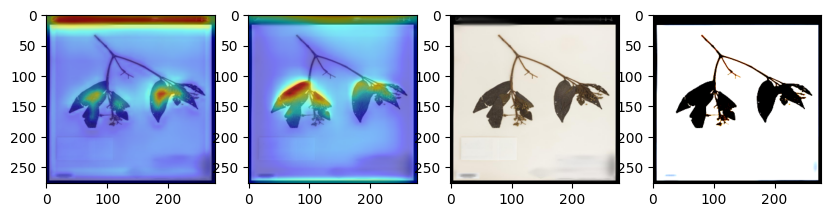

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.9004324674606323
Leandra nianga (DC.) Cogn. 0.027906985953450203
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00009.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4807714521884918
Mouriri myrtilloides (Sw.) Poir. 0.14860914647579193
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00010.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4290861189365387
Miconia racemosa (Aubl.) DC. 0.14503563940525055
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00011.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibagu

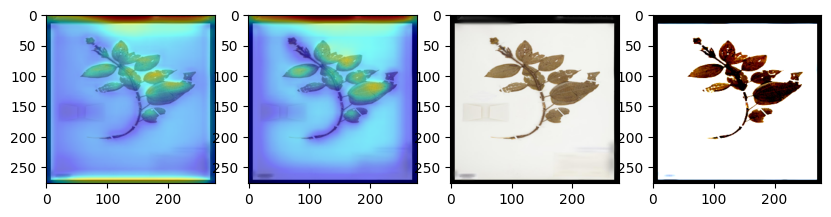

real class name:  Leandra nianga (DC.) Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.709618330001831
Leandra nianga (DC.) Cogn. 0.0713852047920227
--------------------------------


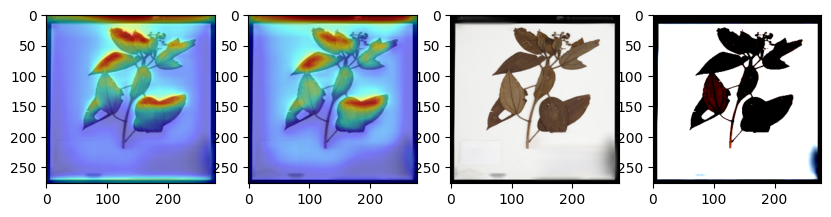

real class name:  Tibouchina semidecandra Cogn.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.24835675954818726
Miconia ibaguensis (Bonpl.) Triana 0.244527205824852
--------------------------------


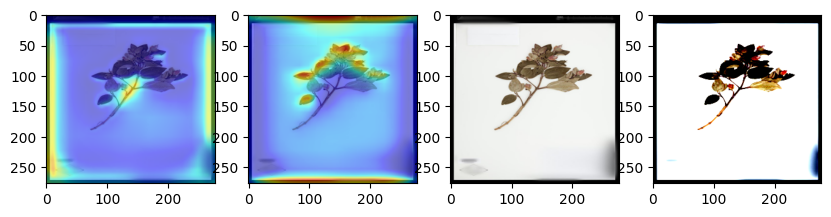

real class name:  Tibouchina semidecandra Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3348510265350342
Miconia ibaguensis (Bonpl.) Triana 0.24084767699241638
--------------------------------


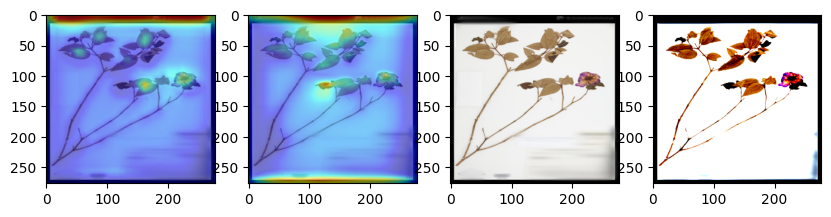

real class name:  Miconia racemosa (Aubl.) DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6606959104537964
Leandra nianga (DC.) Cogn. 0.09517065435647964
--------------------------------


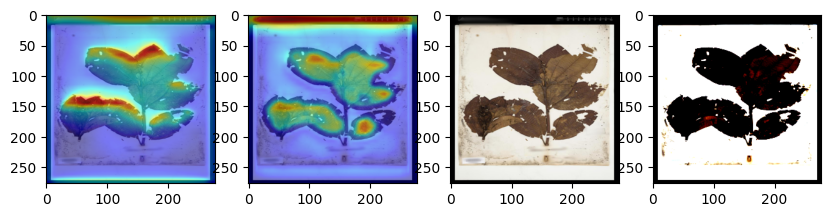

real class name:  Miconia racemosa (Aubl.) DC.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6754350066184998
Miconia racemosa (Aubl.) DC. 0.1262473315000534
--------------------------------


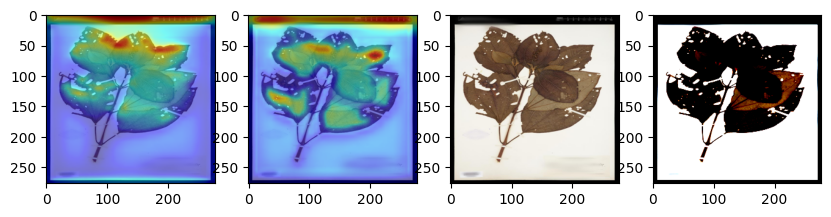

real class name:  Miconia racemosa (Aubl.) DC.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7507671117782593
Clidemia bullosa DC. 0.11417221277952194
--------------------------------


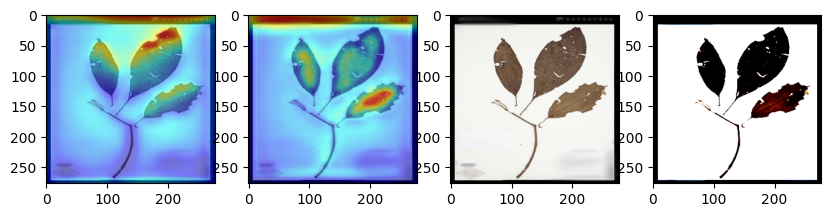

real class name:  Miconia racemosa (Aubl.) DC.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.372485488653183
Mouriri myrtilloides (Sw.) Poir. 0.33543089032173157
--------------------------------


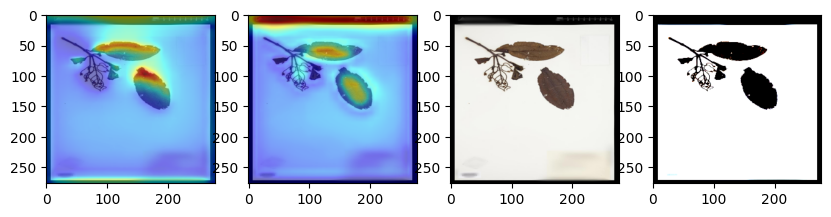

real class name:  Miconia racemosa (Aubl.) DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7295832633972168
Clidemia bullosa DC. 0.09227551519870758
--------------------------------


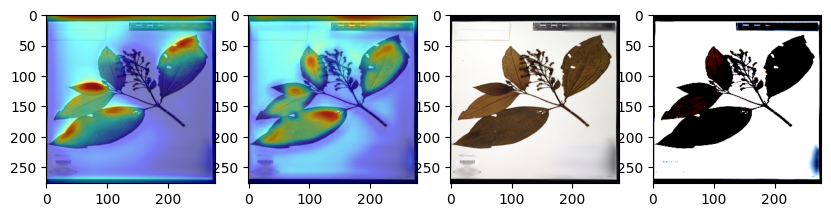

real class name:  Miconia racemosa (Aubl.) DC.
image 00005.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5882570147514343
Clidemia bullosa DC. 0.2577889859676361
--------------------------------


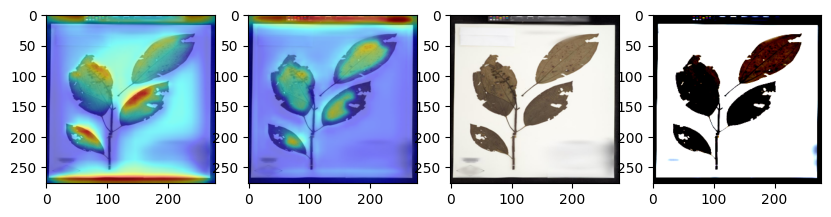

real class name:  Miconia racemosa (Aubl.) DC.
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.770775318145752
Leandra nianga (DC.) Cogn. 0.10716662555932999
--------------------------------


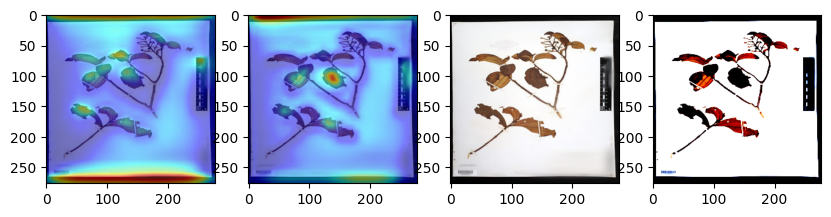

real class name:  Miconia racemosa (Aubl.) DC.
image 00007.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7878488302230835
Leandra nianga (DC.) Cogn. 0.08806981146335602
--------------------------------


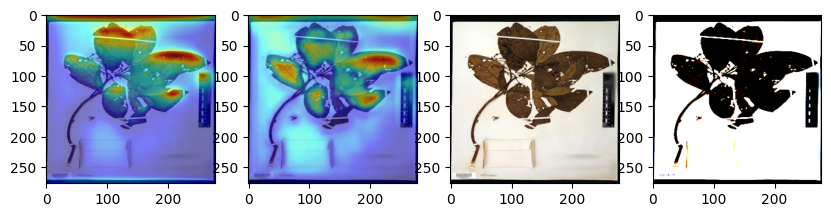

real class name:  Miconia racemosa (Aubl.) DC.
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3811430335044861
Miconia racemosa (Aubl.) DC. 0.25967133045196533
--------------------------------


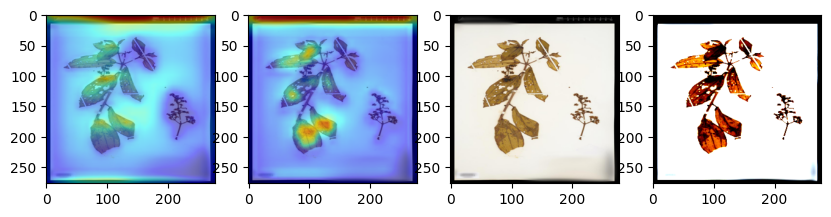

real class name:  Miconia racemosa (Aubl.) DC.
image 00009.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.42747992277145386
Miconia racemosa (Aubl.) DC. 0.34281304478645325
--------------------------------


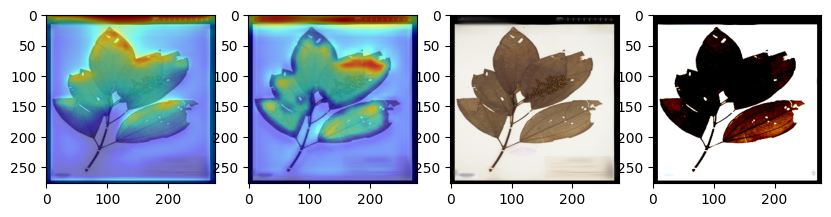

real class name:  Miconia racemosa (Aubl.) DC.
image 00010.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7112933993339539
Leandra nianga (DC.) Cogn. 0.12391170859336853
--------------------------------


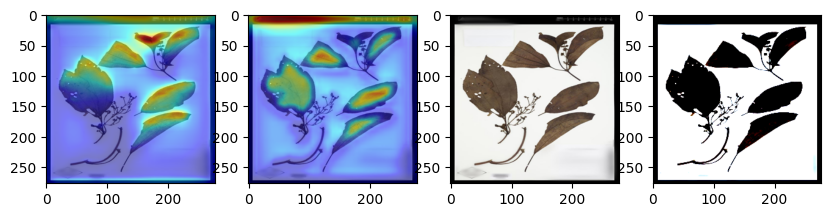

real class name:  Comolia lythrarioides Naudin
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.3424128592014313
Miconia ibaguensis (Bonpl.) Triana 0.20401644706726074
--------------------------------


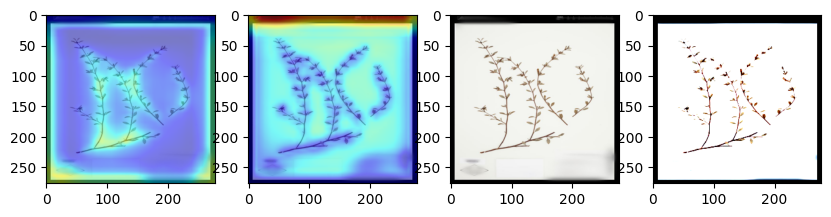

real class name:  Comolia lythrarioides Naudin
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.4784921705722809
Mouriri myrtilloides (Sw.) Poir. 0.14831805229187012
--------------------------------


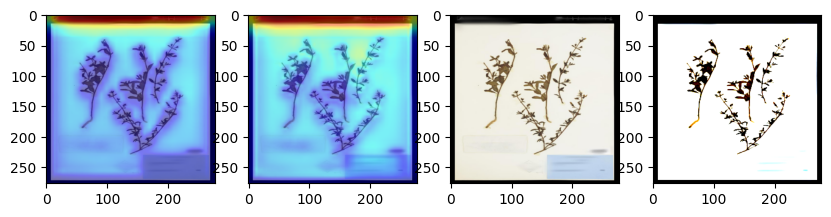

real class name:  Comolia lythrarioides Naudin
image 00002.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.3054909408092499
Miconia ibaguensis (Bonpl.) Triana 0.1807427853345871
--------------------------------


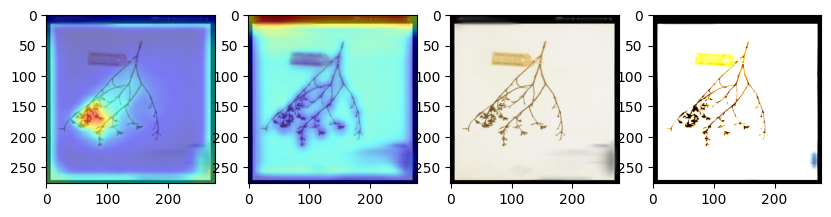

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.7293523550033569
Miconia ibaguensis (Bonpl.) Triana 0.1986933797597885
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9615738987922668
Miconia ibaguensis (Bonpl.) Triana 0.02650509960949421
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.39429059624671936
Mouriri myrtilloides (Sw.) Poir. 0.3056608736515045
--------------------------------


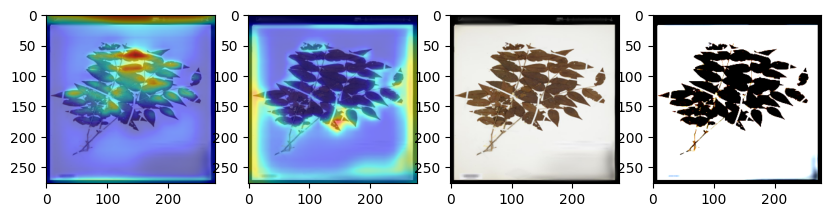

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3757026791572571
Mouriri myrtilloides (Sw.) Poir. 0.3016342222690582
--------------------------------


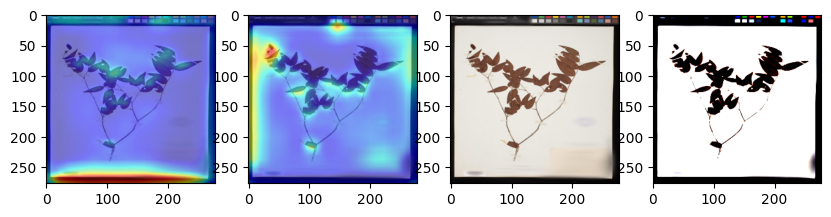

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00004.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9699406027793884
Macairea parvifolia Benth. 0.011356431059539318
--------------------------------
real class name:  Miconia corymbiformis Cogn.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4309023916721344
Miconia racemosa (Aubl.) DC. 0.2482387125492096
--------------------------------


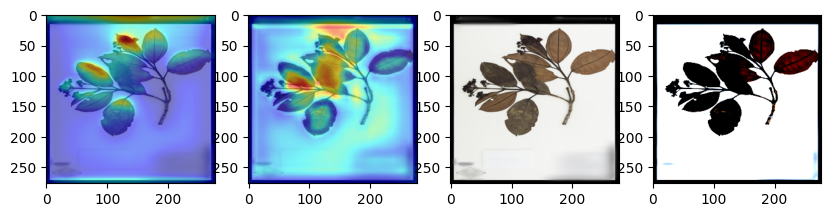

real class name:  Miconia corymbiformis Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6154614686965942
Leandra nianga (DC.) Cogn. 0.12437139451503754
--------------------------------


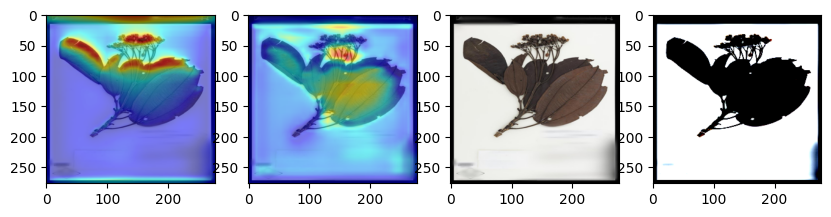

real class name:  Miconia corymbiformis Cogn.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3270881474018097
Miconia racemosa (Aubl.) DC. 0.291456401348114
--------------------------------


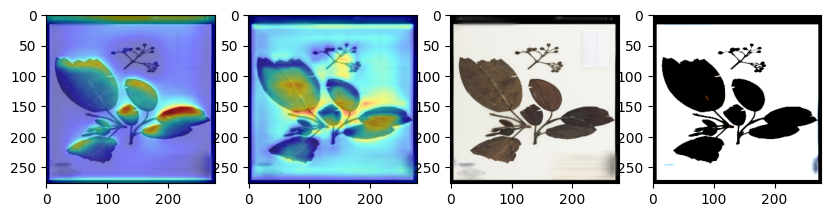

real class name:  Macairea parvifolia Benth.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.39339178800582886
Miconia racemosa (Aubl.) DC. 0.22627224028110504
--------------------------------


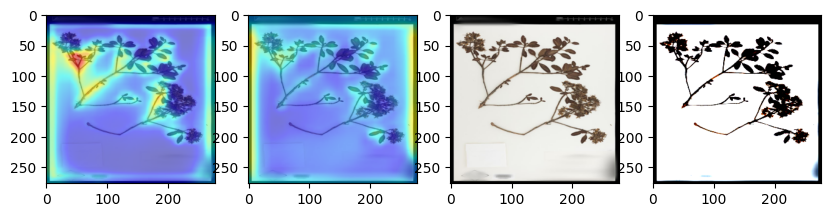

real class name:  Macairea parvifolia Benth.
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.30939966440200806
Miconia racemosa (Aubl.) DC. 0.22611233592033386
--------------------------------


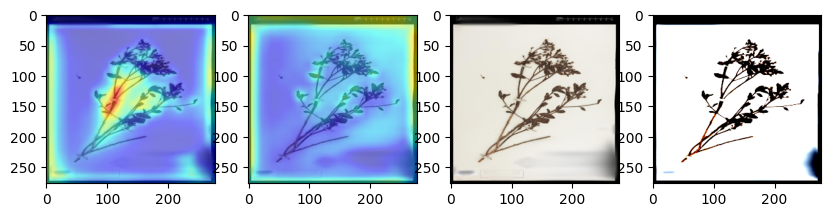

real class name:  Brachyotum strigosum (L.f.) Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.513573169708252
Miconia ibaguensis (Bonpl.) Triana 0.13772061467170715
--------------------------------


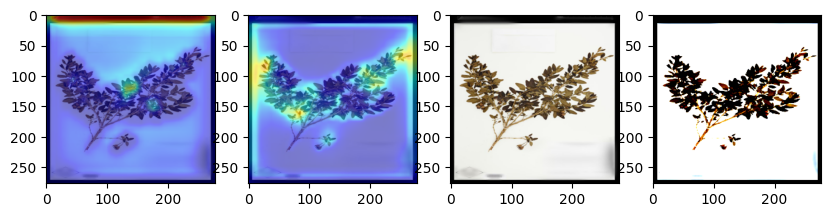

real class name:  Brachyotum strigosum (L.f.) Triana
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.3064998984336853
Miconia ibaguensis (Bonpl.) Triana 0.21576637029647827
--------------------------------


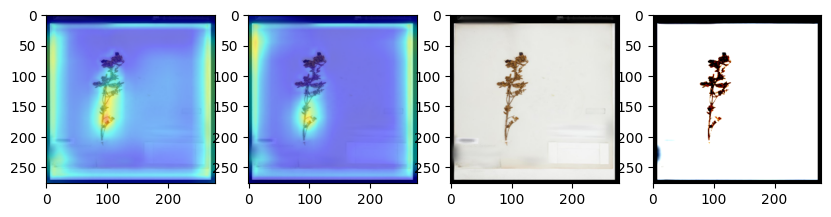

real class name:  Clidemia bullosa DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8264057636260986
Clidemia bullosa DC. 0.1273898333311081
--------------------------------


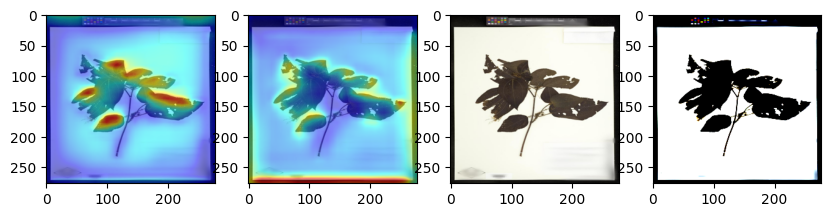

real class name:  Clidemia bullosa DC.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4327118396759033
Clidemia bullosa DC. 0.2515212595462799
--------------------------------


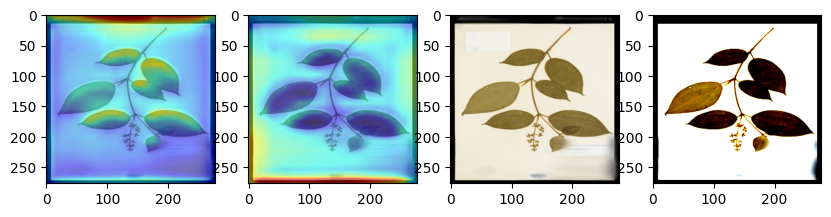

real class name:  Clidemia bullosa DC.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8808873295783997
Clidemia bullosa DC. 0.04837493598461151
--------------------------------


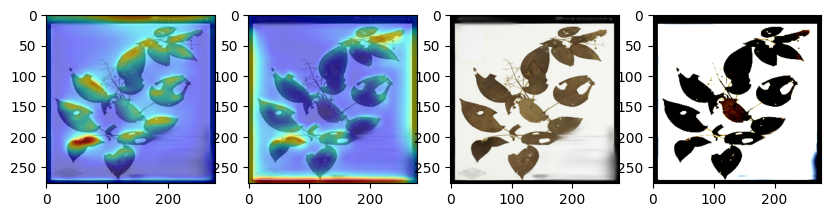

real class name:  Clidemia bullosa DC.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.348776251077652
Clidemia bullosa DC. 0.22499819099903107
--------------------------------


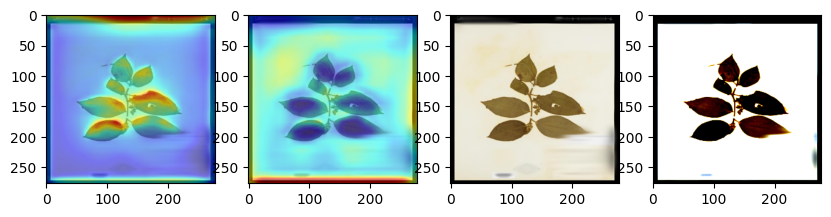

real class name:  Clidemia bullosa DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.47566795349121094
Miconia ibaguensis (Bonpl.) Triana 0.18886224925518036
--------------------------------


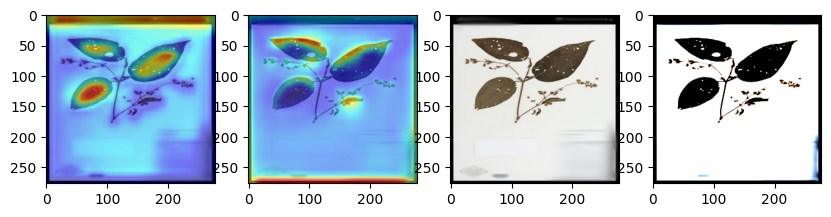

real class name:  Clidemia bullosa DC.
image 00005.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.35863184928894043
Clidemia bullosa DC. 0.3183905780315399
--------------------------------


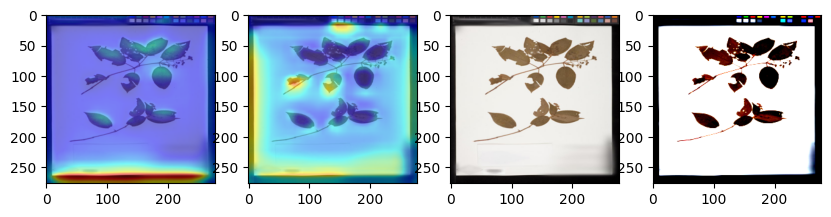

real class name:  Mouriri sagotiana Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5978915095329285
Mouriri myrtilloides (Sw.) Poir. 0.3313421905040741
--------------------------------


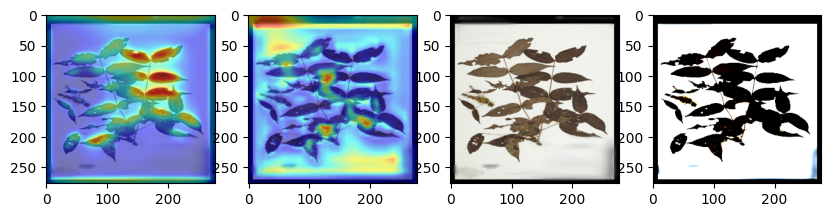

real class name:  Mouriri sagotiana Triana
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5543625950813293
Mouriri myrtilloides (Sw.) Poir. 0.3366354703903198
--------------------------------


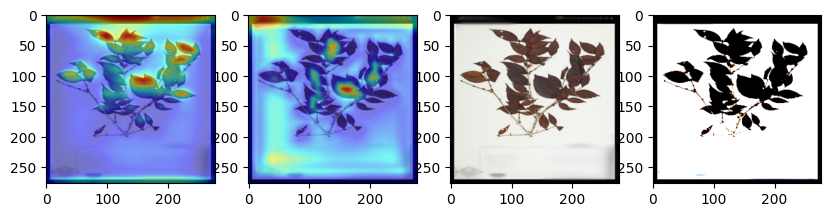

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6245478391647339
Clidemia bullosa DC. 0.12337882071733475
--------------------------------


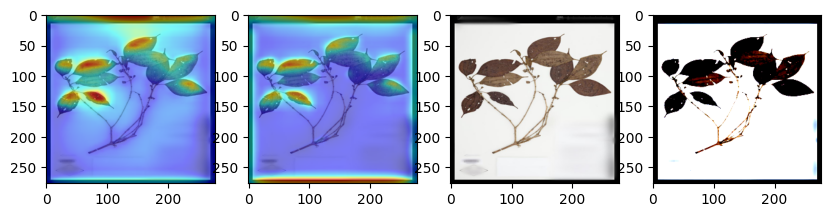

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.518027663230896
Clidemia bullosa DC. 0.16896958649158478
--------------------------------


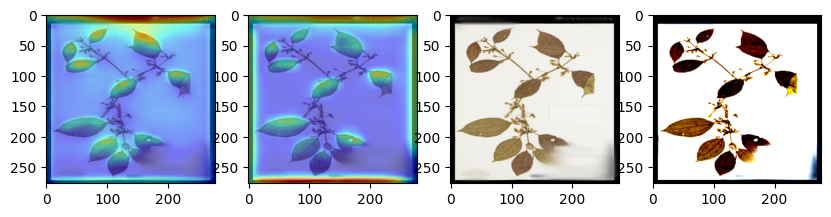

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3816414177417755
Mouriri myrtilloides (Sw.) Poir. 0.21869607269763947
--------------------------------


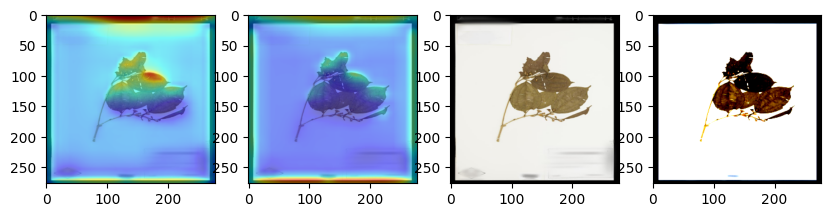

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6889140605926514
Clidemia bullosa DC. 0.20121155679225922
--------------------------------


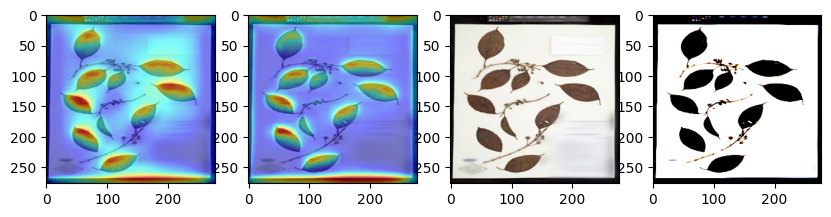

real class name:  Clidemia debilis Crueg.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.36262190341949463
Miconia racemosa (Aubl.) DC. 0.261186420917511
--------------------------------


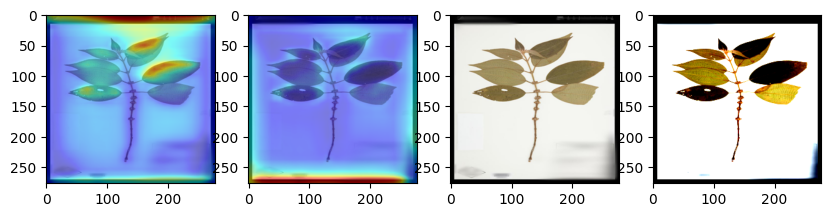

real class name:  Clidemia debilis Crueg.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.46280989050865173
Clidemia bullosa DC. 0.1846536099910736
--------------------------------


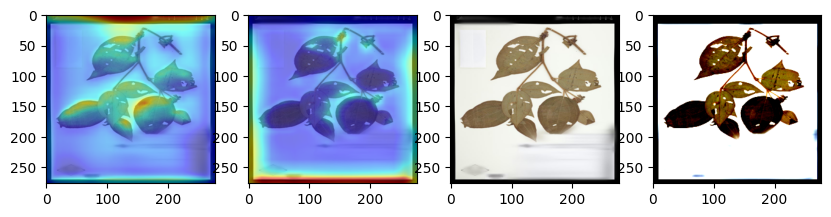

real class name:  Comolia veronicaefolia Benth.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.5619640946388245
Miconia corymbiformis Cogn. 0.12533357739448547
--------------------------------


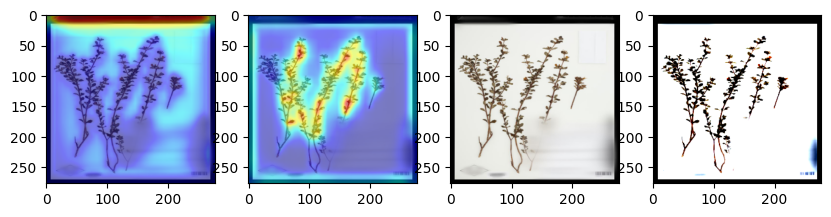

real class name:  Comolia veronicaefolia Benth.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6679887771606445
Macairea parvifolia Benth. 0.12512081861495972
--------------------------------


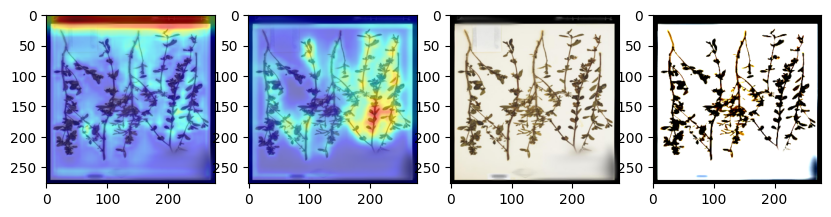

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.22085659205913544
Comolia lythrarioides Naudin 0.1310802847146988
--------------------------------


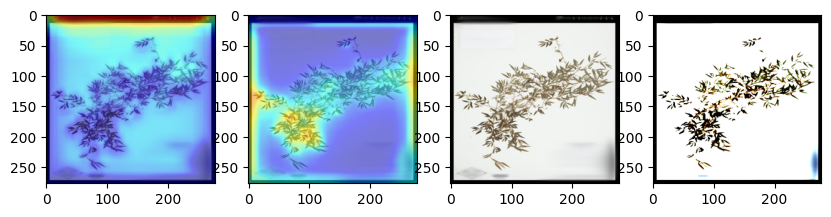

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6531091332435608
Graffenrieda harlingii Wurdack 0.08182824403047562
--------------------------------


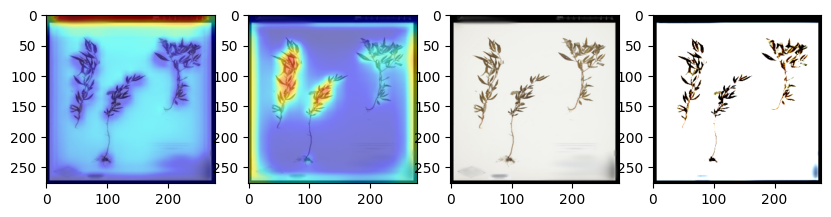

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00002.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.194959819316864
Miconia corymbiformis Cogn. 0.12352366000413895
--------------------------------


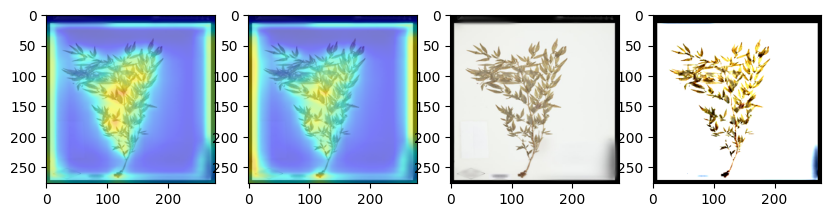

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.31215208768844604
Mouriri myrtilloides (Sw.) Poir. 0.14786238968372345
--------------------------------


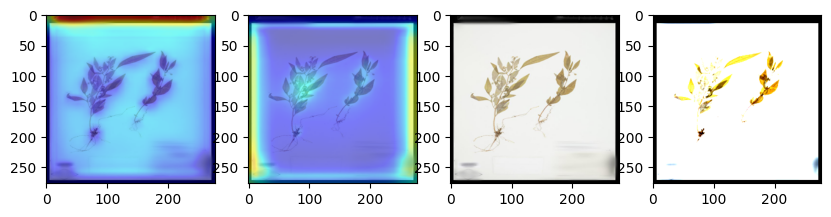

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.20283132791519165
Mouriri myrtilloides (Sw.) Poir. 0.1500866711139679
--------------------------------


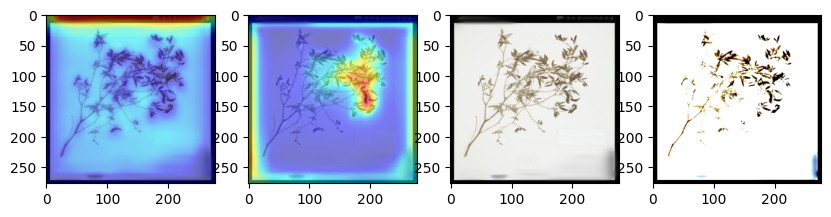

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7863133549690247
Miconia racemosa (Aubl.) DC. 0.07365402579307556
--------------------------------


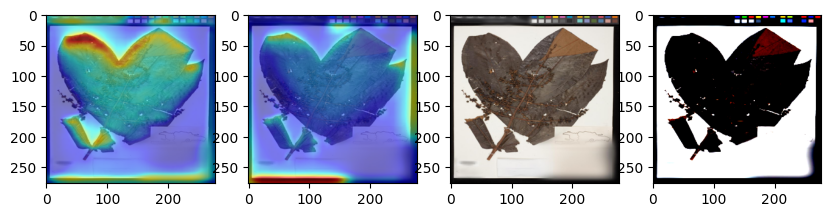

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5841220021247864
Miconia racemosa (Aubl.) DC. 0.18534964323043823
--------------------------------


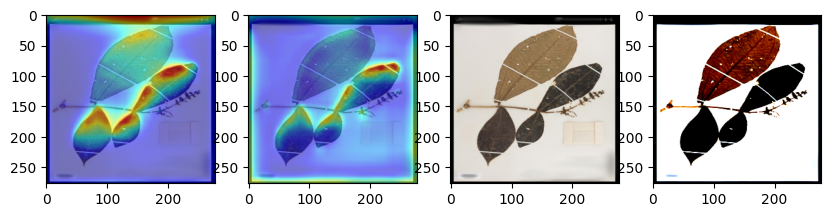

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3825029730796814
Miconia ibaguensis (Bonpl.) Triana 0.36652445793151855
--------------------------------


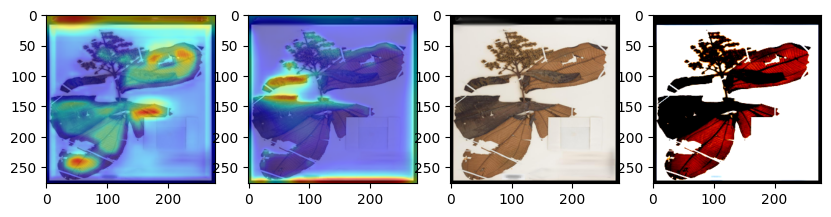

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.27156123518943787
Miconia racemosa (Aubl.) DC. 0.17280185222625732
--------------------------------


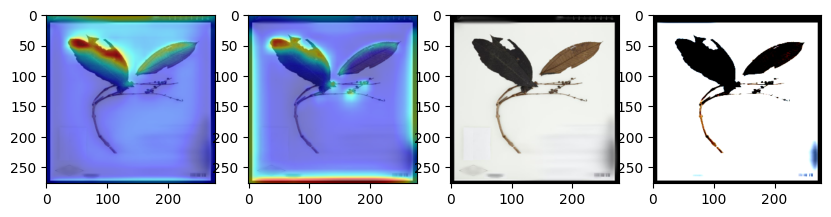

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5911439657211304
Miconia racemosa (Aubl.) DC. 0.16428183019161224
--------------------------------


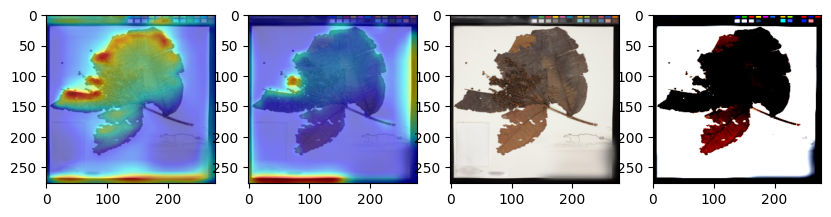

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00005.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6155911087989807
Leandra nianga (DC.) Cogn. 0.12966328859329224
--------------------------------


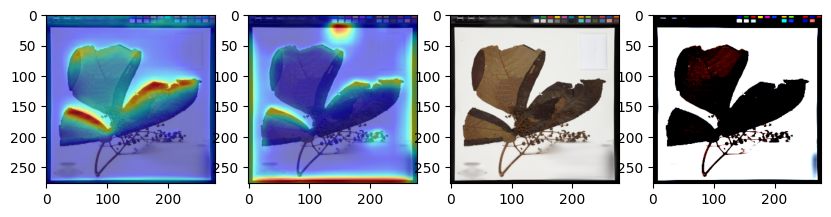

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00006.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.47140464186668396
Miconia ibaguensis (Bonpl.) Triana 0.3139522075653076
--------------------------------


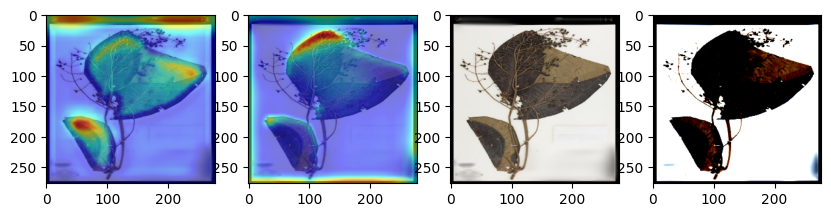

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00007.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7981420755386353
Clidemia bullosa DC. 0.06287390738725662
--------------------------------


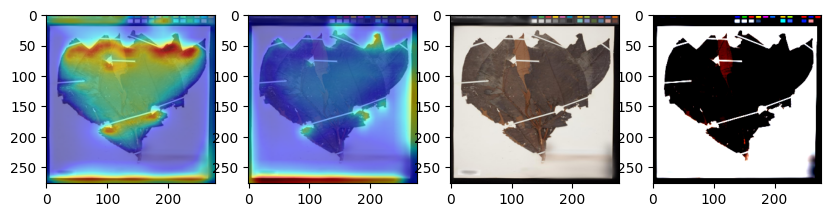

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6268908977508545
Miconia racemosa (Aubl.) DC. 0.1210799366235733
--------------------------------


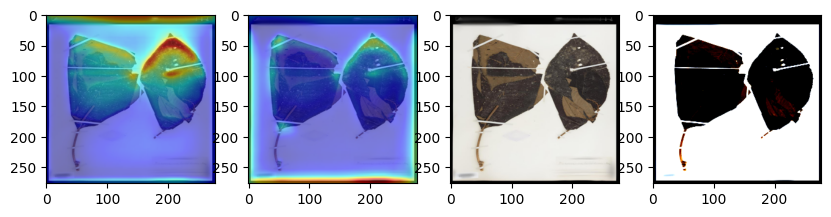

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00009.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.4079815149307251
Miconia ibaguensis (Bonpl.) Triana 0.2745633125305176
--------------------------------


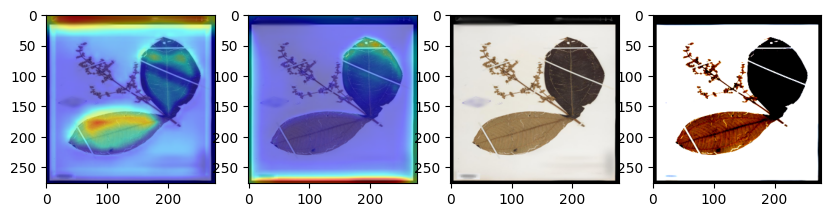

real class name:  Graffenrieda harlingii Wurdack
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.5557494163513184
Miconia racemosa (Aubl.) DC. 0.19813655316829681
--------------------------------


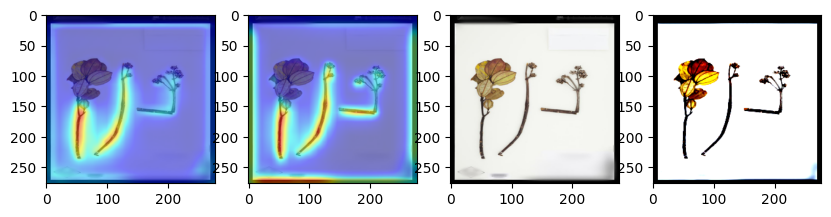

real class name:  Graffenrieda harlingii Wurdack
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.49841034412384033
Miconia ibaguensis (Bonpl.) Triana 0.2135941982269287
--------------------------------


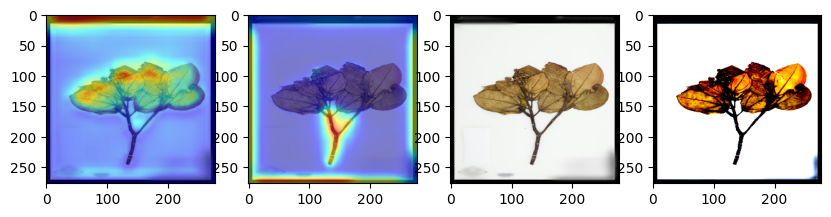

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3638893961906433
Tibouchina ciliaris (Vent.) Cogn. 0.13229483366012573
--------------------------------


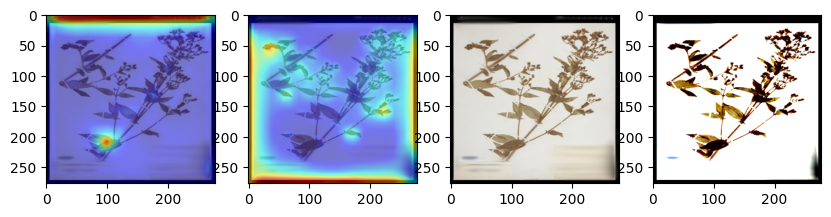

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6612783670425415
Miconia racemosa (Aubl.) DC. 0.14080308377742767
--------------------------------


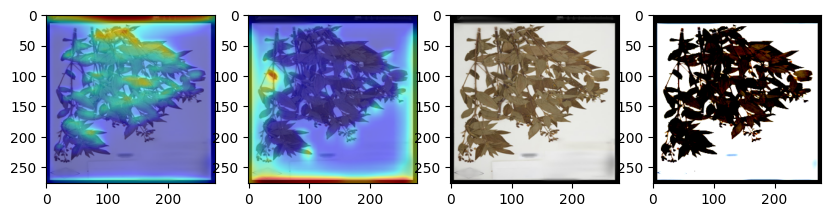

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3279692828655243
Miconia racemosa (Aubl.) DC. 0.18472948670387268
--------------------------------


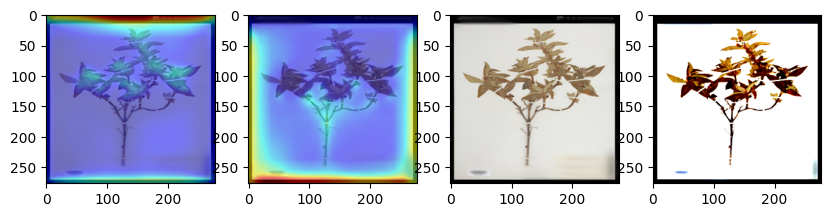

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.34059765934944153
Clidemia bullosa DC. 0.22364287078380585
--------------------------------


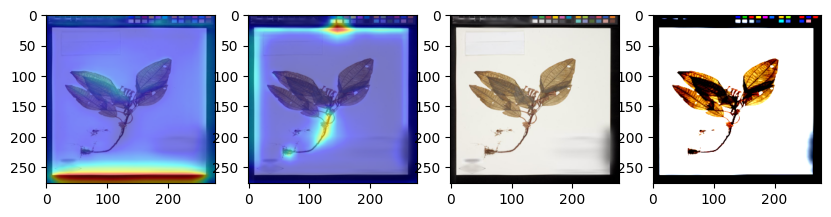

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.42482802271842957
Clidemia bullosa DC. 0.2745984196662903
--------------------------------


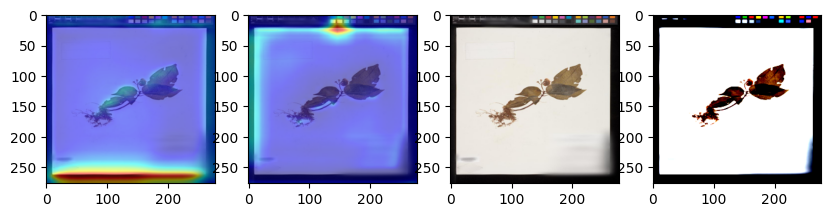

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.38012364506721497
Clidemia bullosa DC. 0.2781836986541748
--------------------------------


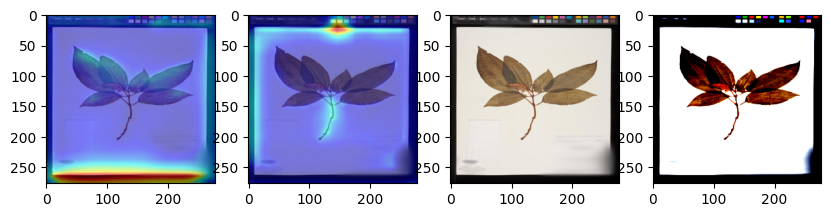

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00003.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.46360766887664795
Miconia ibaguensis (Bonpl.) Triana 0.26372411847114563
--------------------------------


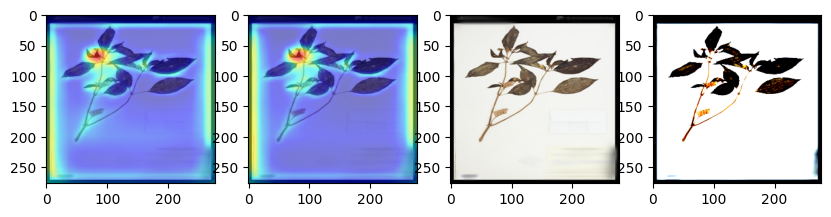

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3803972601890564
Miconia ibaguensis (Bonpl.) Triana 0.2578725814819336
--------------------------------


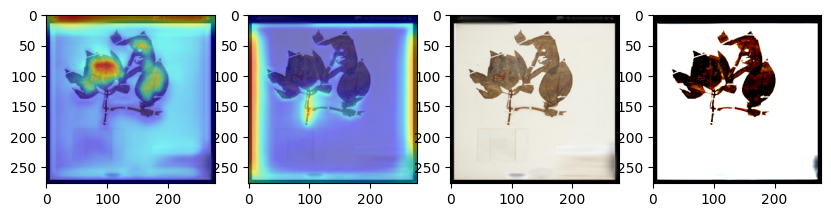

In [34]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images


resize_size =(277,277)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((277, 277))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename+"/"+img_file)
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)


    img_normalized = np.array(input_tensor)
    img_normalized = img_normalized.transpose(1, 2, 0)

    input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_batch2 = torch.from_numpy(input_batch)
    
    #input_batch3 = input_batch2.numpy()

    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      input_batch = input_batch.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(input_batch)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    # print(probabilities)
    x , y = torch.topk(probabilities, 1) 
    #print(categories[y])
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    #print(f"Detecting for class {img_file + foldername_to_class[str(filename)} +  model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    #top1_prob, top1_catid = torch.topk(probabilities, )
    #print(categories[top1_catid[i]])
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:9
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
      #print("this")
      #out_file_name ="/content/drive/MyDrive/Herbarium Data-2019/Check2/" +modelname+ "_"+gradvariantname+ "_" + foldername_to_class[filename] + "_" +os.path.basename(filename)
      #print("this")




      fig, ax = plt.subplots(1, 4, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(3):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      ax[3].imshow(img_normalized, cmap='gray')

      # Show the plot
      plt.show()









      # fig, ax = plt.subplots(1, 3)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')
   



In [ ]:
transforms.CenterCrop((230,240)),

In [57]:
!cp -R /content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation /content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder

In [59]:
import sys
import os
import glob
from PIL import Image
import torch

In [60]:
#remove black border
def main():
    path_of_the_directory = "/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation"
    for filename in os.listdir(path_of_the_directory):
        img_dir = os.path.join(path_of_the_directory, filename)
        jpg_ext = ".jpg"
        for file_name in glob.iglob(os.path.join(img_dir, "*" + jpg_ext)):
            original_image = Image.open(file_name)

            area = (30, 100, 650, 950)
            new_image = original_image.crop(area)
            new_image.save(file_name)
           
            

if __name__ == "__main__":
    print("Python {:s} on {:s}\n".format(sys.version, sys.platform))
    main()
    print("\nDone.")

Python 3.9.16 (main, Dec  7 2022, 01:11:51) 
[GCC 9.4.0] on linux


Done.


real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5257543325424194
Miconia ibaguensis (Bonpl.) Triana 0.21361544728279114
--------------------------------


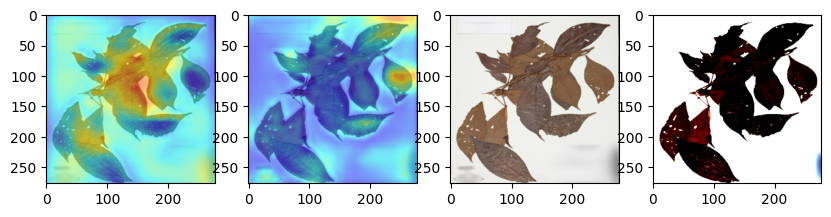

real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.33814024925231934
Miconia ibaguensis (Bonpl.) Triana 0.30464649200439453
--------------------------------


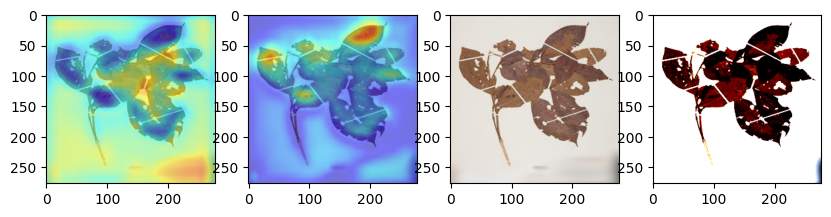

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8229377865791321
Clidemia bullosa DC. 0.1358165293931961
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6783538460731506
Clidemia bullosa DC. 0.30120521783828735
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.31296688318252563
Miconia ibaguensis (Bonpl.) Triana 0.27410322427749634
--------------------------------


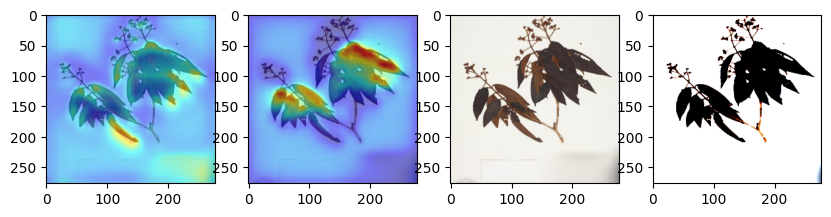

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00004.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5012835264205933
Miconia ibaguensis (Bonpl.) Triana 0.3735511302947998
--------------------------------


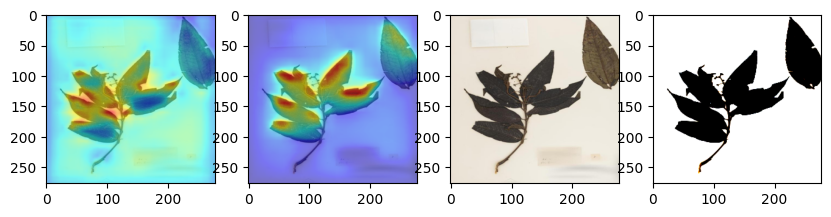

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5798923969268799
Clidemia bullosa DC. 0.23814275860786438
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00002.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5149059891700745
Miconia ibaguensis (Bonpl.) Triana 0.38232097029685974
--------------------------------


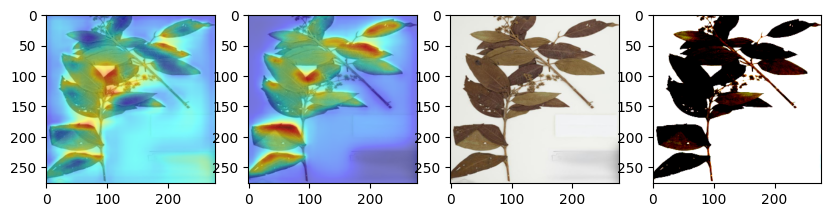

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00007.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.42526718974113464
Miconia ibaguensis (Bonpl.) Triana 0.12268608063459396
--------------------------------


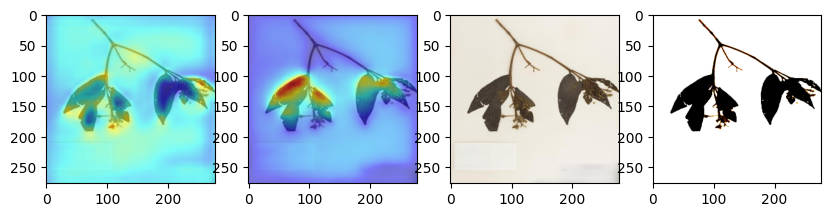

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00005.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.7313754558563232
Macairea parvifolia Benth. 0.07987052947282791
--------------------------------


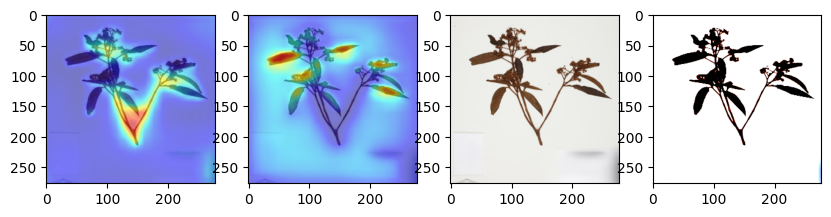

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00006.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5380971431732178
Miconia ibaguensis (Bonpl.) Triana 0.42101770639419556
--------------------------------


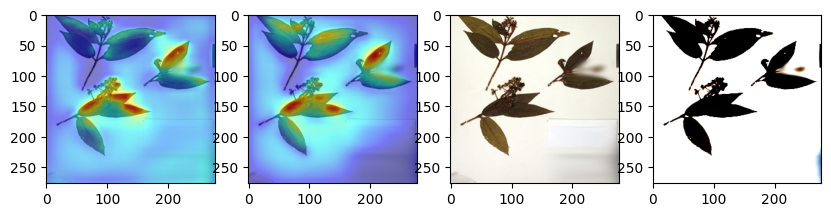

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00009.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4933587908744812
Salpinga secunda Schrank & Mart. ex DC. 0.17149817943572998
--------------------------------


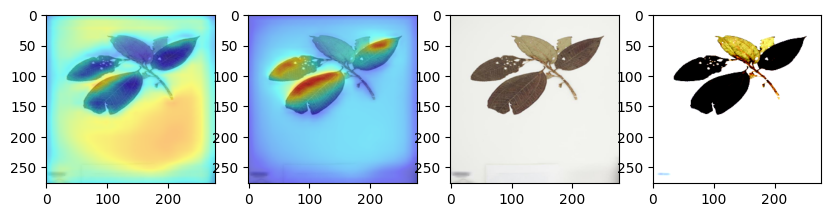

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00014.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.42293450236320496
Miconia ibaguensis (Bonpl.) Triana 0.23451822996139526
--------------------------------


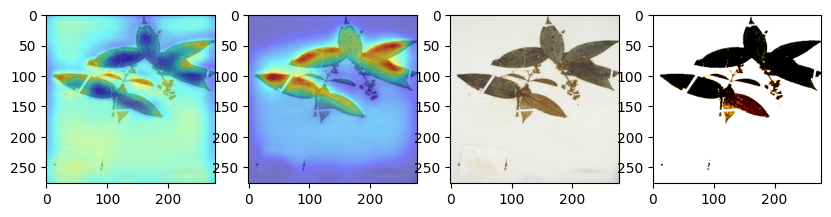

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00012.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.6651710867881775
Miconia ibaguensis (Bonpl.) Triana 0.200958713889122
--------------------------------


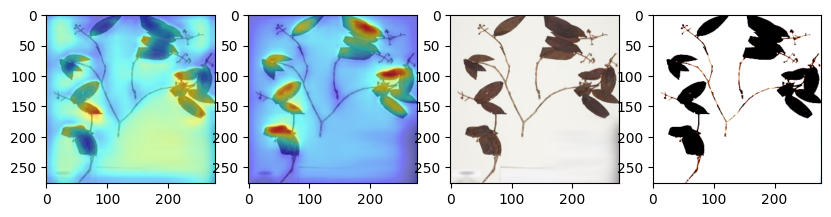

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00016.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5400266647338867
Miconia ibaguensis (Bonpl.) Triana 0.2508404850959778
--------------------------------


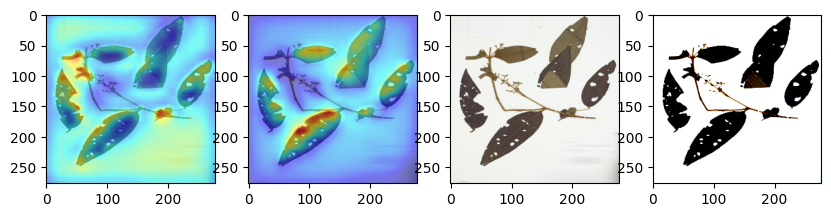

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00011.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5819354057312012
Miconia racemosa (Aubl.) DC. 0.10379953682422638
--------------------------------


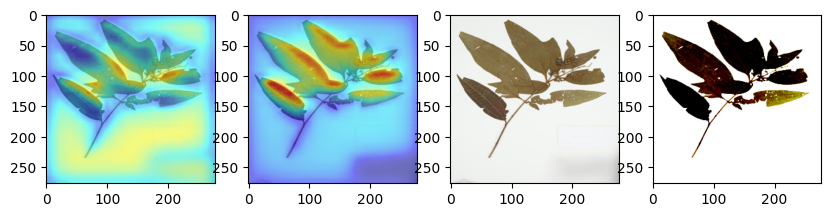

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00010.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3992560803890228
Clidemia bullosa DC. 0.30745676159858704
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00013.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.521429717540741
Miconia ibaguensis (Bonpl.) Triana 0.2270873636007309
--------------------------------


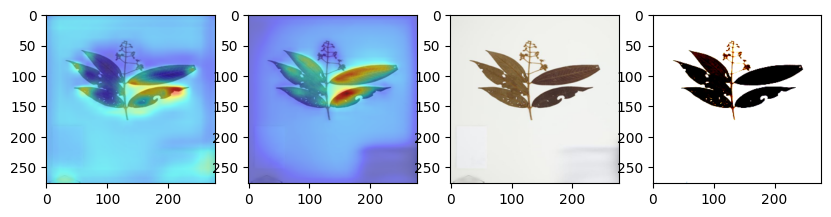

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00015.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4433104693889618
Miconia ibaguensis (Bonpl.) Triana 0.3002629578113556
--------------------------------


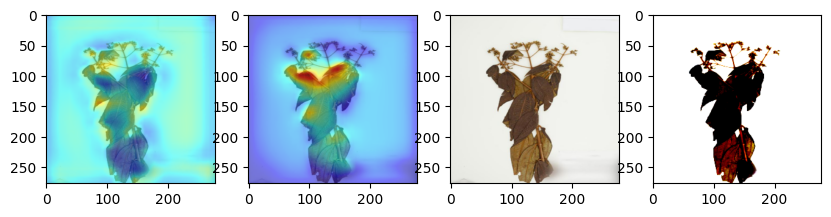

real class name:  Leandra nianga (DC.) Cogn.
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.34772369265556335
Salpinga secunda Schrank & Mart. ex DC. 0.23801451921463013
--------------------------------


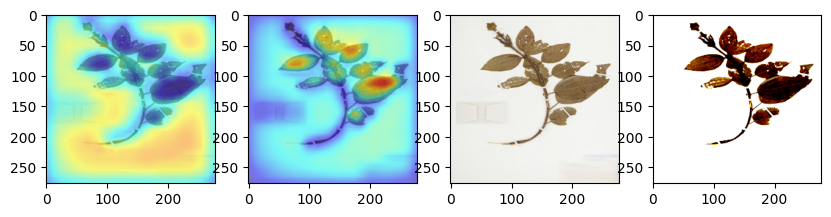

real class name:  Leandra nianga (DC.) Cogn.
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5232682228088379
Miconia ibaguensis (Bonpl.) Triana 0.21901832520961761
--------------------------------


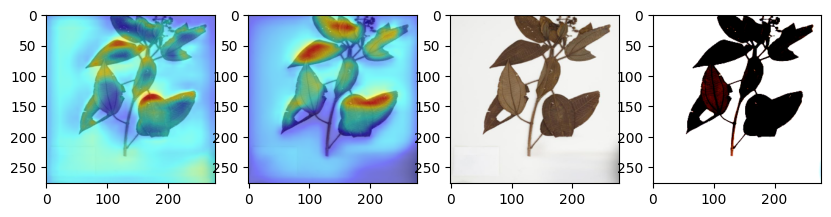

real class name:  Tibouchina semidecandra Cogn.
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.514413595199585
Salpinga secunda Schrank & Mart. ex DC. 0.11641762405633926
--------------------------------


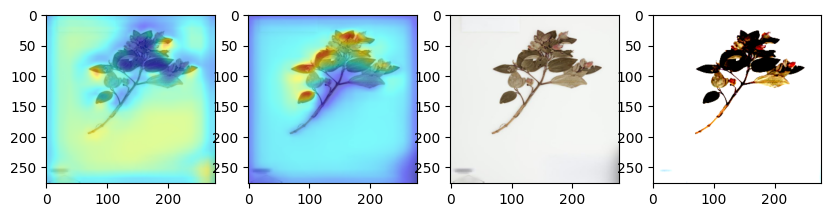

real class name:  Tibouchina semidecandra Cogn.
image 00001.jpg Detecting for class Salpinga secunda Schrank & Mart. ex DC. by model resnet50
-
Salpinga secunda Schrank & Mart. ex DC. 0.29562947154045105
Clidemia bullosa DC. 0.28122788667678833
--------------------------------


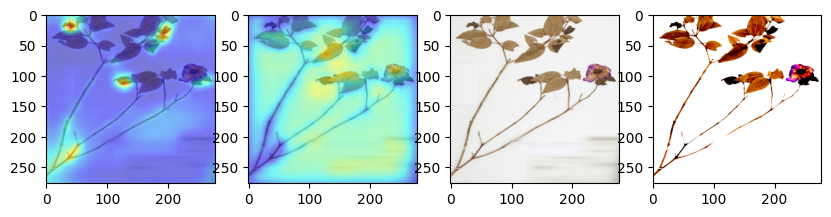

real class name:  Miconia racemosa (Aubl.) DC.
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.36498382687568665
Miconia ibaguensis (Bonpl.) Triana 0.24504488706588745
--------------------------------


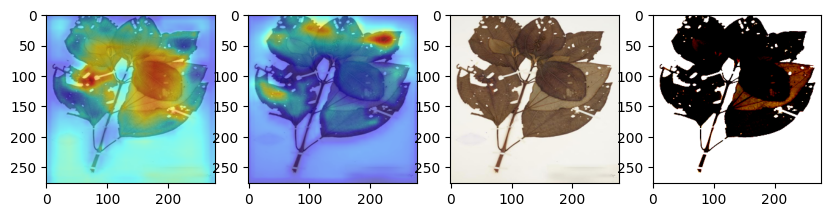

real class name:  Miconia racemosa (Aubl.) DC.
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.493264377117157
Miconia racemosa (Aubl.) DC. 0.12666983902454376
--------------------------------


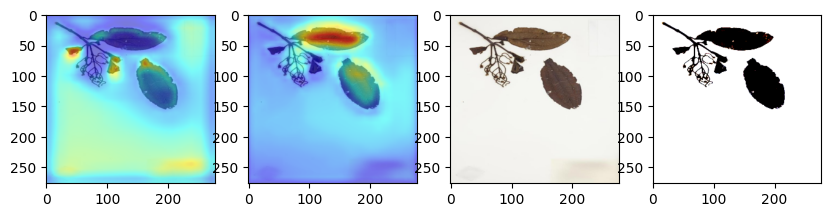

real class name:  Miconia racemosa (Aubl.) DC.
image 00002.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.6663066744804382
Miconia ibaguensis (Bonpl.) Triana 0.13744063675403595
--------------------------------


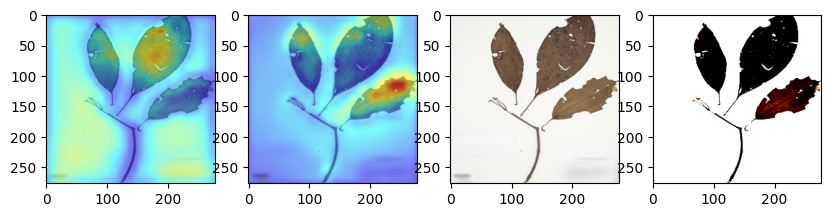

real class name:  Miconia racemosa (Aubl.) DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5869890451431274
Clidemia bullosa DC. 0.2794777452945709
--------------------------------


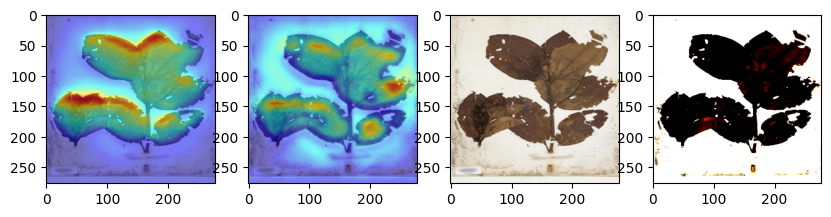

real class name:  Miconia racemosa (Aubl.) DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4955143928527832
Clidemia bullosa DC. 0.2504706084728241
--------------------------------


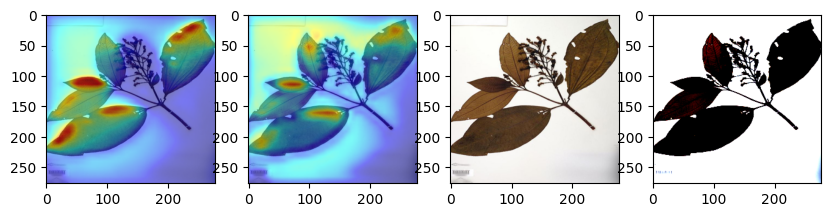

real class name:  Miconia racemosa (Aubl.) DC.
image 00005.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.564106822013855
Miconia ibaguensis (Bonpl.) Triana 0.3267771601676941
--------------------------------


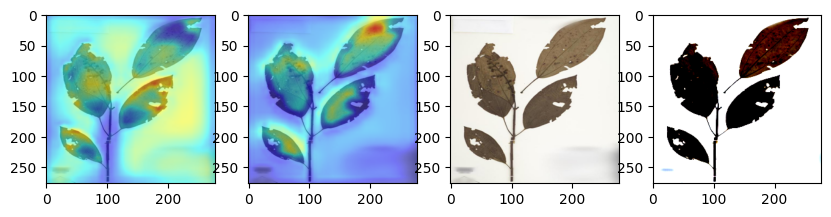

real class name:  Miconia racemosa (Aubl.) DC.
image 00007.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6222025156021118
Clidemia bullosa DC. 0.12502421438694
--------------------------------


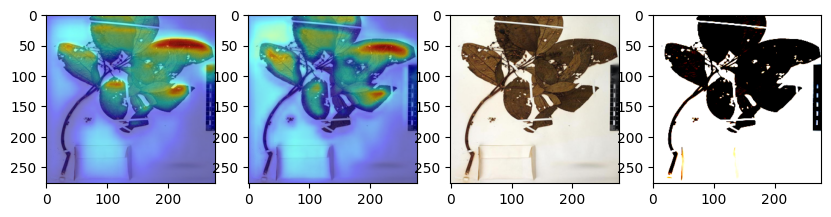

real class name:  Miconia racemosa (Aubl.) DC.
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3854936957359314
Clidemia bullosa DC. 0.3335835635662079
--------------------------------


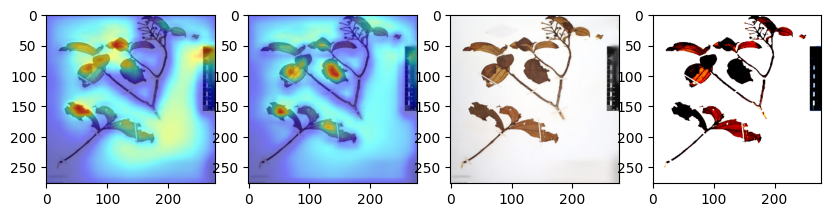

real class name:  Miconia racemosa (Aubl.) DC.
image 00008.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4595094621181488
Miconia racemosa (Aubl.) DC. 0.12290333956480026
--------------------------------


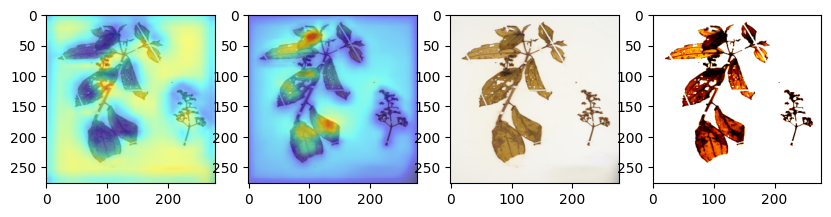

real class name:  Miconia racemosa (Aubl.) DC.
image 00009.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.4417966306209564
Clidemia bullosa DC. 0.2235216647386551
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00010.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.32027938961982727
Miconia racemosa (Aubl.) DC. 0.2626408338546753
--------------------------------


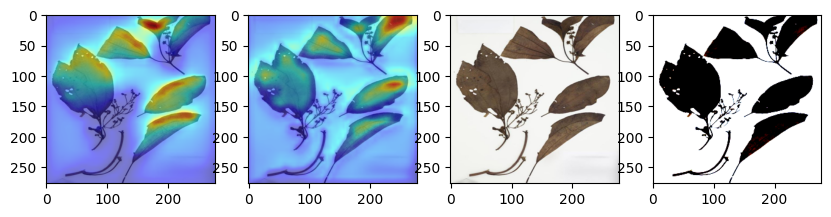

real class name:  Comolia lythrarioides Naudin
image 00000.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.5443204045295715
Comolia lythrarioides Naudin 0.32819223403930664
--------------------------------


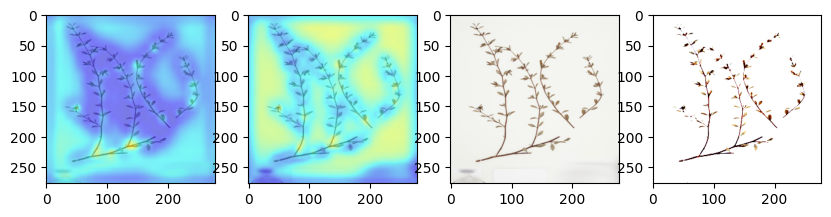

real class name:  Comolia lythrarioides Naudin
image 00002.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.4625716805458069
Comolia lythrarioides Naudin 0.3528364896774292
--------------------------------


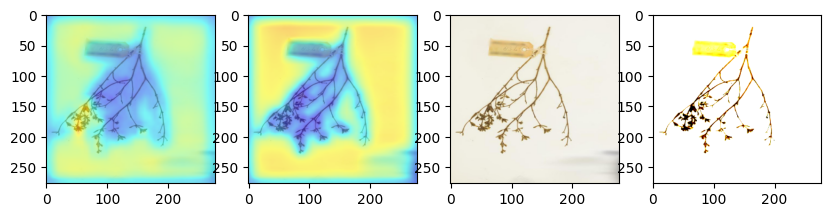

real class name:  Comolia lythrarioides Naudin
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.6025907397270203
Comolia veronicaefolia Benth. 0.3089442253112793
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.4748160243034363
Miconia ibaguensis (Bonpl.) Triana 0.34144723415374756
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5021542906761169
Clidemia bullosa DC. 0.2201557755470276
--------------------------------


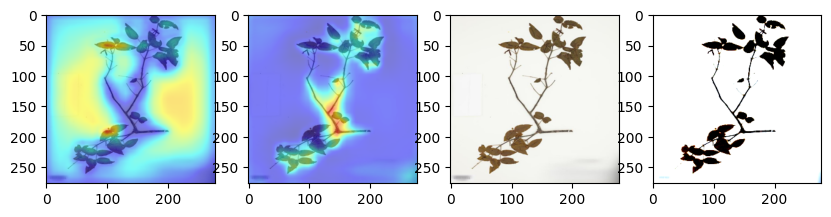

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5954470634460449
Clidemia bullosa DC. 0.20572201907634735
--------------------------------


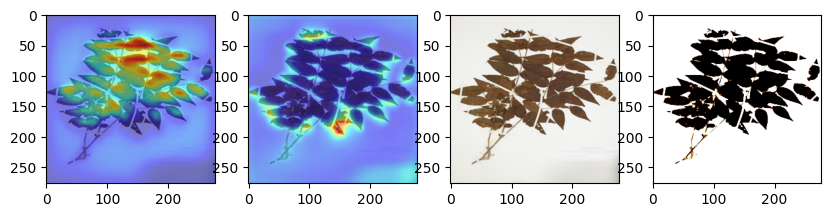

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4256349802017212
Salpinga secunda Schrank & Mart. ex DC. 0.11491360515356064
--------------------------------


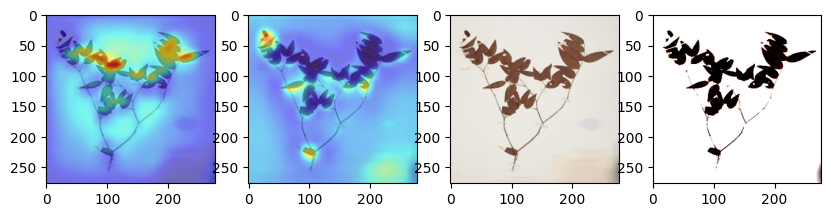

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00004.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.7926459908485413
Macairea parvifolia Benth. 0.10898637771606445
--------------------------------
real class name:  Miconia corymbiformis Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4664037525653839
Clidemia bullosa DC. 0.33365482091903687
--------------------------------


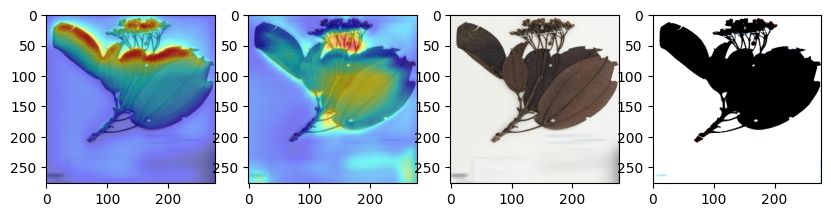

real class name:  Miconia corymbiformis Cogn.
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.3960810899734497
Miconia racemosa (Aubl.) DC. 0.2160603255033493
--------------------------------


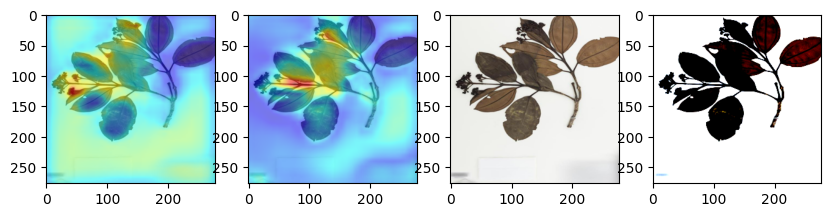

real class name:  Miconia corymbiformis Cogn.
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.39504528045654297
Clidemia bullosa DC. 0.29721009731292725
--------------------------------


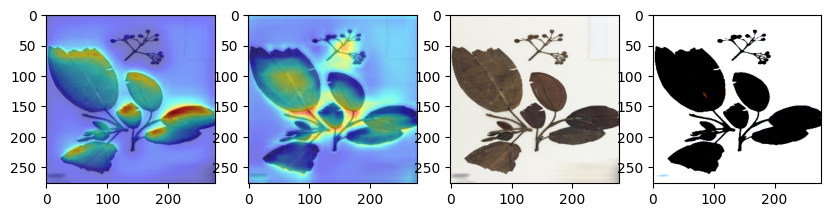

real class name:  Macairea parvifolia Benth.
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.26011985540390015
Macairea parvifolia Benth. 0.196645125746727
--------------------------------


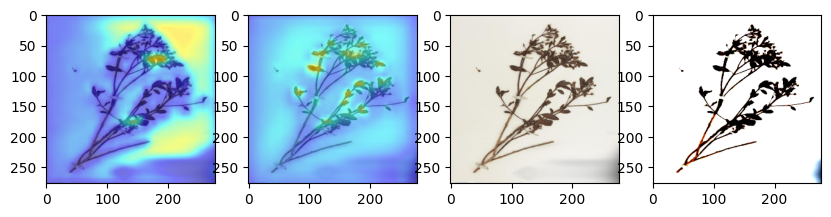

real class name:  Macairea parvifolia Benth.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.5482989549636841
Macairea parvifolia Benth. 0.29643234610557556
--------------------------------


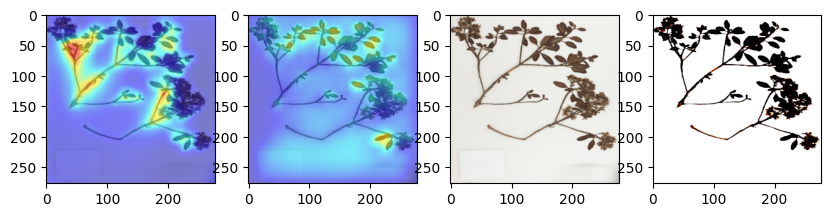

real class name:  Brachyotum strigosum (L.f.) Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.18799015879631042
Miconia racemosa (Aubl.) DC. 0.1770513355731964
--------------------------------


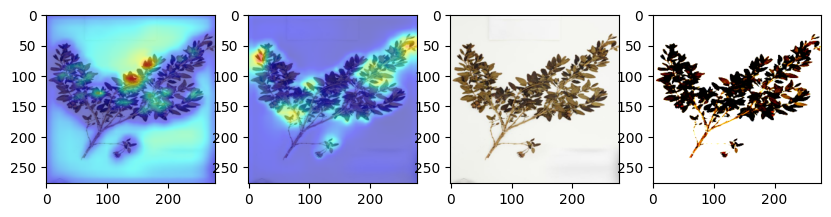

real class name:  Brachyotum strigosum (L.f.) Triana
image 00001.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.28466612100601196
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.2501978278160095
--------------------------------


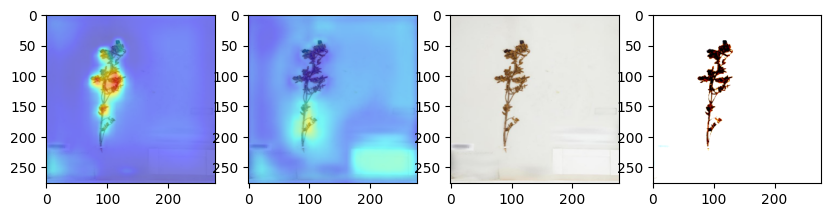

real class name:  Clidemia bullosa DC.
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5842373967170715
Blakea henripittieri (Cogn.) Penneys & Almeda 0.15593108534812927
--------------------------------
real class name:  Clidemia bullosa DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5207626223564148
Clidemia bullosa DC. 0.46888017654418945
--------------------------------


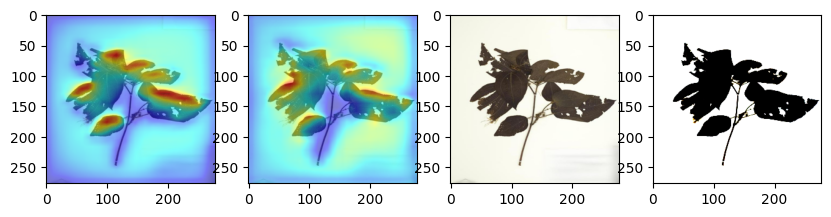

real class name:  Clidemia bullosa DC.
image 00002.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5542006492614746
Miconia ibaguensis (Bonpl.) Triana 0.39129000902175903
--------------------------------
real class name:  Clidemia bullosa DC.
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.6151680946350098
Salpinga secunda Schrank & Mart. ex DC. 0.10937828570604324
--------------------------------
real class name:  Clidemia bullosa DC.
image 00005.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.3644174337387085
Salpinga secunda Schrank & Mart. ex DC. 0.24851630628108978
--------------------------------
real class name:  Clidemia bullosa DC.
image 00004.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.29554983973503113
Miconia ibaguensis (Bonpl.) Triana 0.2274090051651001
--------------------------------
real class nam

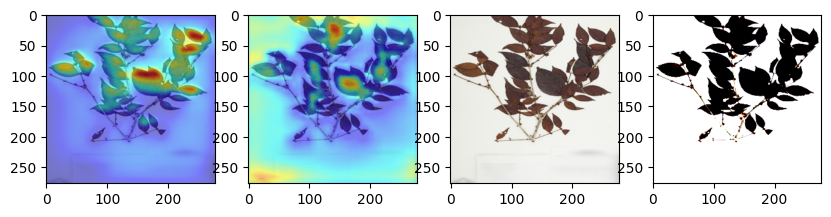

real class name:  Mouriri sagotiana Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8404549956321716
Clidemia bullosa DC. 0.09372908622026443
--------------------------------


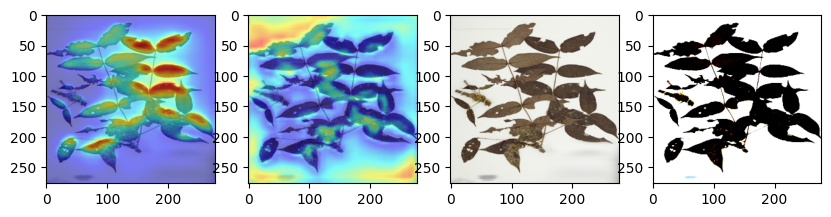

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.34019872546195984
Salpinga secunda Schrank & Mart. ex DC. 0.21008425951004028
--------------------------------


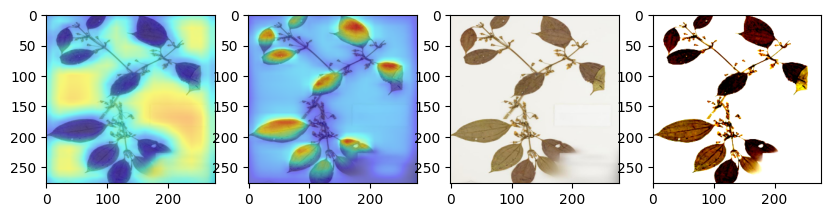

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.6312497854232788
Miconia ibaguensis (Bonpl.) Triana 0.11598873138427734
--------------------------------


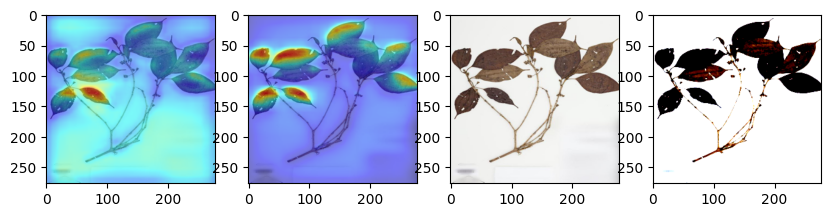

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00002.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.43343430757522583
Salpinga secunda Schrank & Mart. ex DC. 0.18903478980064392
--------------------------------


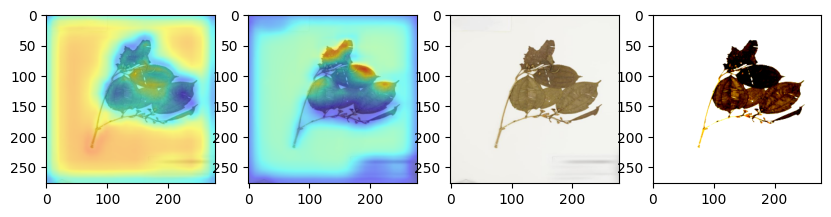

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.6809812784194946
Miconia ibaguensis (Bonpl.) Triana 0.2498619109392166
--------------------------------


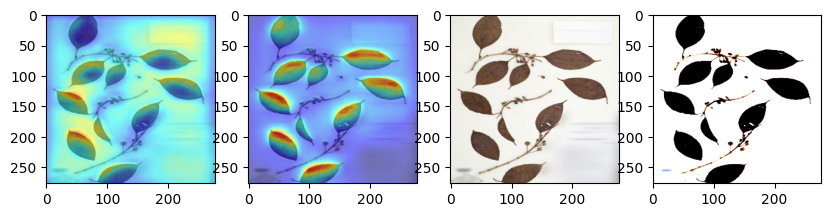

real class name:  Clidemia debilis Crueg.
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5022738575935364
Salpinga secunda Schrank & Mart. ex DC. 0.15230385959148407
--------------------------------


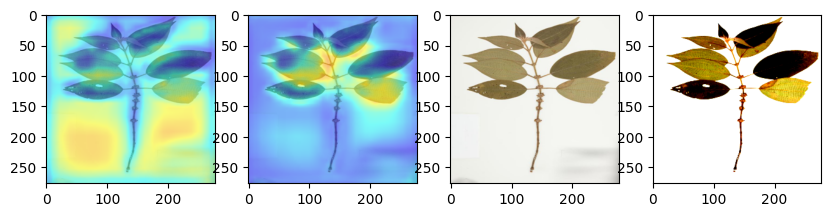

real class name:  Clidemia debilis Crueg.
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5745611786842346
Blakea henripittieri (Cogn.) Penneys & Almeda 0.10414490848779678
--------------------------------


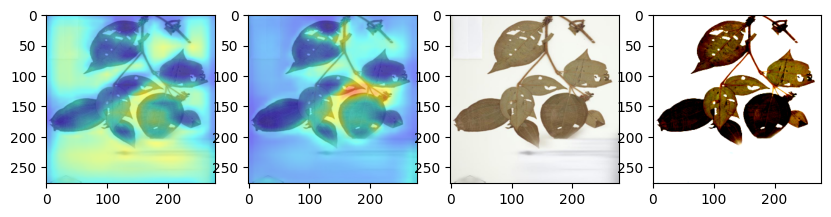

real class name:  Comolia veronicaefolia Benth.
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.4634541869163513
Macairea parvifolia Benth. 0.388785719871521
--------------------------------


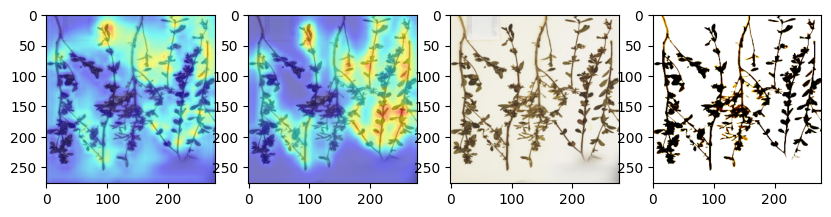

real class name:  Comolia veronicaefolia Benth.
image 00000.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.6761199831962585
Comolia veronicaefolia Benth. 0.2757036089897156
--------------------------------


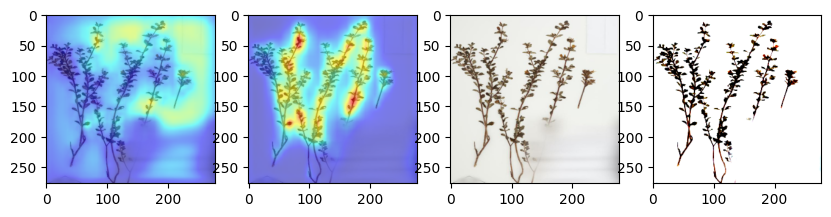

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00002.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.5314054489135742
Comolia lythrarioides Naudin 0.3316831886768341
--------------------------------


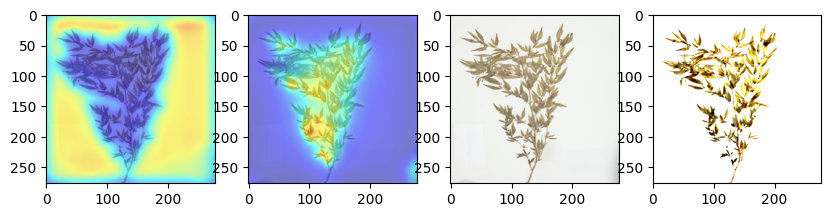

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00003.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.3885883688926697
Comolia lythrarioides Naudin 0.2887412905693054
--------------------------------


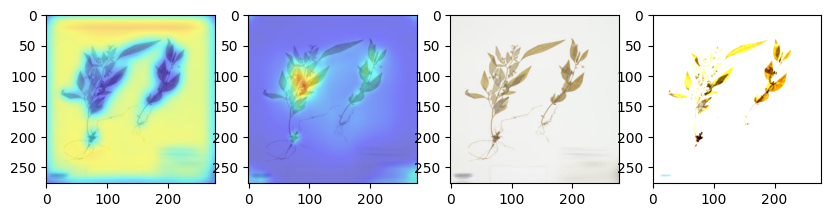

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00004.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.5296638011932373
Comolia lythrarioides Naudin 0.398556113243103
--------------------------------


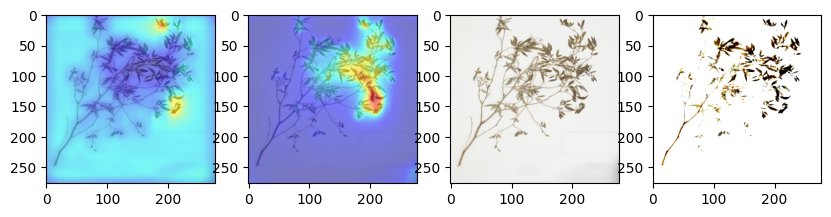

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00000.jpg Detecting for class Comolia veronicaefolia Benth. by model resnet50
-
Comolia veronicaefolia Benth. 0.5071184635162354
Comolia lythrarioides Naudin 0.4151524007320404
--------------------------------


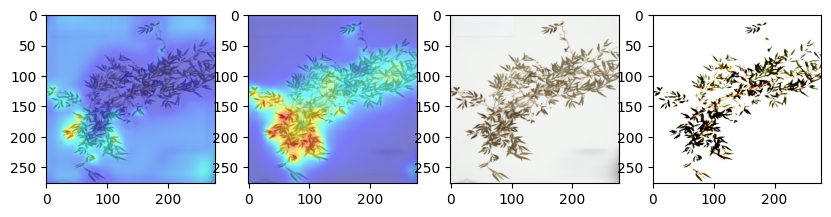

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.5089938640594482
Comolia veronicaefolia Benth. 0.39491549134254456
--------------------------------


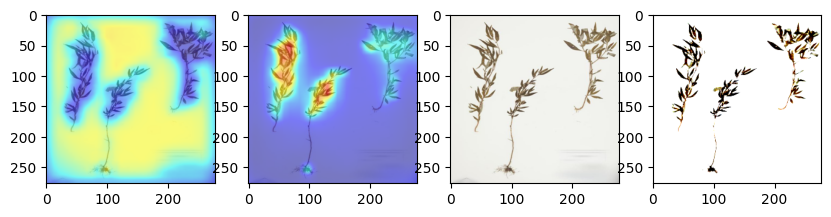

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5762414336204529
Clidemia bullosa DC. 0.20402644574642181
--------------------------------


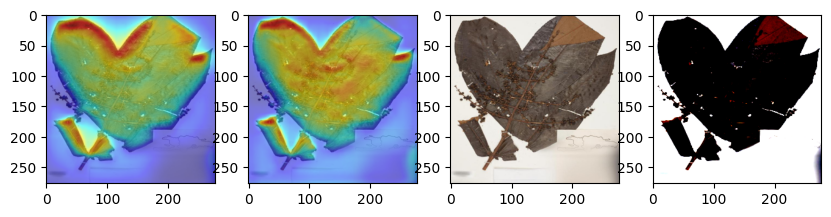

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6658650636672974
Clidemia bullosa DC. 0.18599915504455566
--------------------------------


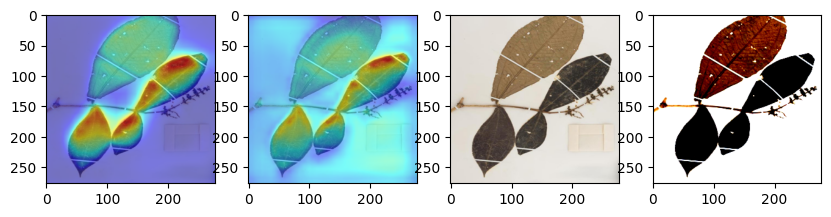

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00002.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4729240834712982
Miconia ibaguensis (Bonpl.) Triana 0.3499700129032135
--------------------------------


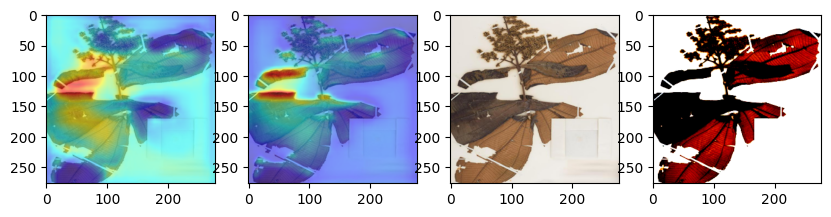

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4139259159564972
Miconia ibaguensis (Bonpl.) Triana 0.17011164128780365
--------------------------------


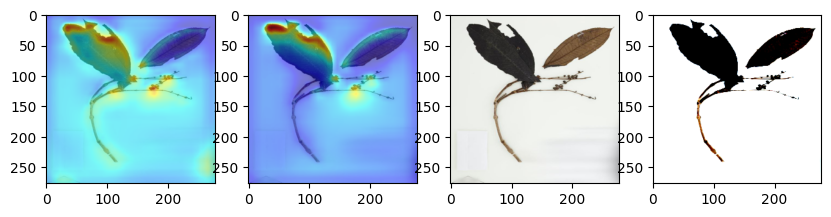

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.40602537989616394
Clidemia bullosa DC. 0.38210329413414
--------------------------------


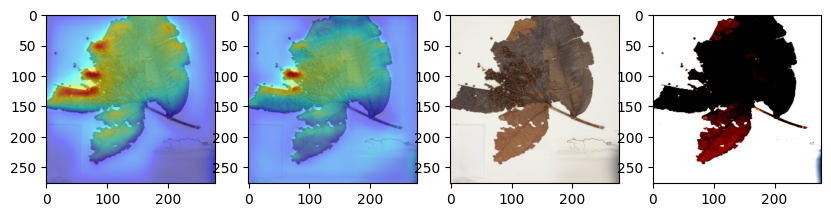

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00005.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6029486060142517
Clidemia bullosa DC. 0.18952347338199615
--------------------------------


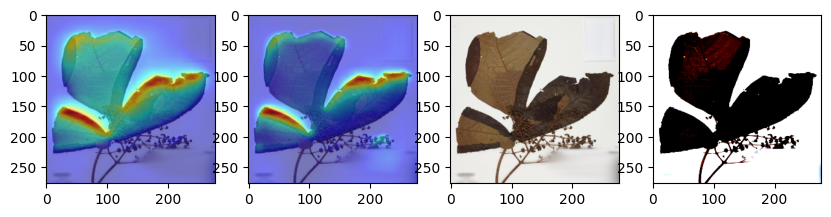

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4039168357849121
Clidemia bullosa DC. 0.2628323435783386
--------------------------------


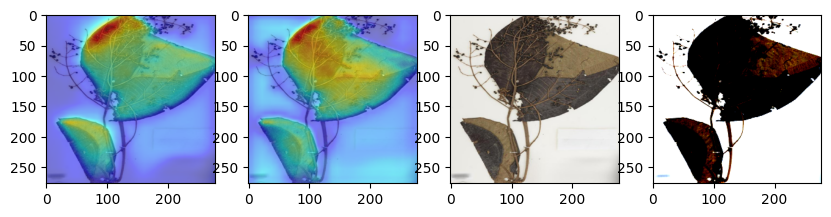

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00009.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.35031411051750183
Miconia ibaguensis (Bonpl.) Triana 0.3048332929611206
--------------------------------


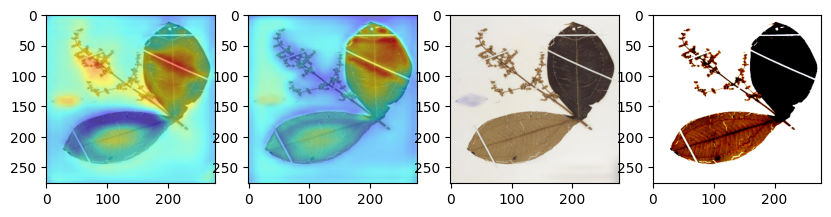

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00007.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7814623713493347
Clidemia bullosa DC. 0.14935941994190216
--------------------------------


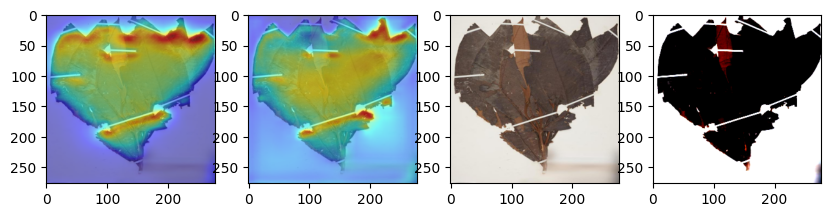

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5628281235694885
Clidemia bullosa DC. 0.22701556980609894
--------------------------------


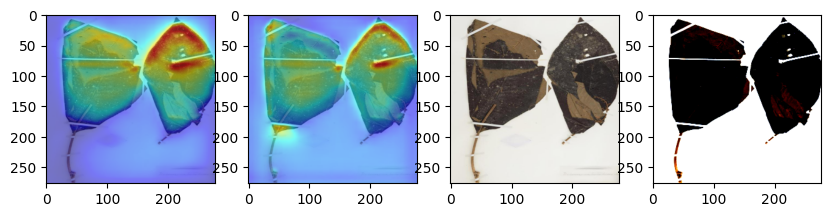

real class name:  Graffenrieda harlingii Wurdack
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3593268394470215
Graffenrieda harlingii Wurdack 0.1566350758075714
--------------------------------


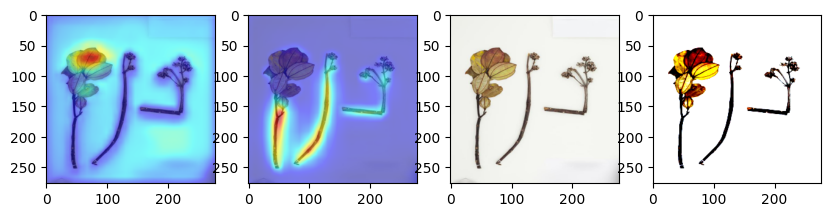

real class name:  Graffenrieda harlingii Wurdack
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4113418161869049
Miconia racemosa (Aubl.) DC. 0.14667215943336487
--------------------------------


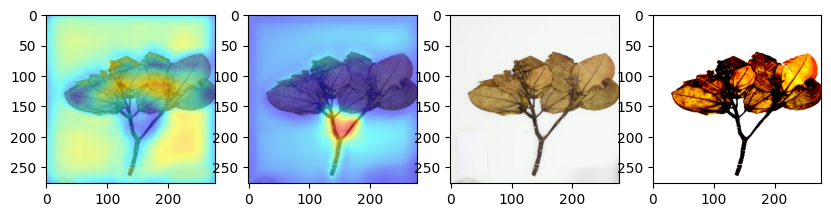

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00000.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.7018942832946777
Comolia lythrarioides Naudin 0.1262495517730713
--------------------------------
real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5989488363265991
Clidemia bullosa DC. 0.18724524974822998
--------------------------------


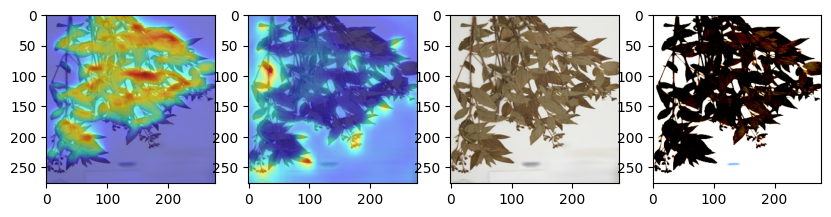

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00002.jpg Detecting for class Salpinga secunda Schrank & Mart. ex DC. by model resnet50
-
Salpinga secunda Schrank & Mart. ex DC. 0.48745328187942505
Tibouchina ciliaris (Vent.) Cogn. 0.26749658584594727
--------------------------------


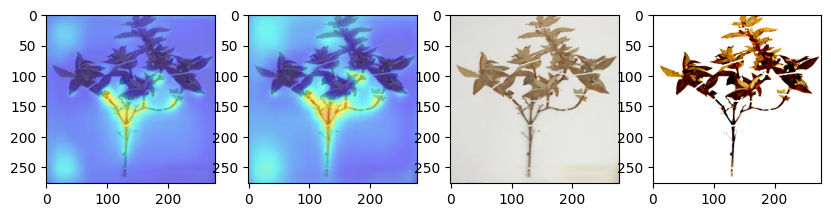

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00000.jpg Detecting for class Salpinga secunda Schrank & Mart. ex DC. by model resnet50
-
Salpinga secunda Schrank & Mart. ex DC. 0.3318278193473816
Clidemia bullosa DC. 0.21332576870918274
--------------------------------
real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00001.jpg Detecting for class Salpinga secunda Schrank & Mart. ex DC. by model resnet50
-
Salpinga secunda Schrank & Mart. ex DC. 0.3339201807975769
Clidemia bullosa DC. 0.21062633395195007
--------------------------------
real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00002.jpg Detecting for class Salpinga secunda Schrank & Mart. ex DC. by model resnet50
-
Salpinga secunda Schrank & Mart. ex DC. 0.3597481846809387
Clidemia bullosa DC. 0.2535243034362793
--------------------------------
real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00004.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clide

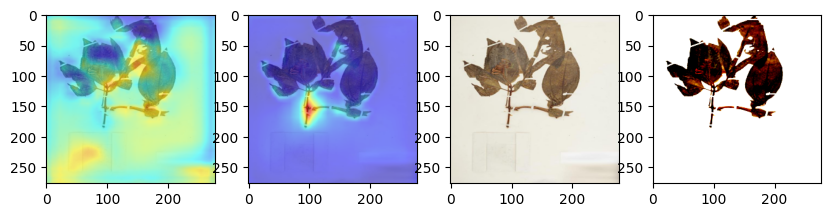

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00003.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4529667794704437
Miconia ibaguensis (Bonpl.) Triana 0.22447414696216583
--------------------------------


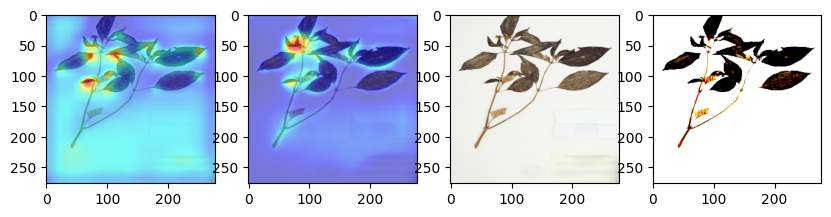

In [35]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images


resize_size =(277,277)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((277, 277))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+filename+"/"+img_file)
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(), 
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)


    img_normalized = np.array(input_tensor)
    img_normalized = img_normalized.transpose(1, 2, 0)

    input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_batch2 = torch.from_numpy(input_batch)
    
    #input_batch3 = input_batch2.numpy()

    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      input_batch = input_batch.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(input_batch)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    # print(probabilities)
    x , y = torch.topk(probabilities, 1) 
    #print(categories[y])
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    #print(f"Detecting for class {img_file + foldername_to_class[str(filename)} +  model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    #top1_prob, top1_catid = torch.topk(probabilities, )
    #print(categories[top1_catid[i]])
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:9
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
      #print("this")
      #out_file_name ="/content/drive/MyDrive/Herbarium Data-2019/Check2/" +modelname+ "_"+gradvariantname+ "_" + foldername_to_class[filename] + "_" +os.path.basename(filename)
      #print("this")




      fig, ax = plt.subplots(1, 4, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(3):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      ax[3].imshow(img_normalized, cmap='gray')

      # Show the plot
      plt.show()









      # fig, ax = plt.subplots(1, 3)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')
   



In [ ]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images

resize_size =(277,277)

directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for foldername in files:
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+foldername)
  for filename in img_files:
      input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+foldername +'/' +filename)

      preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pre-trained models
          ]
      )
      input_tensor = preprocess(input_image)
      print("Input Tensor Shape:", input_tensor.shape)
      input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model
      # move the input and model to GPU for speed if available
      if torch.cuda.is_available():
          input_batch = input_batch.to("cuda")
          model.to("cuda")
          input_tensor = input_tensor.to("cuda")

      # We have to specify the target we want to generate
      # the Class Activation Maps for.
      # If targets is None, the highest scoring category
      # will be used for every image in the batch.
      # Here we use ClassifierOutputTarget, but you can define your own custom targets

      # That are, for example, combinations of categories, or specific outputs in a non standard model.
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      
  #/content/drive/MyDrive/Model Data/gradcam_out

      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
      out_file_name0 ="/content/drive/MyDrive/Hebarium-Data-2019/Grad_plotwithBorderAC/" +modelname+ "_GradCAM for Miconia approximata Gamba & Almeda_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      out_file_name1 ="/SEAS/home/darei/Herabarium/Herbarium2019/Grad_plotwithBorderPr/" +modelname+ "_Grad for Miconia ibaguensis (Bonpl.) Triana_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      visualization0.save(out_file_name0)
      #visualization1.save(out_file_name1)
      #print("Visualization saved- now trying to show (GUI mode)")
      im0 = Image.open(out_file_name0)
      #im1 = Image.open(out_file_name1)
      im0.show()
      #im1.show()
    



In [ ]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images

resize_size =(277,277)

directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for foldername in files:
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+foldername)
  for filename in img_files:
      input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+foldername +'/' +filename)

      preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pre-trained models
          ]
      )
      input_tensor = preprocess(input_image)
      print("Input Tensor Shape:", input_tensor.shape)
      input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model
      # move the input and model to GPU for speed if available
      if torch.cuda.is_available():
          input_batch = input_batch.to("cuda")
          model.to("cuda")
          input_tensor = input_tensor.to("cuda")

      


      






      # That are, for example, combinations of categories, or specific outputs in a non standard model.
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      #grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      #grayscale_cam1 = grayscale_cam1[0, :]

      # from PIL import Image
      # im = Image.fromarray(grayscale_cam)
      # if im.mode != 'RGB':
      #     im = im.convert('L')
      # im.save("grayscale_cam.jpeg"

  #/content/drive/MyDrive/Model Data/gradcam_out

      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      #visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      #visualization1 = Image.fromarray(visualization1)
      out_file_name0 ="/content/drive/MyDrive/Hebarium-Data-2019/Grad_plotwithoutBorderActual/" +modelname+ "_GradCAM for Miconia approximata Gamba & Almeda_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      out_file_name1 ="/SEAS/home/darei/Herabarium/Herbarium2019/Grad_plotwithoutBorderpredict/" +modelname+ "_Grad for Miconia ibaguensis (Bonpl.) Triana_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      visualization0.save(out_file_name0)
      visualization1.save(out_file_name1)
      #print("Visualization saved- now trying to show (GUI mode)")
      im0 = Image.open(out_file_name0)
      #im1 = Image.open(out_file_name1)
      im0.show()
      #im1.show()
    



## Adverarial attack

In [37]:
classifier = PyTorchClassifier(
    model= model,
    loss=nn.CrossEntropyLoss(),
    input_shape=(3, 224, 224),
    nb_classes=10,
    device_type='gpu'
)

In [ ]:
# Run this to test your data loader
images, labels = next(iter(test_loader))
# helper.imshow(images[0], normalize=False)
plt.imshow(images[0].permute(1,2,0), cmap="gray")
plt.show()


In [ ]:
print(input_batch3)
print(x_test_adv3)


real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9935739636421204
Graffenrieda harlingii Wurdack 0.006186449900269508
--------------------------------


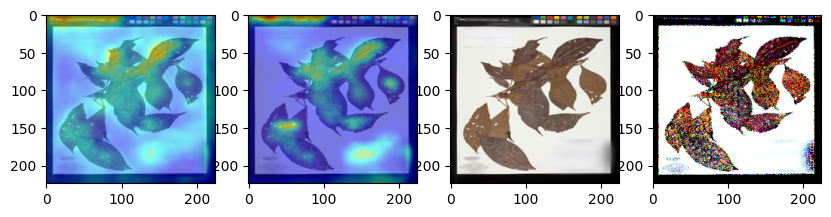

real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9875537157058716
Graffenrieda harlingii Wurdack 0.0075843604281544685
--------------------------------


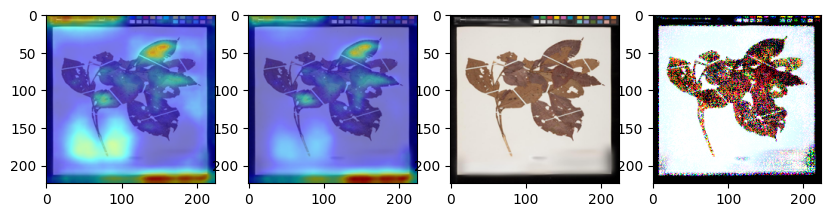

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9881225228309631
Graffenrieda harlingii Wurdack 0.011202780529856682
--------------------------------


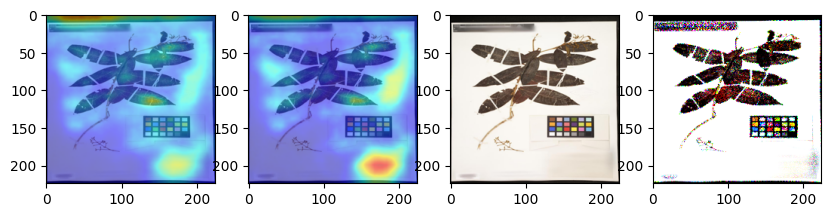

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9979968667030334
Graffenrieda harlingii Wurdack 0.0018075051484629512
--------------------------------


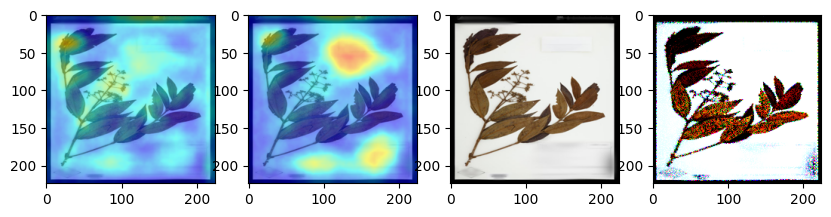

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9953951239585876
Graffenrieda harlingii Wurdack 0.004460202530026436
--------------------------------


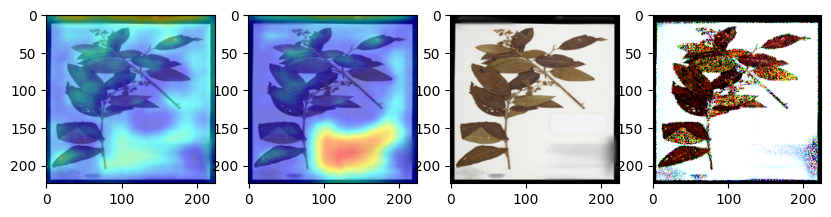

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6552035808563232
Leandra nianga (DC.) Cogn. 0.17593812942504883
--------------------------------


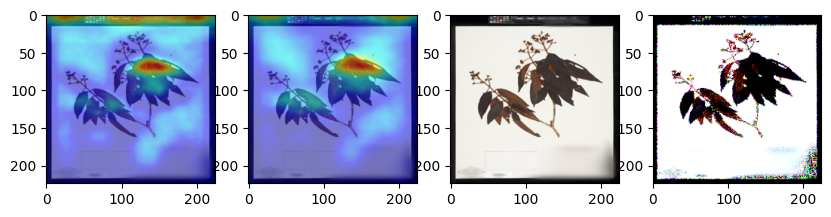

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9980595707893372
Graffenrieda harlingii Wurdack 0.0018863779259845614
--------------------------------


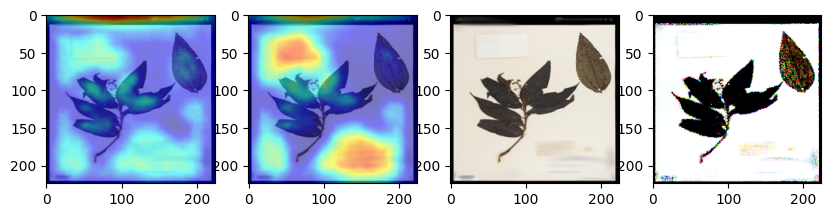

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9945429563522339
Graffenrieda harlingii Wurdack 0.004527935292571783
--------------------------------


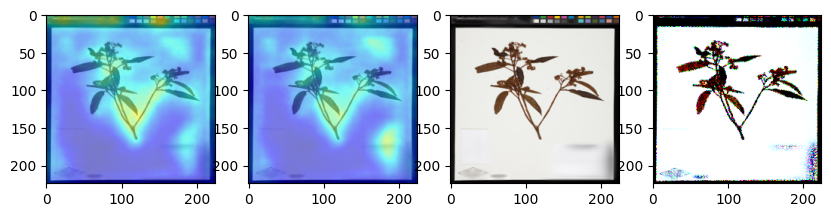

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00006.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9976767897605896
Graffenrieda harlingii Wurdack 0.002276486484333873
--------------------------------


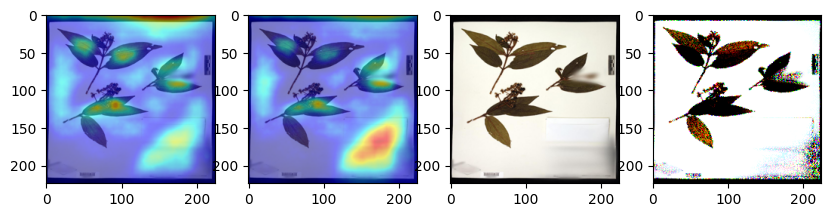

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9932061433792114
Graffenrieda harlingii Wurdack 0.006510654464364052
--------------------------------


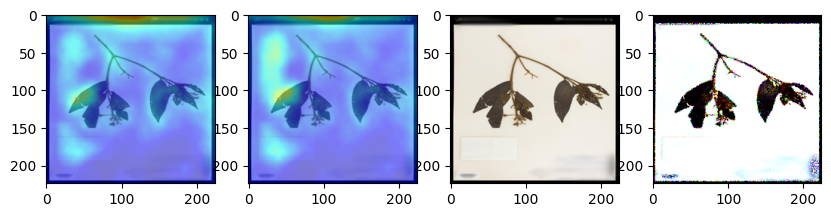

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00008.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9955524802207947
Miconia corymbiformis Cogn. 0.0027938606217503548
--------------------------------


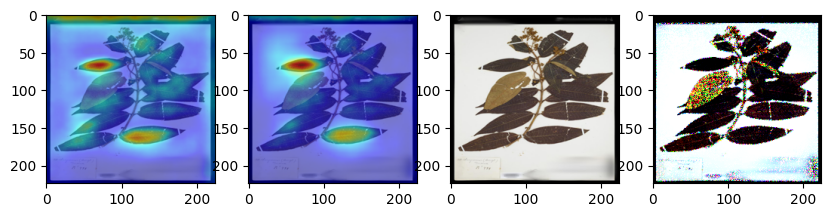

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00009.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9943200349807739
Graffenrieda harlingii Wurdack 0.00558421341702342
--------------------------------


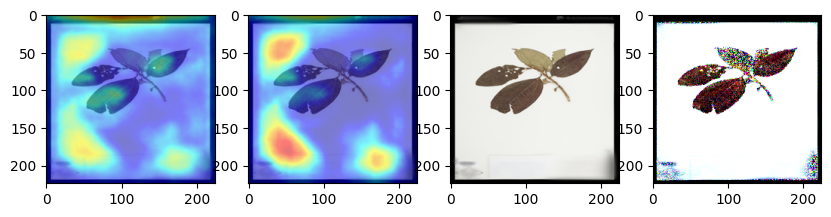

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00010.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.995898425579071
Graffenrieda harlingii Wurdack 0.003957652486860752
--------------------------------


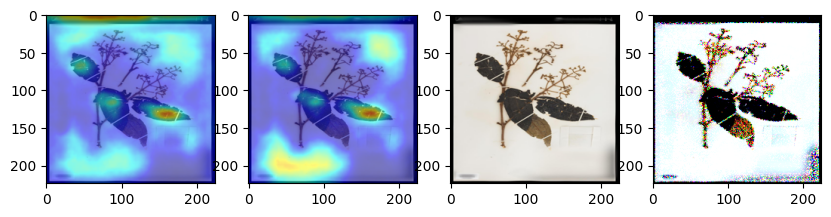

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00011.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9937773942947388
Graffenrieda harlingii Wurdack 0.0060465228743851185
--------------------------------


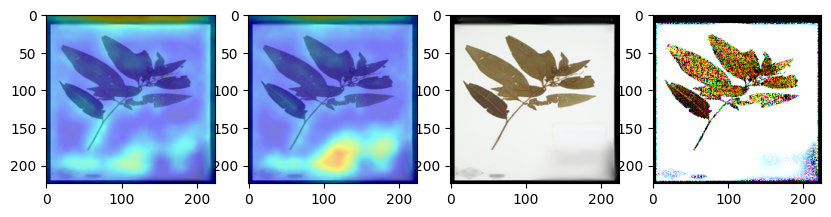

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00012.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9944463968276978
Graffenrieda harlingii Wurdack 0.004746186546981335
--------------------------------


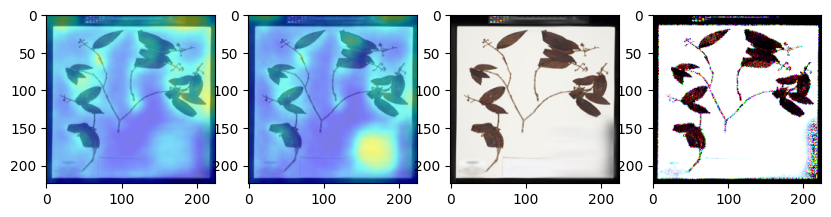

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00013.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9968992471694946
Graffenrieda harlingii Wurdack 0.0030100459698587656
--------------------------------


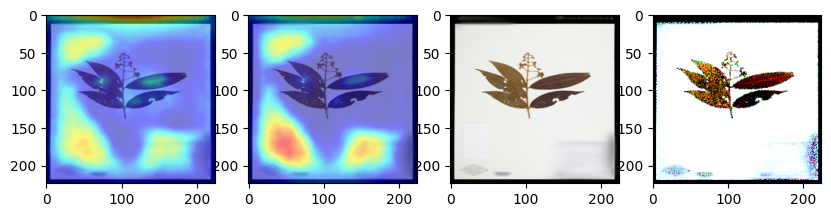

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00014.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9983931183815002
Graffenrieda harlingii Wurdack 0.0014172721421346068
--------------------------------


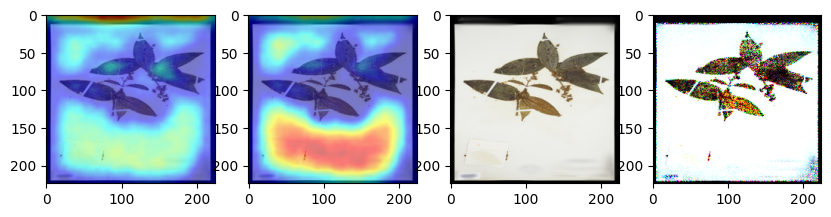

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00016.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9972931742668152
Graffenrieda harlingii Wurdack 0.0021456799004226923
--------------------------------


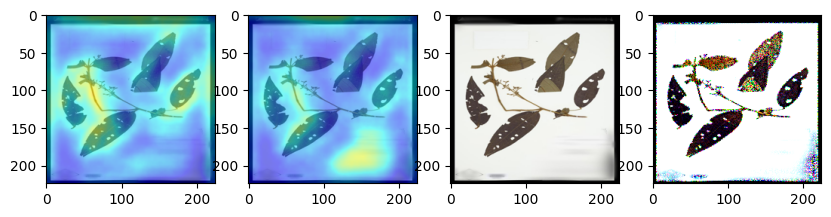

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00015.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9954692125320435
Graffenrieda harlingii Wurdack 0.004443729296326637
--------------------------------


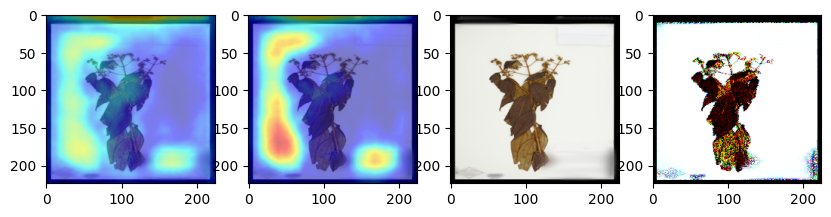

real class name:  Leandra nianga (DC.) Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9927727580070496
Miconia corymbiformis Cogn. 0.003204209730029106
--------------------------------


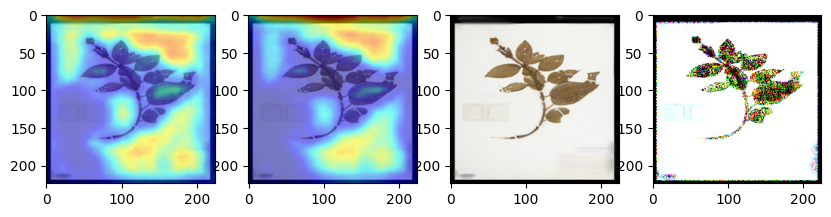

real class name:  Leandra nianga (DC.) Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9953977465629578
Graffenrieda harlingii Wurdack 0.004429921042174101
--------------------------------


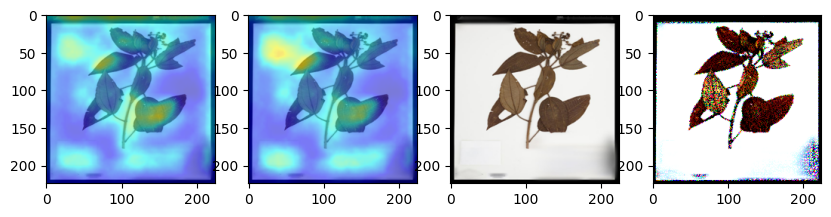

real class name:  Tibouchina semidecandra Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9973562955856323
Graffenrieda harlingii Wurdack 0.002511350903660059
--------------------------------


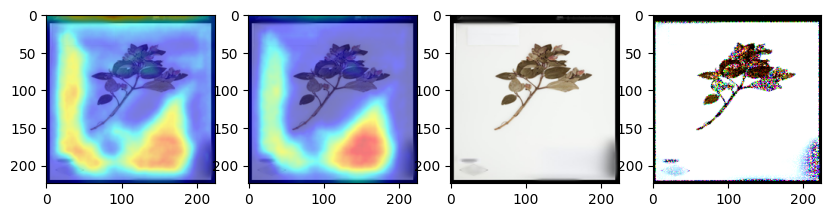

real class name:  Tibouchina semidecandra Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9939225316047668
Miconia corymbiformis Cogn. 0.0037188692949712276
--------------------------------


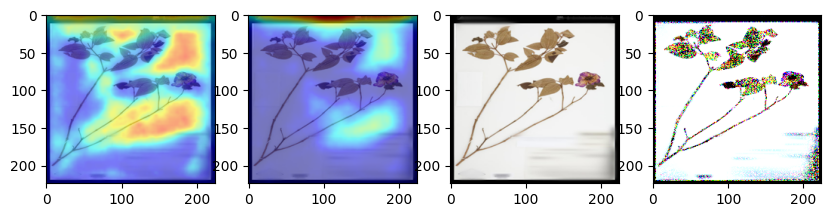

real class name:  Miconia racemosa (Aubl.) DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9955028891563416
Graffenrieda harlingii Wurdack 0.004437797702848911
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8968613743782043
Leandra nianga (DC.) Cogn. 0.059360235929489136
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9932301044464111
Graffenrieda harlingii Wurdack 0.006324038375169039
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5921681523323059
Leandra nianga (D

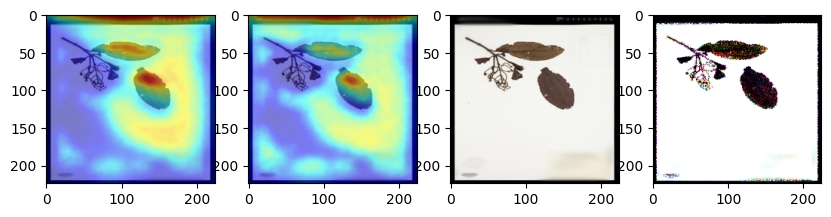

real class name:  Miconia racemosa (Aubl.) DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9953935146331787
Graffenrieda harlingii Wurdack 0.003915830515325069
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9892673492431641
Graffenrieda harlingii Wurdack 0.010216759517788887
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00006.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9985194802284241
Graffenrieda harlingii Wurdack 0.0010224301367998123
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9955675005912781
Graffenrieda harlingii W

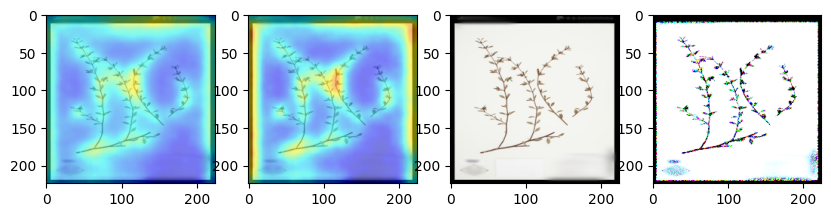

real class name:  Comolia lythrarioides Naudin
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9933197498321533
Graffenrieda harlingii Wurdack 0.006049055140465498
--------------------------------


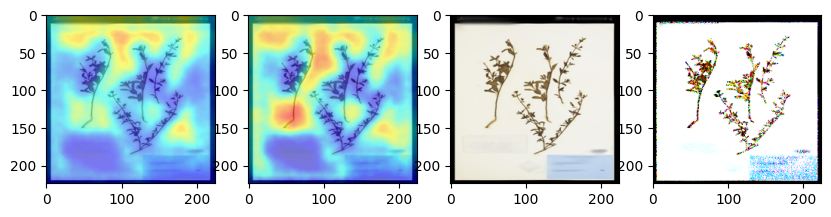

real class name:  Comolia lythrarioides Naudin
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9964679479598999
Miconia corymbiformis Cogn. 0.001607826561667025
--------------------------------


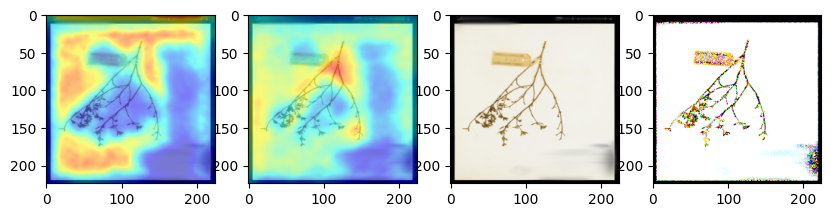

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9929105639457703
Graffenrieda harlingii Wurdack 0.006019740365445614
--------------------------------


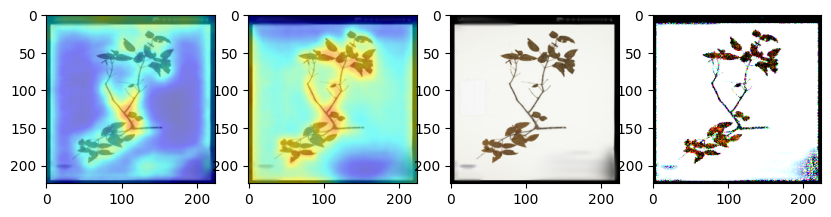

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9980223178863525
Graffenrieda harlingii Wurdack 0.0018499394645914435
--------------------------------


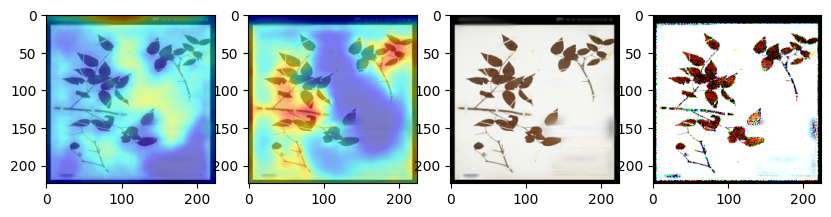

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9980844259262085
Graffenrieda harlingii Wurdack 0.001681367284618318
--------------------------------


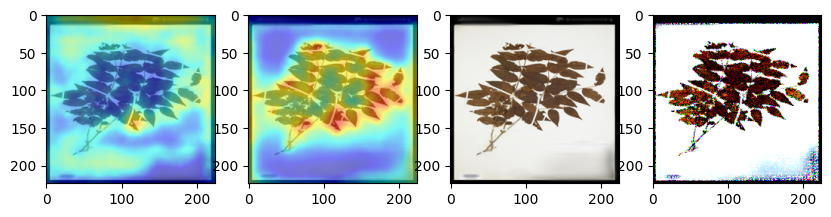

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9960572719573975
Graffenrieda harlingii Wurdack 0.003855345072224736
--------------------------------


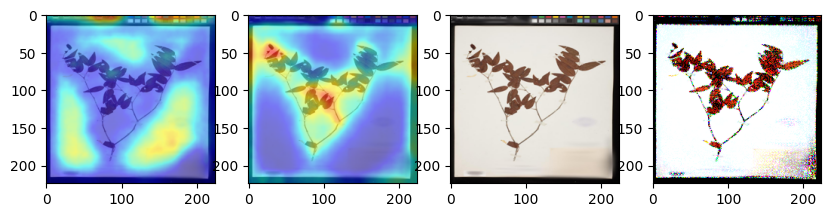

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9972610473632812
Graffenrieda harlingii Wurdack 0.0025950162671506405
--------------------------------


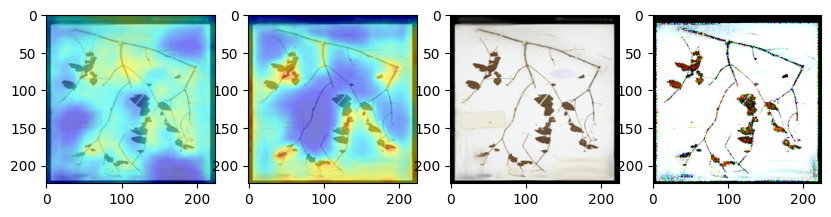

real class name:  Miconia corymbiformis Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9957817792892456
Graffenrieda harlingii Wurdack 0.003978675231337547
--------------------------------


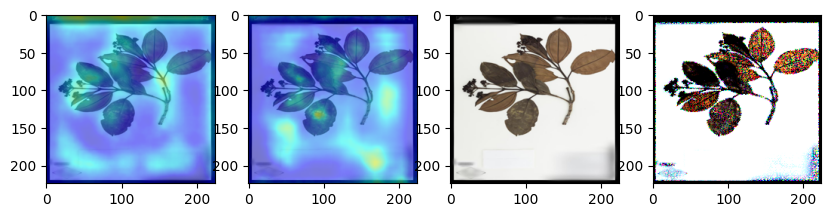

real class name:  Miconia corymbiformis Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9931331276893616
Miconia corymbiformis Cogn. 0.005488907918334007
--------------------------------


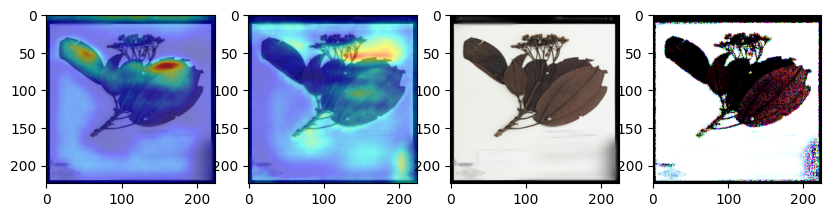

real class name:  Miconia corymbiformis Cogn.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9954566955566406
Graffenrieda harlingii Wurdack 0.003935059532523155
--------------------------------


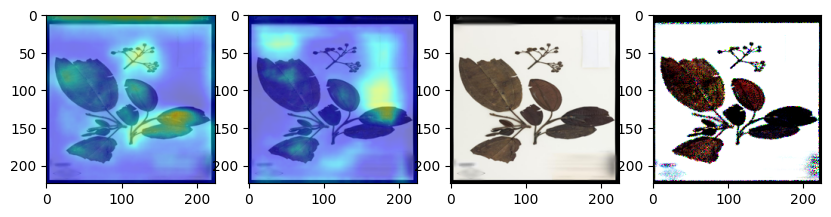

real class name:  Macairea parvifolia Benth.
image 00000.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.39301949739456177
Miconia racemosa (Aubl.) DC. 0.38249361515045166
--------------------------------


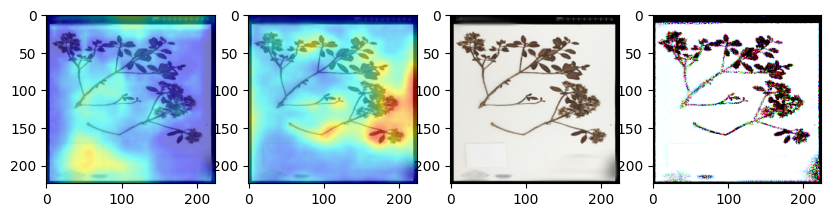

real class name:  Macairea parvifolia Benth.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.675428032875061
Leandra nianga (DC.) Cogn. 0.16034698486328125
--------------------------------


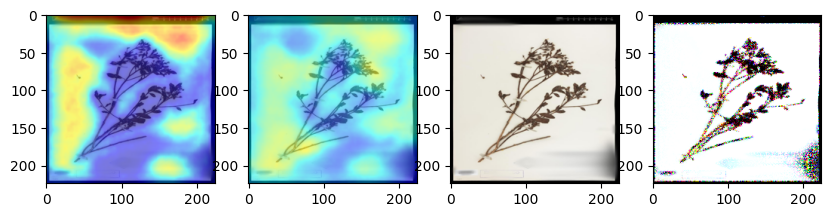

real class name:  Brachyotum strigosum (L.f.) Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8891671895980835
Leandra nianga (DC.) Cogn. 0.06848260760307312
--------------------------------


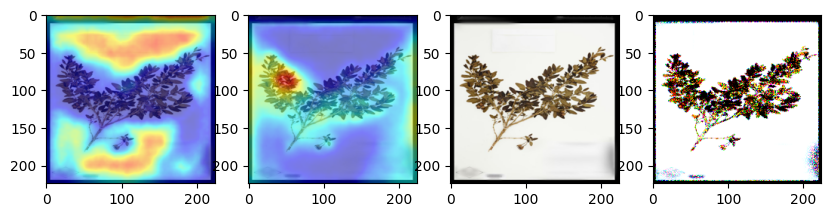

real class name:  Brachyotum strigosum (L.f.) Triana
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9966442584991455
Graffenrieda harlingii Wurdack 0.0027453312650322914
--------------------------------


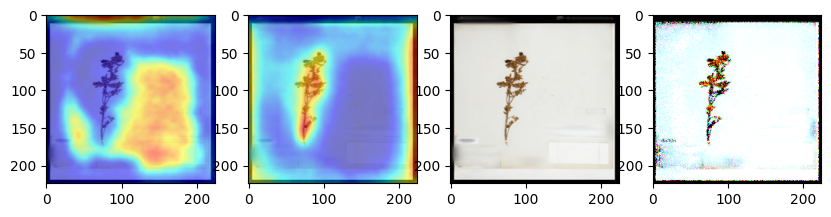

real class name:  Clidemia bullosa DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.995628833770752
Graffenrieda harlingii Wurdack 0.0043017971329391
--------------------------------


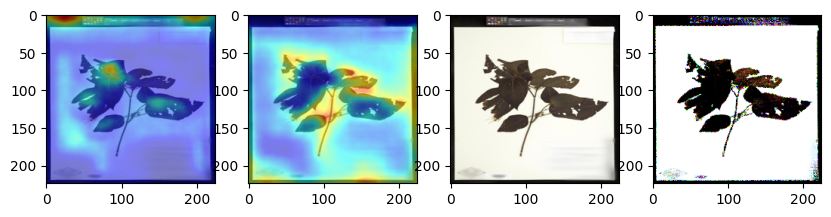

real class name:  Clidemia bullosa DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9843515157699585
Graffenrieda harlingii Wurdack 0.014376268722116947
--------------------------------


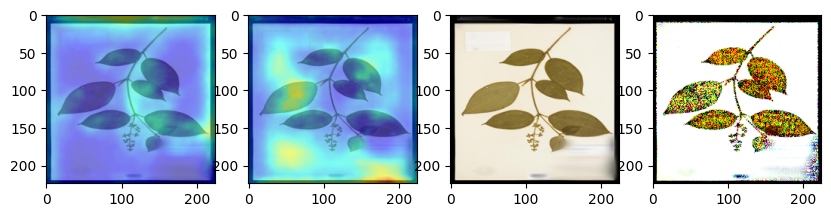

real class name:  Clidemia bullosa DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9974104762077332
Graffenrieda harlingii Wurdack 0.002178674330934882
--------------------------------


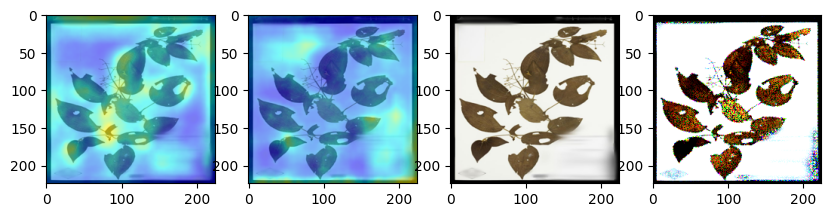

real class name:  Clidemia bullosa DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9542407989501953
Leandra nianga (DC.) Cogn. 0.025722986087203026
--------------------------------


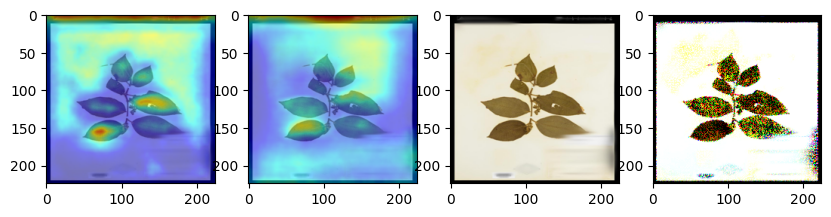

real class name:  Clidemia bullosa DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9977627992630005
Graffenrieda harlingii Wurdack 0.0017741378396749496
--------------------------------


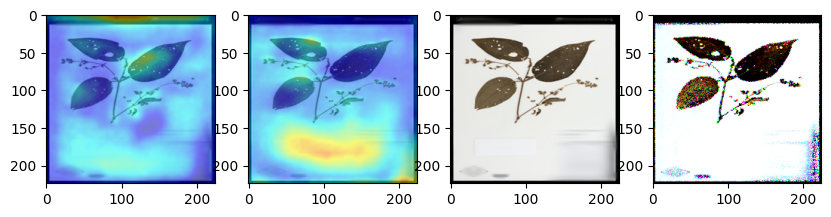

real class name:  Clidemia bullosa DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9932520985603333
Graffenrieda harlingii Wurdack 0.004061141982674599
--------------------------------


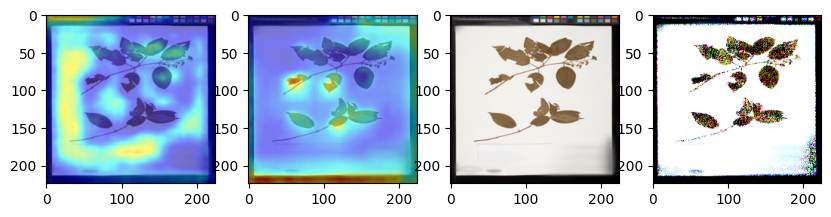

real class name:  Mouriri sagotiana Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9802785515785217
Miconia corymbiformis Cogn. 0.017134226858615875
--------------------------------


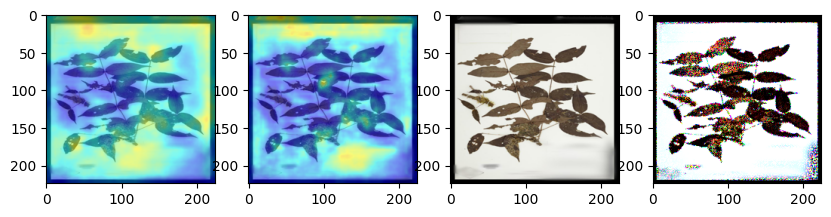

real class name:  Mouriri sagotiana Triana
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.996517539024353
Graffenrieda harlingii Wurdack 0.0018717707134783268
--------------------------------


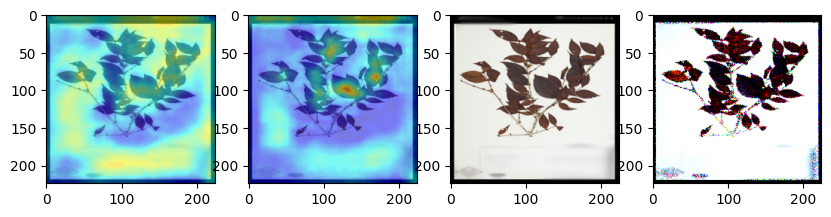

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9952577948570251
Graffenrieda harlingii Wurdack 0.004463501740247011
--------------------------------


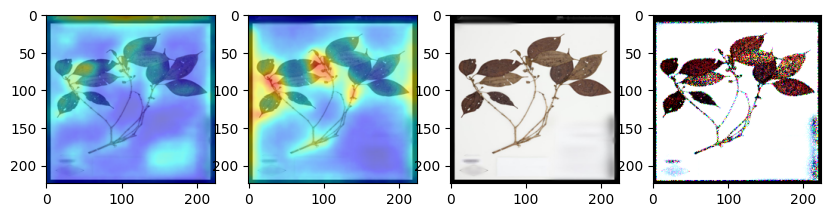

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9974971413612366
Miconia corymbiformis Cogn. 0.0012506244238466024
--------------------------------


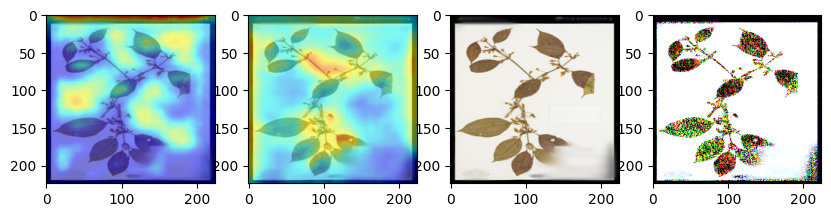

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7230273485183716
Leandra nianga (DC.) Cogn. 0.12923850119113922
--------------------------------


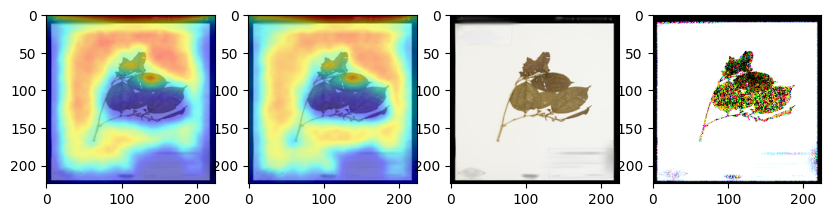

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9935483336448669
Graffenrieda harlingii Wurdack 0.0061845798045396805
--------------------------------


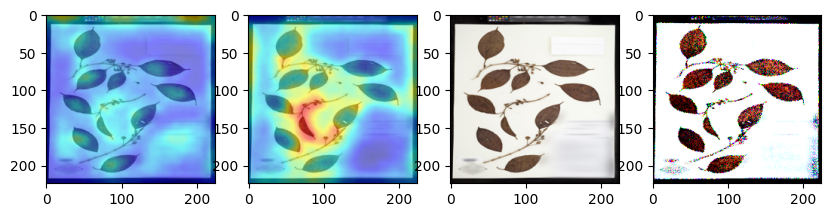

real class name:  Clidemia debilis Crueg.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9886695742607117
Graffenrieda harlingii Wurdack 0.010934778489172459
--------------------------------


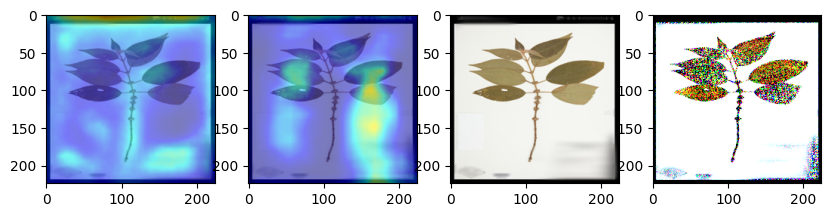

real class name:  Clidemia debilis Crueg.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9932437539100647
Miconia corymbiformis Cogn. 0.002781069837510586
--------------------------------


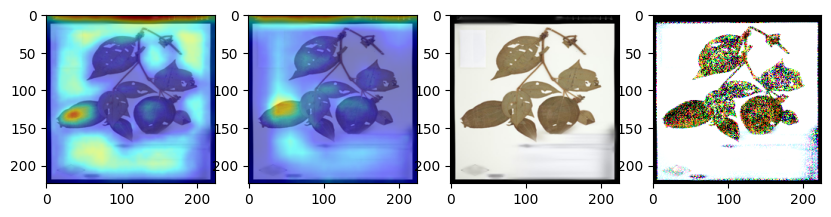

real class name:  Comolia veronicaefolia Benth.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9928267002105713
Graffenrieda harlingii Wurdack 0.004772122949361801
--------------------------------


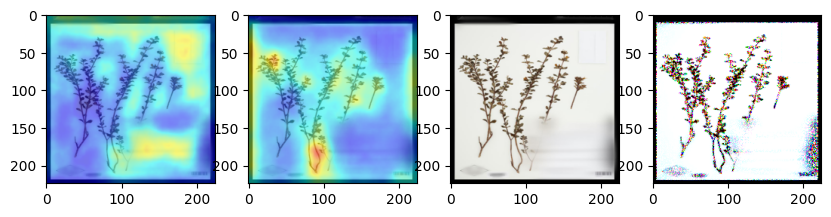

real class name:  Comolia veronicaefolia Benth.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9817517399787903
Miconia corymbiformis Cogn. 0.008870554156601429
--------------------------------


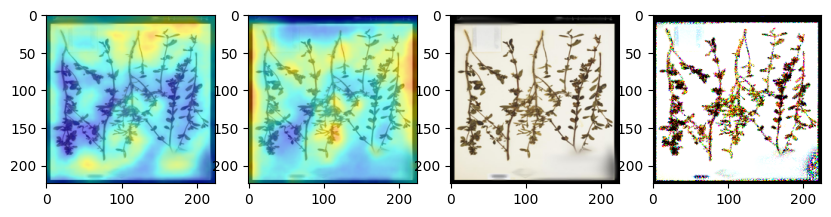

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9979506134986877
Graffenrieda harlingii Wurdack 0.0009258214849978685
--------------------------------


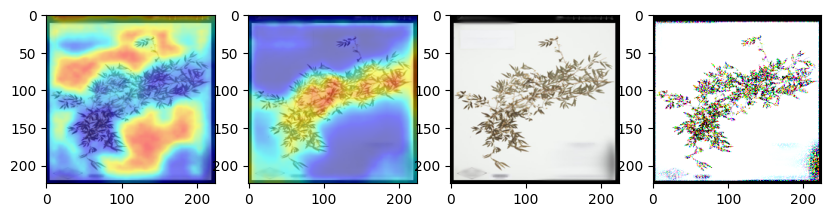

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9949913620948792
Graffenrieda harlingii Wurdack 0.004580254200845957
--------------------------------


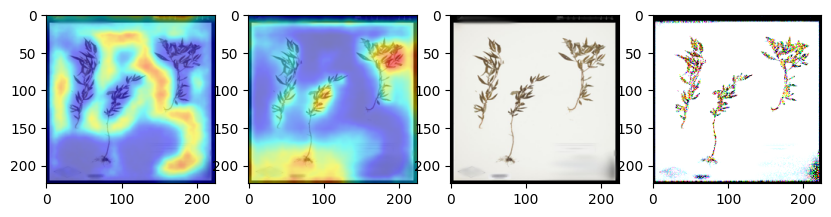

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9861060380935669
Graffenrieda harlingii Wurdack 0.01206048484891653
--------------------------------


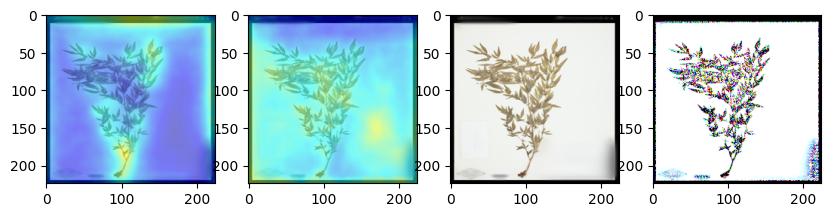

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.981228768825531
Graffenrieda harlingii Wurdack 0.017435915768146515
--------------------------------


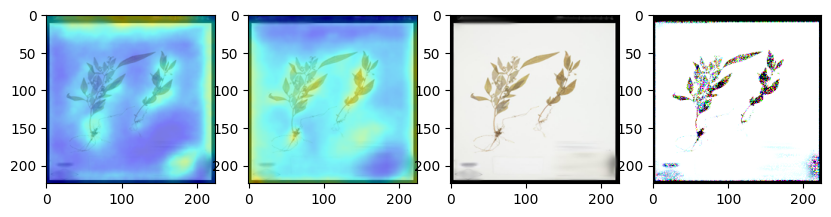

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9930168390274048
Miconia corymbiformis Cogn. 0.00369747425429523
--------------------------------


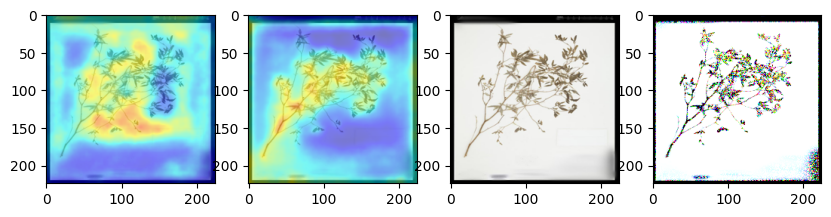

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9921616911888123
Graffenrieda harlingii Wurdack 0.007590911816805601
--------------------------------


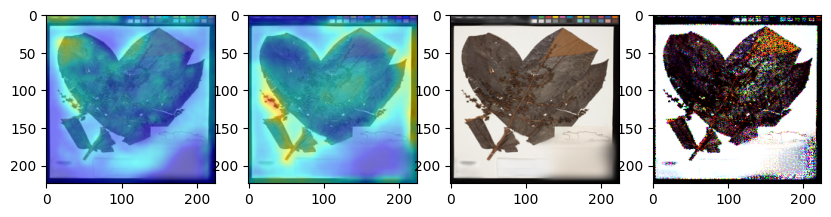

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9911226034164429
Graffenrieda harlingii Wurdack 0.008578555658459663
--------------------------------


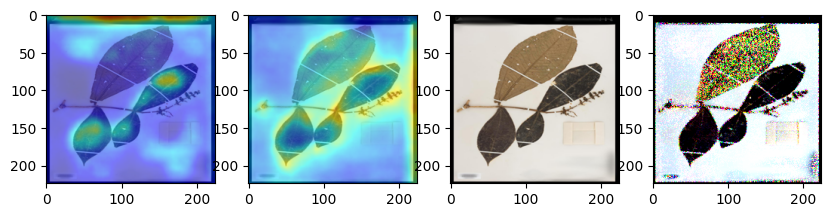

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9956931471824646
Graffenrieda harlingii Wurdack 0.0041578090749681
--------------------------------


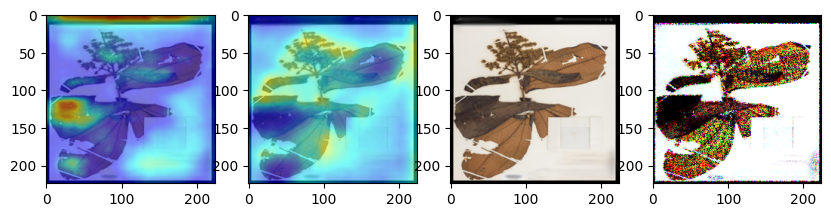

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9970394968986511
Graffenrieda harlingii Wurdack 0.00281762913800776
--------------------------------


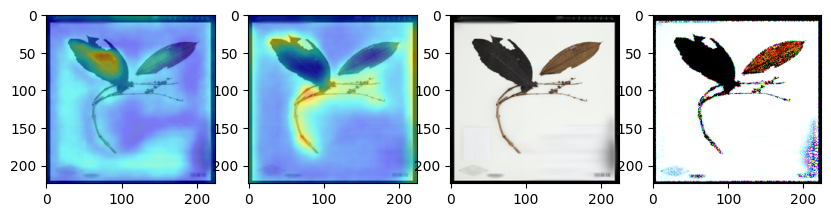

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9920587539672852
Graffenrieda harlingii Wurdack 0.007808569818735123
--------------------------------


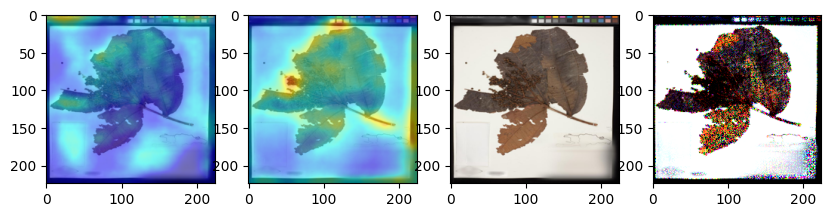

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9962210059165955
Graffenrieda harlingii Wurdack 0.0034423319157212973
--------------------------------


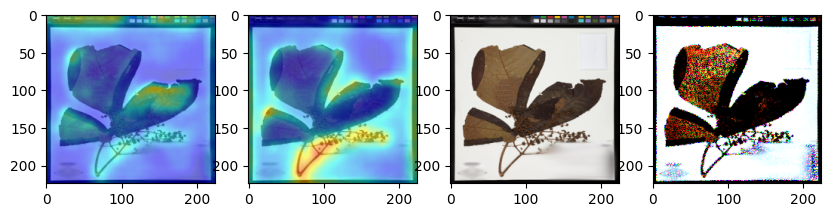

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00006.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9958857893943787
Graffenrieda harlingii Wurdack 0.003935231827199459
--------------------------------


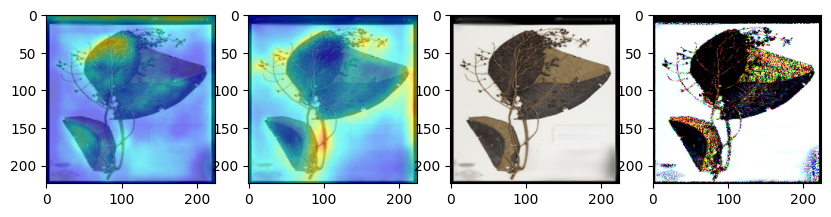

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9908458590507507
Graffenrieda harlingii Wurdack 0.008976859971880913
--------------------------------


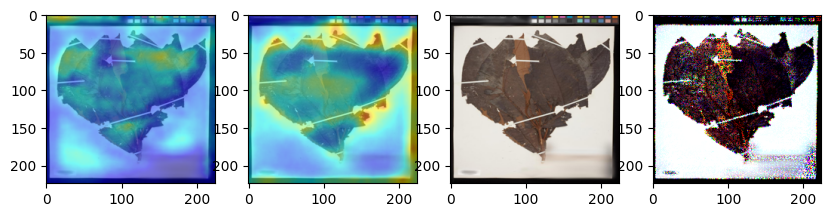

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00008.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9963122010231018
Graffenrieda harlingii Wurdack 0.0035687696654349566
--------------------------------


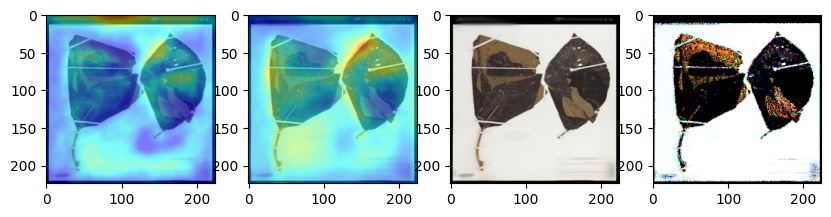

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00009.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9960927367210388
Graffenrieda harlingii Wurdack 0.003840913064777851
--------------------------------


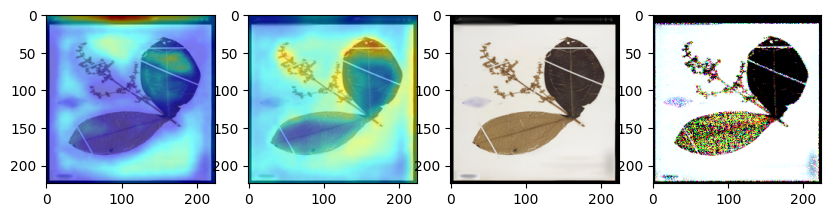

real class name:  Graffenrieda harlingii Wurdack
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9588043689727783
Miconia corymbiformis Cogn. 0.03391779214143753
--------------------------------


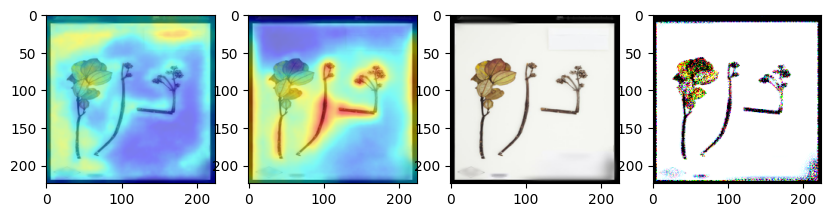

real class name:  Graffenrieda harlingii Wurdack
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6280807852745056
Miconia ibaguensis (Bonpl.) Triana 0.16637232899665833
--------------------------------


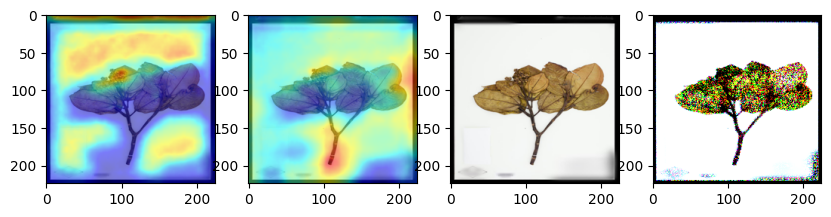

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9979464411735535
Graffenrieda harlingii Wurdack 0.001825310755521059
--------------------------------


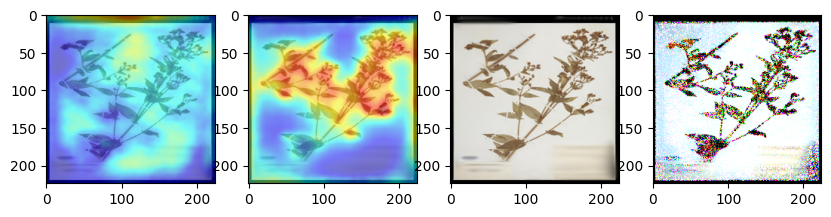

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9958601593971252
Graffenrieda harlingii Wurdack 0.00378113123588264
--------------------------------


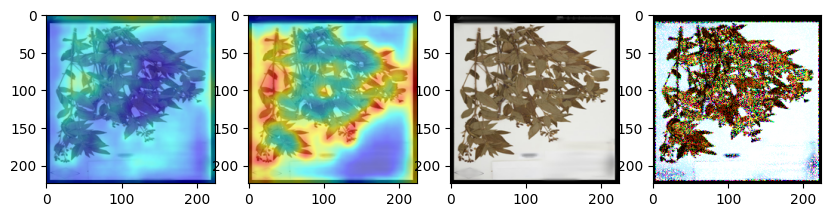

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.99125075340271
Graffenrieda harlingii Wurdack 0.008064169436693192
--------------------------------


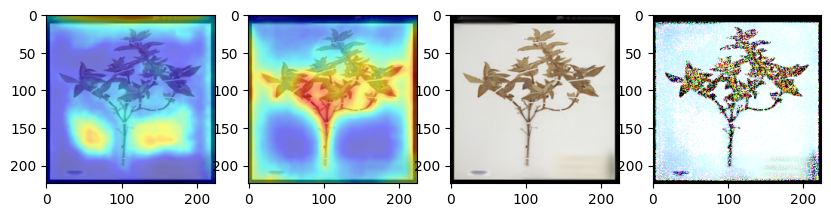

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9808287024497986
Graffenrieda harlingii Wurdack 0.00787297636270523
--------------------------------


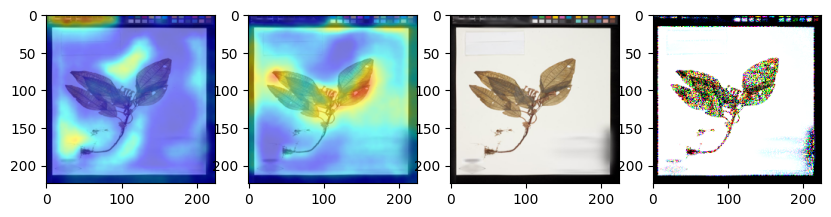

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7994198203086853
Miconia corymbiformis Cogn. 0.05857318267226219
--------------------------------


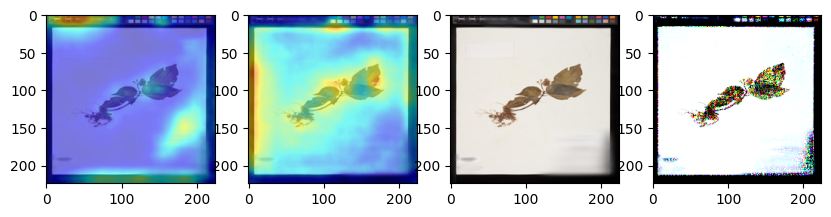

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.955584704875946
Miconia corymbiformis Cogn. 0.01620466075837612
--------------------------------


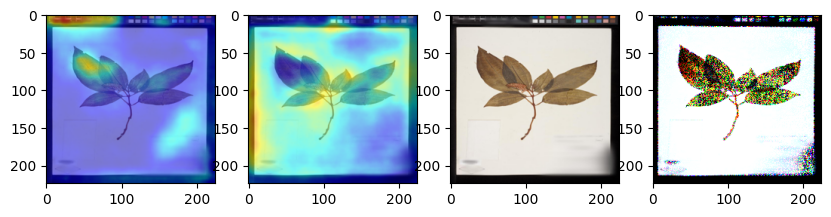

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9940283298492432
Graffenrieda harlingii Wurdack 0.005348096136003733
--------------------------------


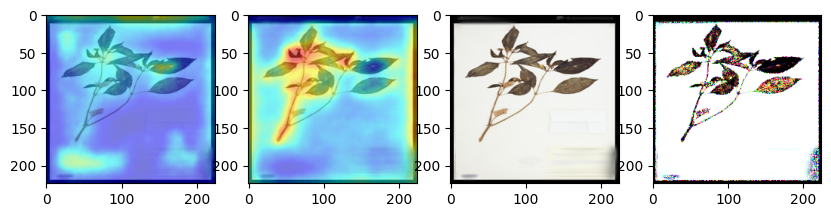

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.979694664478302
Leandra nianga (DC.) Cogn. 0.008485385216772556
--------------------------------


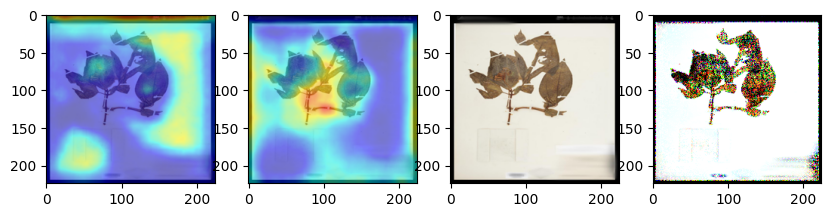

In [38]:
# ADD Noise/Boprder
#/content/drive/MyDrive/Model Data/test-images


resize_size =(224,224)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename+"/"+img_file)
    
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.CenterCrop(224),
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    #input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).numpy().astype(np.float32)

    #input_batch = input_batch[0].transpose((1,2,0))


    input_batch2 = torch.from_numpy(input_batch)
    
    input_batch3 = input_batch2.numpy()
    
    fgsm_attack = FastGradientMethod(estimator = classifier, eps=0.9) 

    x_test_adv = fgsm_attack.generate(x=input_batch3)
    x_test_adv2 = torch.from_numpy(x_test_adv)
    x_test_adv3 = x_test_adv.squeeze(0)



    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      x_test_adv2 = x_test_adv2.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(x_test_adv2)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    x , y = torch.topk(probabilities, 1) 
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(x_test_adv2, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(x_test_adv2, targets=targets1,aug_smooth=True)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])

      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)

      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
    

      # fig, ax = plt.subplots(1, 4)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      # ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')
      #ax[3].imshow(np.resize(x_test_adv2.cpu(), resize_size), cmap='gray')
      




      fig, ax = plt.subplots(1, 4, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(4):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')

      # Show the plot
      plt.show()
    


In [ ]:
# Add Noise/ No Border
#/content/drive/MyDrive/Model Data/test-images


resize_size =(224,224)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('//content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/SampleBorder/validation/'+filename+"/"+img_file)
    
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.CenterCrop(224),
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    #input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).numpy().astype(np.float32)

    #input_batch = input_batch[0].transpose((1,2,0))


    input_batch2 = torch.from_numpy(input_batch)
    
    input_batch3 = input_batch2.numpy()
    
    fgsm_attack = FastGradientMethod(estimator = classifier, eps=0.9) 

    x_test_adv = fgsm_attack.generate(x=input_batch3)
    x_test_adv2 = torch.from_numpy(x_test_adv)
    x_test_adv3 = x_test_adv.squeeze(0)



    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      x_test_adv2 = x_test_adv2.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(x_test_adv2)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    x , y = torch.topk(probabilities, 1) 
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(x_test_adv2, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(x_test_adv2, targets=targets1,aug_smooth=True)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])

      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)

      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
    

      # fig, ax = plt.subplots(1, 4)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      # ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')
      #ax[3].imshow(np.resize(x_test_adv2.cpu(), resize_size), cmap='gray')
      




      fig, ax = plt.subplots(1, 4, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(4):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')

      # Show the plot
      plt.show()
    


## final GradCAM Analysis:

Using Grad-CAM (Gradient-weighted Class Activation Mapping) is a great way to visualize which regions of an input image were most important for a model's classification decision. By plotting the heatmap generated by the Grad-CAM method on top of the input image, you can see which parts of the image the model paid attention to when making its prediction.

When you are reviewing the test images and their corresponding heatmaps, you can check the score calculated by the model for each class, and try to understand how the model arrived at its decision by looking at the regions of the image highlighted by the heatmap. For example, if the model predicted that a given image is of a dog, and the heatmap shows that the model paid attention to the ears and nose of the animal, it's likely that the model has learned to recognize those features as indicative of a dog.

In addition, by using the Gerdcam method, the heatmap will be specific to the class that the image was predicted to be, so it will be more interpretable in terms of understanding the image feature that the model used to classify that specific class.

It's important to note that the heatmap generated by Grad-CAM is an approximate representation of the model's attention and it's not intended to be a definitive explanation of the model's decision-making process. But it can be used as a tool to gain insights into a model's behavior, and to identify areas for improvement in the training data or model architecture.



